In [6]:
import torch

print(torch.__version__)
print(torch.cuda.is_available())
print(torch.cuda.get_device_name(torch.cuda.current_device()))

2.4.0+cu118
True
NVIDIA GeForce RTX 3050 Ti Laptop GPU


In [7]:
import torch

print(torch.__version__)

print(torch.__file__)

inputs = torch.randn(10, 3, 224, 224).to('cuda')  #* Example tensor
print(inputs.device) 

if torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
print("using", device, "device") 

print(torch.cuda.current_device())
print(torch.cuda.get_device_name(torch.cuda.current_device()))
print(torch.cuda.is_available())

DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

from PIL import Image

import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from __future__ import division, print_function
import sys
from sklearn.preprocessing import MinMaxScaler

2.4.0+cu118
c:\Users\DELL\AppData\Local\Programs\Python\Python312\Lib\site-packages\torch\__init__.py
cuda:0
using cuda device
0
NVIDIA GeForce RTX 3050 Ti Laptop GPU
True


In [8]:
class FCN(nn.Module):
    "Defines a connected network"
    
    def __init__(self, N_INPUT, N_OUTPUT, N_HIDDEN, N_LAYERS):
        super().__init__()
        activation = nn.Tanh
        self.fcs = nn.Sequential(*[
                        nn.Linear(N_INPUT, N_HIDDEN),
                        activation()])
        self.fch = nn.Sequential(*[
                        nn.Sequential(*[
                            nn.Linear(N_HIDDEN, N_HIDDEN),
                            activation()]) for _ in range(N_LAYERS-1)])
        self.fce = nn.Linear(N_HIDDEN, N_OUTPUT)
        
    def forward(self, x):
        x = self.fcs(x)
        x = self.fch(x)
        x = self.fce(x)
        return x
    

In [9]:
class FCND(nn.Module):
    "Defines a connected network"
    
    def __init__(self, N_INPUT, N_OUTPUT, N_HIDDEN, N_LAYERS):
        super().__init__()
        activation = nn.Tanh
        self.fcs = nn.Sequential(*[
                        nn.Linear(N_INPUT, N_HIDDEN),
                        activation()])
        self.fch = nn.Sequential(*[
                        nn.Sequential(*[
                            nn.Linear(N_HIDDEN, N_HIDDEN),
                            activation()]) for _ in range(N_LAYERS-1)])
        self.fce = nn.Linear(N_HIDDEN, N_OUTPUT)

        self.gamma = nn.Parameter(data=torch.tensor([0.]))
        self.beta = nn.Parameter(data=torch.tensor([0.]))
        
    def forward(self, x):
        x = self.fcs(x)
        x = self.fch(x)
        x = self.fce(x)
        return x

In [11]:
def plot_result(i,x,y,x_data,y_data,yh,xp=None):
    "Pretty plot training results"
    plt.figure(figsize=(15,7))
    
    plt.plot(x,yh[:, 0], color="tab:red", linewidth=2, alpha=0.8, label="NN S")
    plt.plot(x,yh[:, 1], color="tab:green", linewidth=2, alpha=0.8, label="NN I")
    plt.plot(x,yh[:, 2], color="tab:blue", linewidth=2, alpha=0.8, label="NN R")
    plt.plot(x,y[:, 0], color="red", linewidth=2, alpha=0.8,linestyle='--',label="Exact S")
    plt.plot(x,y[:, 1], color="green", linewidth=2, alpha=0.8,linestyle='--',label="Exact I")
    plt.plot(x,y[:, 2], color="blue", linewidth=2, alpha=0.8,linestyle='--',label="Exact R")
    plt.scatter(x_data, y_data[:, 0], s=60, color="tab:red", alpha=0.4, label='Training S')
    plt.scatter(x_data, y_data[:, 1], s=60, color="tab:green", alpha=0.4, label='Training I')
    plt.scatter(x_data, y_data[:, 2], s=60, color="tab:blue", alpha=0.4, label='Training R')
    if xp is not None:
        plt.scatter(xp, -0*torch.ones_like(xp), s=30, color="tab:green", alpha=0.4, 
                    label='Colloc. points')
    """l = plt.legend(loc=(0.701,0.14), frameon=False, fontsize="large")
    plt.setp(l.get_texts(), color="k")
    plt.text(1.665,1.3,"Step: %i"%(i+1),fontsize="xx-large",color="k")"""
    plt.title('SIR model, step %i'%(i+1),fontsize="xx-large")
    plt.ylabel('SIR',fontsize="xx-large")
    plt.xlabel('Time',fontsize="xx-large")
    plt.legend()
    plt.axis("on")
    plt.show()


In [12]:
def plot_result_al(i, x, y, x_data, y_data, yh, xp=None):
    fig = plt.figure(figsize=(15, 10))

    # Subplot para Infectados (I)
    ax1 = fig.add_subplot(212)
    ax1.plot(x, yh[:, 1], color="tab:green", linewidth=2, alpha=0.8, label="NN I")
    ax1.plot(x, y[:, 1], color="green", linewidth=2, alpha=0.8, linestyle='--', label="Exacto I")
    ax1.scatter(x_data, y_data[:, 1], s=60, color="tab:green", alpha=0.4, label='Entrenamiento I')
    ax1.set_xlabel("Tiempo")
    ax1.set_ylabel("Infectados")
    ax1.legend()
    ax1.set_title(f'Modelo SIR, paso {i + 1}', fontsize="xx-large")

    # Subplot para Susceptibles (S)
    ax2 = fig.add_subplot(222)
    ax2.plot(x, yh[:, 0], color="tab:red", linewidth=2, alpha=0.8, label="NN S")
    ax2.plot(x, y[:, 0], color="red", linewidth=2, alpha=0.8, linestyle='--', label="Exacto S")
    ax2.scatter(x_data, y_data[:, 0], s=60, color="tab:red", alpha=0.4, label='Entrenamiento S')
    ax2.set_xlabel("Tiempo")
    ax2.set_ylabel("Susceptibles")
    ax2.legend()
    ax2.set_title(f'Modelo SIR, paso {i + 1}', fontsize="xx-large")

    # Subplot para Removidos (R)
    ax3 = fig.add_subplot(221)
    ax3.plot(x, yh[:, 2], color="tab:blue", linewidth=2, alpha=0.8, label="NN R")
    ax3.plot(x, y[:, 2], color="blue", linewidth=2, alpha=0.8, linestyle='--', label="Exacto R")
    ax3.scatter(x_data, y_data[:, 2], s=60, color="tab:blue", alpha=0.4, label='Entrenamiento R')
    ax3.set_xlabel("Tiempo")
    ax3.set_ylabel("Removidos")
    ax3.legend()
    ax3.set_title(f'Modelo SIR, paso {i + 1}', fontsize="xx-large")

    plt.tight_layout()
    plt.show()

# Simulacion por Rk4 modelo SAIRD

torch.Size([200, 1]) torch.Size([200, 3])
torch.Size([10, 1]) torch.Size([10, 3])


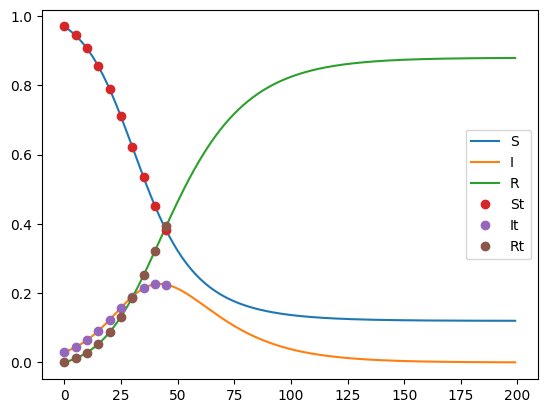

In [7]:
sim = pd.read_csv('./sim_SIR.csv')
N_old = sim['S'][0] + sim['I'][0] + sim['R'][0]
sim['S'] = sim['S'] / N_old
sim['I'] = sim['I'] / N_old
sim['R'] = sim['R'] / N_old

sim_t = torch.tensor(sim[['t']].values, dtype=torch.float32)
sim_data = torch.tensor(sim[['S', 'I', 'R']].values, dtype=torch.float32)

print(sim_t.shape, sim_data.shape)

sim_t_train = sim_t[:50:5]
sim_data_train = sim_data[:50:5]

print(sim_t_train.shape, sim_data_train.shape)

fig = plt.figure()
plt.plot(sim_t, sim_data, label=['S', 'I', 'R'])
plt.plot(sim_t_train, sim_data_train, 'o', label=['St', 'It', 'Rt'])
plt.legend();

### PINN con busqueda de parametros

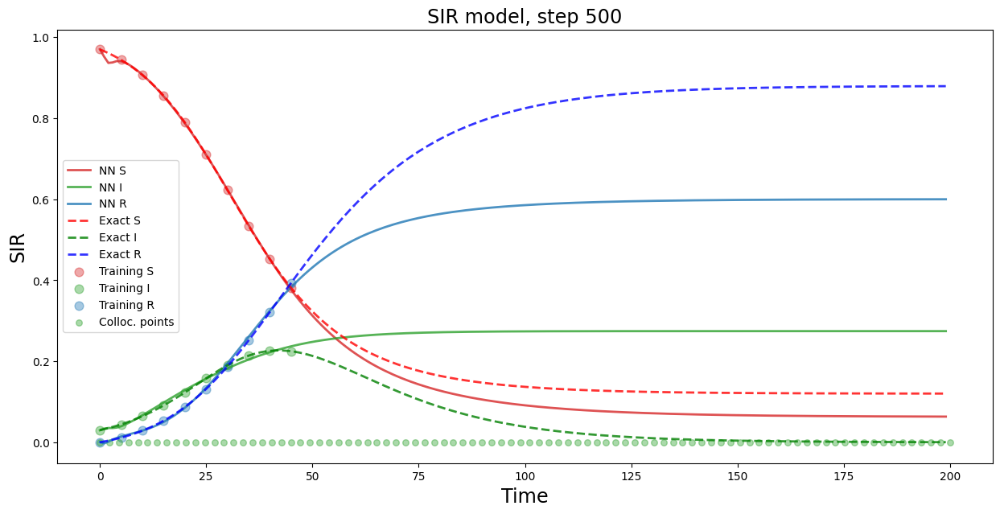

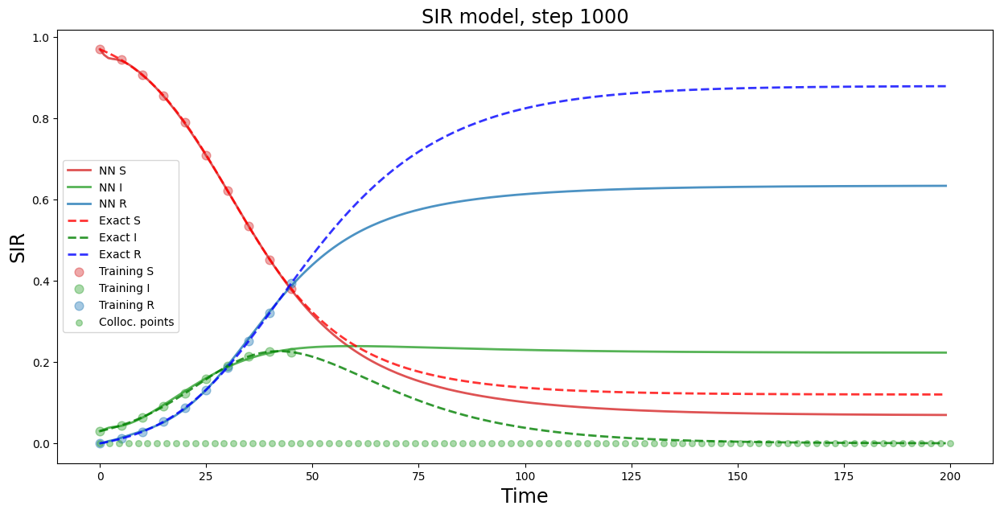

step = 1000 , loss1 = 9.675603e-06 , loss2 = 2.9803257e-05 , loss = 3.947886e-05 , mse = 0.020844791 , beta = 0.106233805 , gamma = 0.014588606


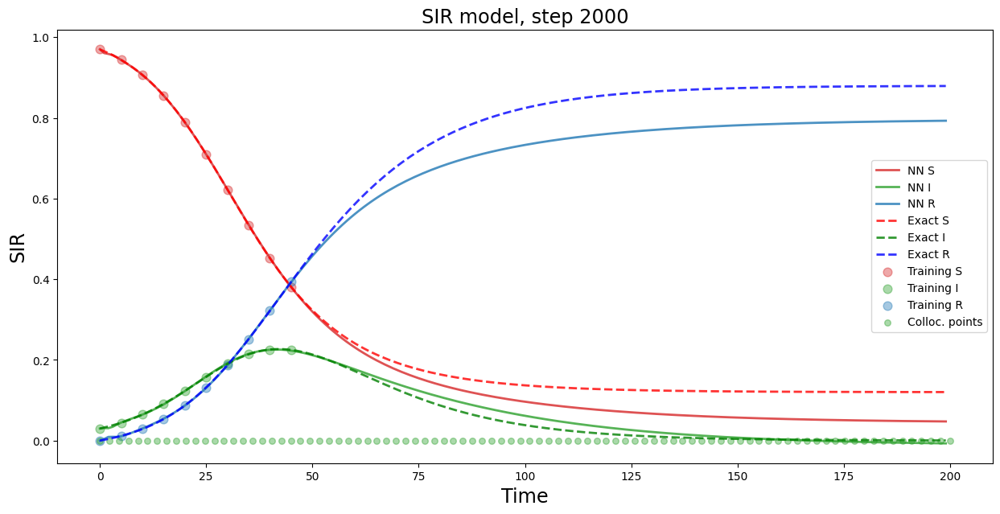

step = 2000 , loss1 = 6.589304e-07 , loss2 = 2.2254098e-06 , loss = 2.8843401e-06 , mse = 0.002457074 , beta = 0.1461681 , gamma = 0.056202162


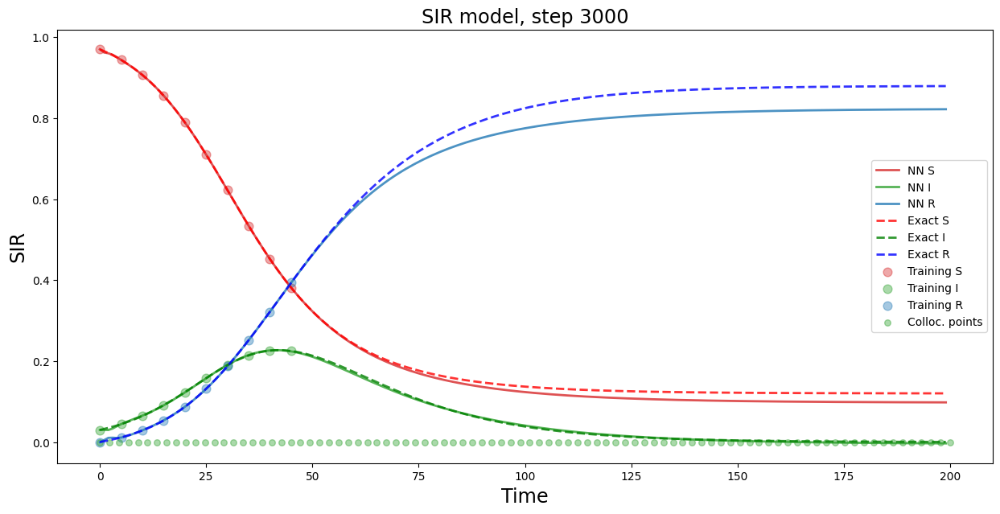

step = 3000 , loss1 = 1.578433e-07 , loss2 = 4.3347177e-07 , loss = 5.913151e-07 , mse = 0.0006825489 , beta = 0.14979476 , gamma = 0.062145043


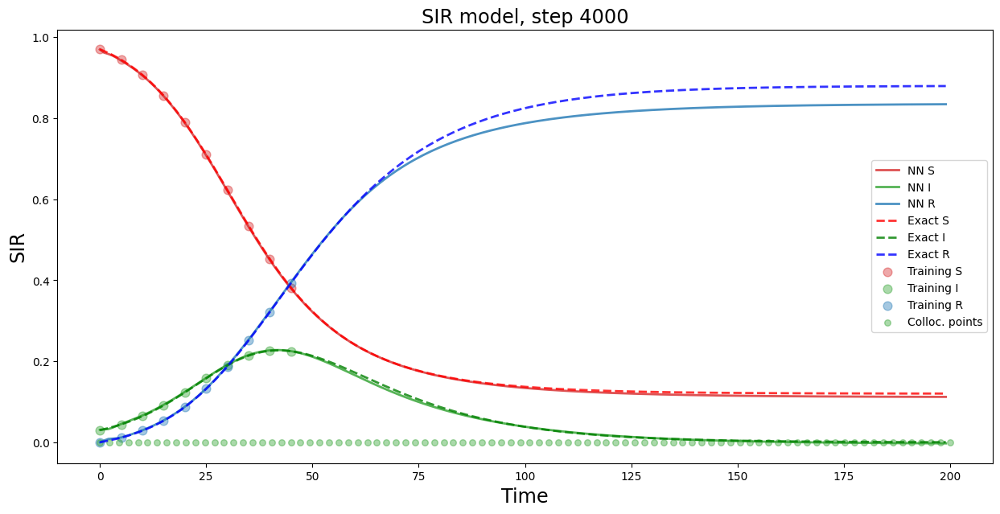

step = 4000 , loss1 = 2.99536e-06 , loss2 = 2.0748809e-07 , loss = 3.2028481e-06 , mse = 0.000373547 , beta = 0.14987853 , gamma = 0.06309578
step = 5000 , loss1 = 1.4726899e-07 , loss2 = 2.1994836e-07 , loss = 3.6721735e-07 , mse = 0.00073455094 , beta = 0.15044363 , gamma = 0.06418325
step = 6000 , loss1 = 0.00013885033 , loss2 = 3.1691616e-07 , loss = 0.00013916724 , mse = 0.0007401501 , beta = 0.1503097 , gamma = 0.06424332


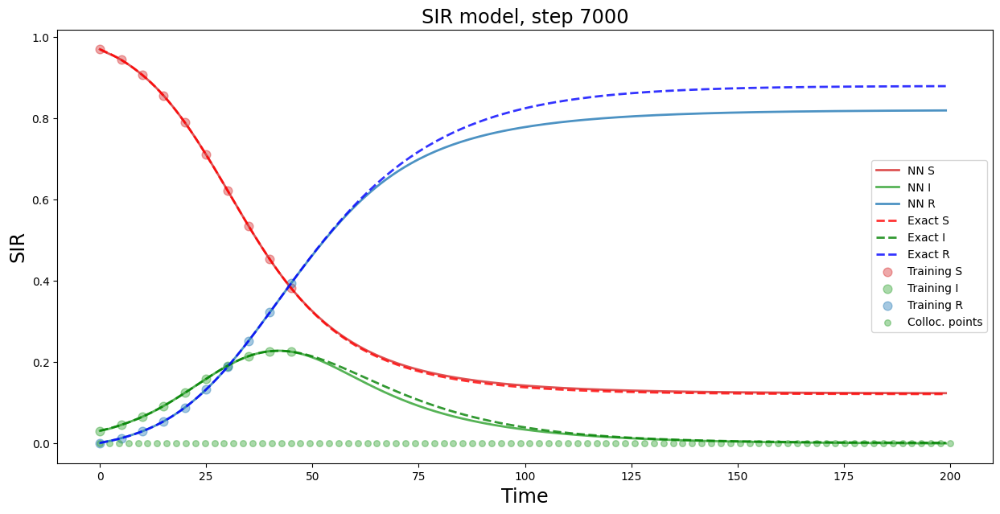

step = 7000 , loss1 = 3.0889144e-08 , loss2 = 1.5847075e-07 , loss = 1.893599e-07 , mse = 0.0006252987 , beta = 0.1502167 , gamma = 0.06421585
step = 8000 , loss1 = 2.850411e-08 , loss2 = 1.8034783e-07 , loss = 2.0885193e-07 , mse = 0.0007710419 , beta = 0.15013409 , gamma = 0.064201646
step = 9000 , loss1 = 2.3182686e-06 , loss2 = 1.8062794e-07 , loss = 2.4988965e-06 , mse = 0.0007806108 , beta = 0.15018634 , gamma = 0.06425314
step = 10000 , loss1 = 2.9946411e-06 , loss2 = 1.6426625e-07 , loss = 3.1589075e-06 , mse = 0.0006989791 , beta = 0.15035658 , gamma = 0.06404104
step = 11000 , loss1 = 2.6816406e-06 , loss2 = 1.3866577e-07 , loss = 2.8203062e-06 , mse = 0.00043854982 , beta = 0.15011868 , gamma = 0.06385401
step = 12000 , loss1 = 0.001922521 , loss2 = 1.531885e-05 , loss = 0.0019378399 , mse = 0.0069823046 , beta = 0.11172647 , gamma = 0.034577303
step = 13000 , loss1 = 1.7671306e-08 , loss2 = 7.449155e-08 , loss = 9.216286e-08 , mse = 0.00017050489 , beta = 0.15027997 , gamma

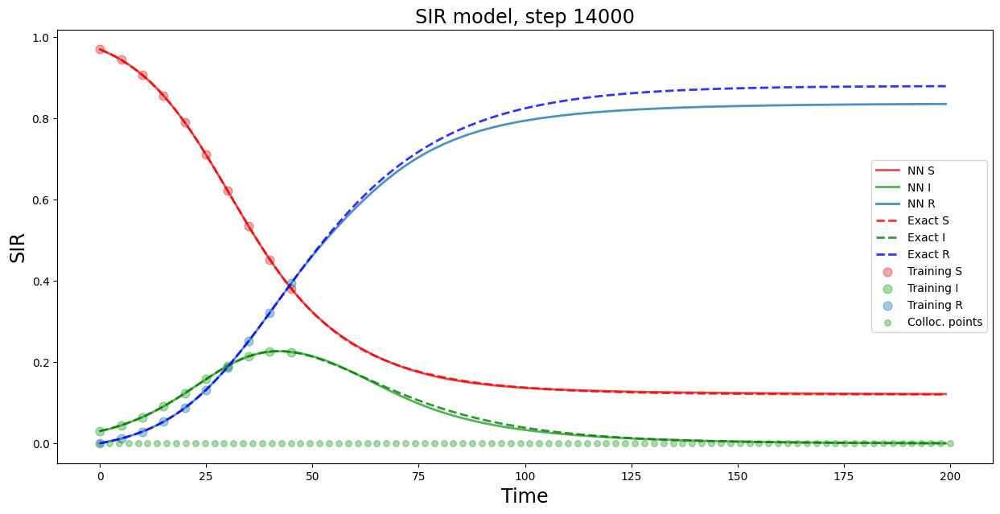

step = 14000 , loss1 = 1.093459e-08 , loss2 = 1.1861859e-07 , loss = 1.2955317e-07 , mse = 0.00031972266 , beta = 0.14997073 , gamma = 0.06313392
step = 15000 , loss1 = 8.128221e-09 , loss2 = 9.890566e-08 , loss = 1.0703388e-07 , mse = 0.00038214395 , beta = 0.15007687 , gamma = 0.06338528
step = 16000 , loss1 = 1.7046904e-06 , loss2 = 1.2226455e-07 , loss = 1.8269549e-06 , mse = 0.00039636443 , beta = 0.15019451 , gamma = 0.0633171
step = 17000 , loss1 = 2.363382e-06 , loss2 = 1.2690708e-07 , loss = 2.490289e-06 , mse = 0.000358909 , beta = 0.14903973 , gamma = 0.06368436
step = 18000 , loss1 = 2.796351e-06 , loss2 = 9.489649e-08 , loss = 2.8912475e-06 , mse = 0.00033061003 , beta = 0.14984559 , gamma = 0.0634806
step = 19000 , loss1 = 3.2701334e-06 , loss2 = 8.5738385e-08 , loss = 3.3558717e-06 , mse = 0.00030373124 , beta = 0.15093042 , gamma = 0.06366246
step = 20000 , loss1 = 2.3374133e-07 , loss2 = 8.531397e-07 , loss = 1.086881e-06 , mse = 0.0036048803 , beta = 0.14843912 , gamm

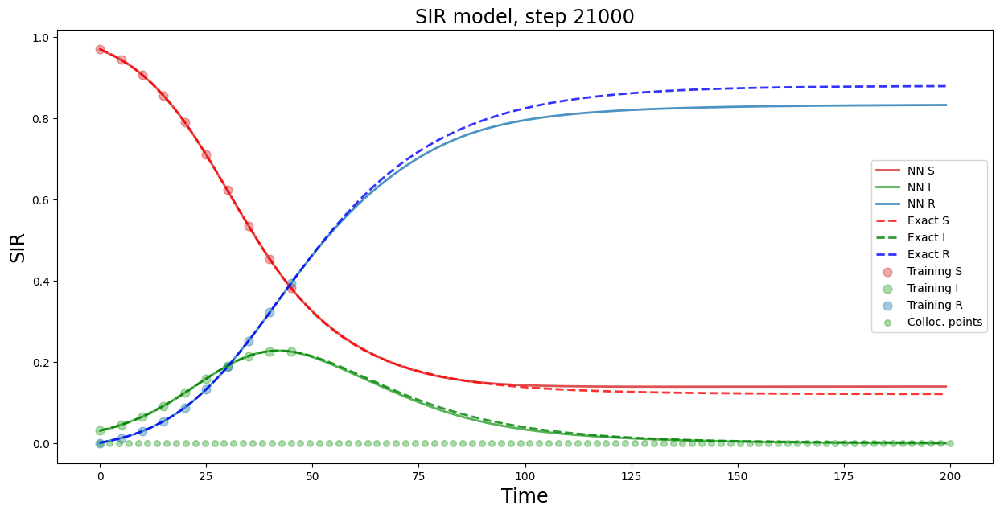

step = 21000 , loss1 = 1.7510503e-08 , loss2 = 8.679583e-08 , loss = 1.0430633e-07 , mse = 0.00037864642 , beta = 0.1499995 , gamma = 0.063383095
step = 22000 , loss1 = 6.5750976e-07 , loss2 = 4.653785e-08 , loss = 7.040476e-07 , mse = 0.00012234887 , beta = 0.15034783 , gamma = 0.06341298
step = 23000 , loss1 = 3.1727883e-08 , loss2 = 5.4450226e-08 , loss = 8.6178105e-08 , mse = 0.00017429724 , beta = 0.15040825 , gamma = 0.06333915
step = 24000 , loss1 = 3.2425376e-06 , loss2 = 8.8477684e-08 , loss = 3.3310153e-06 , mse = 0.00013878001 , beta = 0.14968354 , gamma = 0.06321752
step = 25000 , loss1 = 1.6722686e-05 , loss2 = 8.074814e-08 , loss = 1.6803435e-05 , mse = 6.944081e-05 , beta = 0.14929555 , gamma = 0.0629822
step = 26000 , loss1 = 1.7892249e-07 , loss2 = 6.7012294e-08 , loss = 2.4593479e-07 , mse = 0.00017340457 , beta = 0.15016049 , gamma = 0.06311874
step = 27000 , loss1 = 2.8683004e-05 , loss2 = 5.6276855e-07 , loss = 2.9245772e-05 , mse = 0.00017940164 , beta = 0.1478525

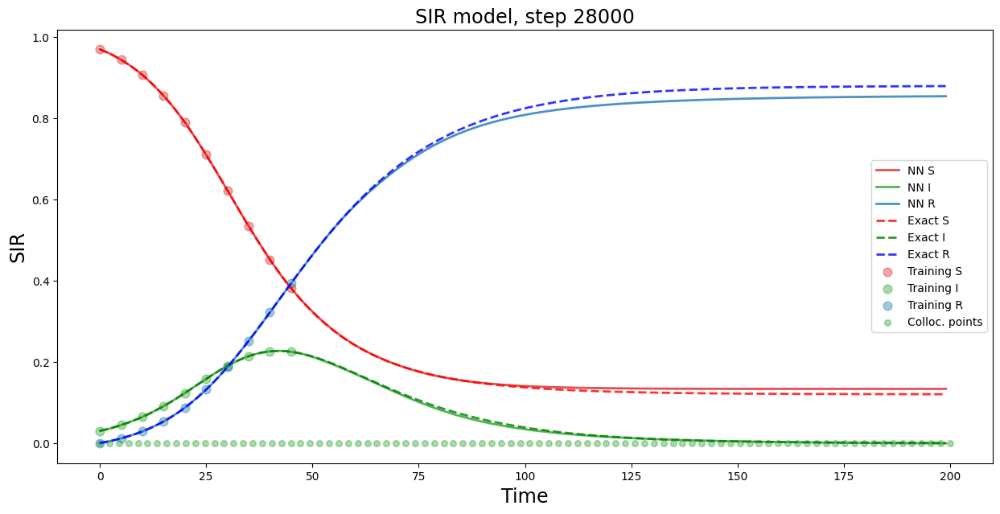

step = 28000 , loss1 = 8.0283815e-09 , loss2 = 4.8305186e-08 , loss = 5.633357e-08 , mse = 0.00012697493 , beta = 0.15045694 , gamma = 0.06361305
step = 29000 , loss1 = 1.8168246e-09 , loss2 = 2.7394364e-08 , loss = 2.9211188e-08 , mse = 3.1892247e-05 , beta = 0.15046829 , gamma = 0.06352568
step = 30000 , loss1 = 4.558215e-06 , loss2 = 8.241369e-08 , loss = 4.640629e-06 , mse = 4.4173918e-05 , beta = 0.14856386 , gamma = 0.062828705
step = 31000 , loss1 = 1.08241585e-08 , loss2 = 3.8854843e-08 , loss = 4.9679002e-08 , mse = 3.3898214e-05 , beta = 0.15056695 , gamma = 0.06347161
step = 32000 , loss1 = 9.62906e-07 , loss2 = 3.6657486e-08 , loss = 9.995636e-07 , mse = 1.5330568e-05 , beta = 0.15107064 , gamma = 0.0638154
step = 33000 , loss1 = 1.2686712e-06 , loss2 = 3.808985e-05 , loss = 3.935852e-05 , mse = 0.0302491 , beta = 0.081423864 , gamma = 0.016941745
step = 34000 , loss1 = 3.8052895e-07 , loss2 = 7.747576e-07 , loss = 1.1552866e-06 , mse = 0.004226959 , beta = 0.14958316 , gam

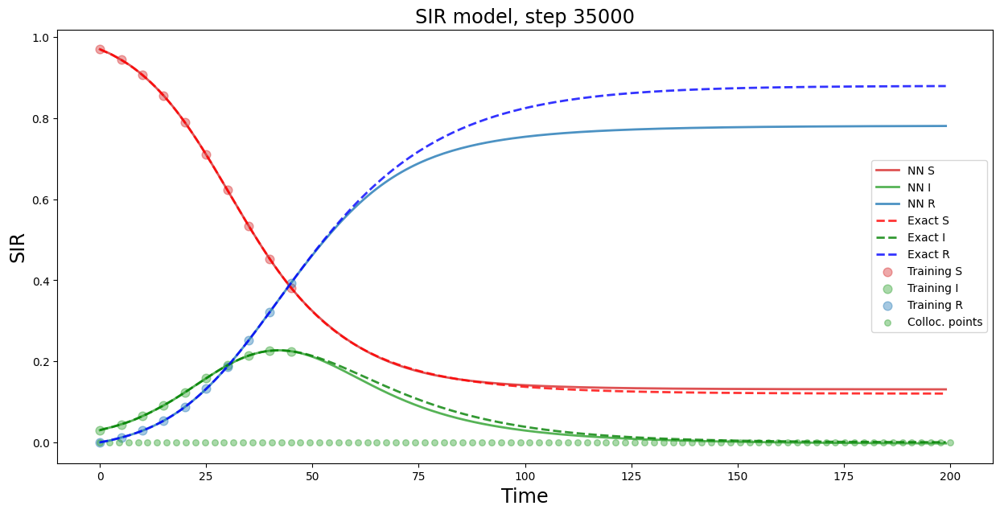

step = 35000 , loss1 = 1.2278516e-08 , loss2 = 3.0344864e-07 , loss = 3.1572716e-07 , mse = 0.0015917228 , beta = 0.14991112 , gamma = 0.063678004
step = 36000 , loss1 = 9.1407655e-09 , loss2 = 1.365855e-07 , loss = 1.4572626e-07 , mse = 0.0006319285 , beta = 0.1500831 , gamma = 0.06356364
step = 37000 , loss1 = 3.1619503e-08 , loss2 = 9.558481e-08 , loss = 1.2720432e-07 , mse = 0.00041069192 , beta = 0.150071 , gamma = 0.063536085
step = 38000 , loss1 = 3.401065e-09 , loss2 = 5.8700717e-08 , loss = 6.210178e-08 , mse = 0.00023865547 , beta = 0.15023193 , gamma = 0.06353919
step = 39000 , loss1 = 2.311762e-06 , loss2 = 9.339558e-08 , loss = 2.4051576e-06 , mse = 0.0003698568 , beta = 0.15082274 , gamma = 0.06398756
step = 40000 , loss1 = 2.7541096e-06 , loss2 = 7.260978e-08 , loss = 2.8267193e-06 , mse = 0.00022513194 , beta = 0.15055388 , gamma = 0.06346782
step = 41000 , loss1 = 5.3203975e-09 , loss2 = 3.923696e-08 , loss = 4.4557357e-08 , mse = 0.0001312969 , beta = 0.15058935 , gam

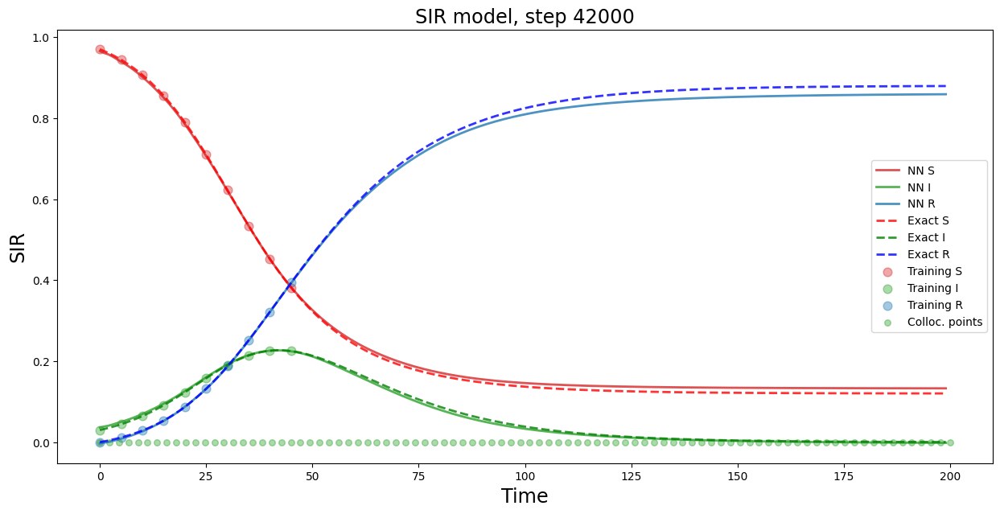

step = 42000 , loss1 = 1.0589026e-05 , loss2 = 1.9190016e-07 , loss = 1.0780926e-05 , mse = 0.00011097007 , beta = 0.14907111 , gamma = 0.06336059
step = 43000 , loss1 = 5.6289277e-08 , loss2 = 7.024167e-07 , loss = 7.5870594e-07 , mse = 0.003128467 , beta = 0.14956287 , gamma = 0.06411535
step = 44000 , loss1 = 1.3688514e-05 , loss2 = 1.9485873e-07 , loss = 1.3883372e-05 , mse = 0.0006008415 , beta = 0.14899808 , gamma = 0.06348503
step = 45000 , loss1 = 5.6477215e-06 , loss2 = 3.9821182e-07 , loss = 6.0459333e-06 , mse = 0.00034414203 , beta = 0.14893153 , gamma = 0.06395588
step = 46000 , loss1 = 9.871086e-06 , loss2 = 5.0827623e-08 , loss = 9.921914e-06 , mse = 2.811371e-05 , beta = 0.15052201 , gamma = 0.063748926
step = 47000 , loss1 = 1.0269777e-07 , loss2 = 2.026626e-08 , loss = 1.2296402e-07 , mse = 3.266078e-05 , beta = 0.15055054 , gamma = 0.06372735
step = 48000 , loss1 = 3.8928613e-07 , loss2 = 2.0757255e-08 , loss = 4.1004338e-07 , mse = 3.2865846e-05 , beta = 0.15054236 

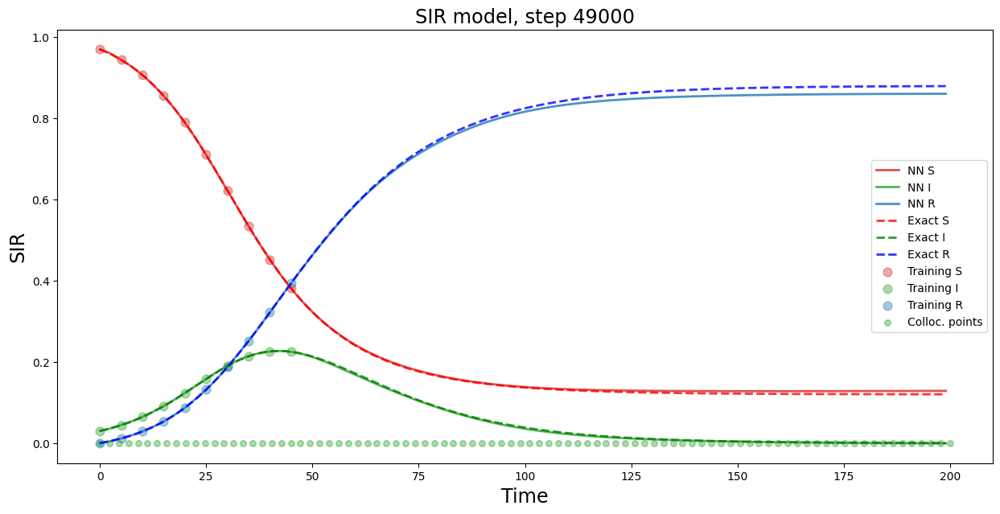

step = 49000 , loss1 = 7.718092e-08 , loss2 = 2.5875977e-08 , loss = 1.030569e-07 , mse = 5.3222182e-05 , beta = 0.15052898 , gamma = 0.06359357
step = 50000 , loss1 = 6.4430344e-07 , loss2 = 2.2670342e-08 , loss = 6.669738e-07 , mse = 4.9958224e-05 , beta = 0.1504693 , gamma = 0.06364512
step = 51000 , loss1 = 8.439648e-07 , loss2 = 1.5385815e-06 , loss = 2.3825464e-06 , mse = 0.0032999206 , beta = 0.14674176 , gamma = 0.060537916
step = 52000 , loss1 = 3.0018806e-05 , loss2 = 1.8941996e-07 , loss = 3.0208226e-05 , mse = 0.0006843191 , beta = 0.1499923 , gamma = 0.06351005
step = 53000 , loss1 = 8.018333e-09 , loss2 = 2.9329055e-08 , loss = 3.7347387e-08 , mse = 4.0830575e-05 , beta = 0.15056185 , gamma = 0.06374158
step = 54000 , loss1 = 3.2592905e-07 , loss2 = 2.3386416e-08 , loss = 3.4931546e-07 , mse = 2.4608147e-05 , beta = 0.15058875 , gamma = 0.06368803
step = 55000 , loss1 = 1.1277612e-06 , loss2 = 2.5977716e-08 , loss = 1.1537388e-06 , mse = 3.0156347e-05 , beta = 0.1506518 ,

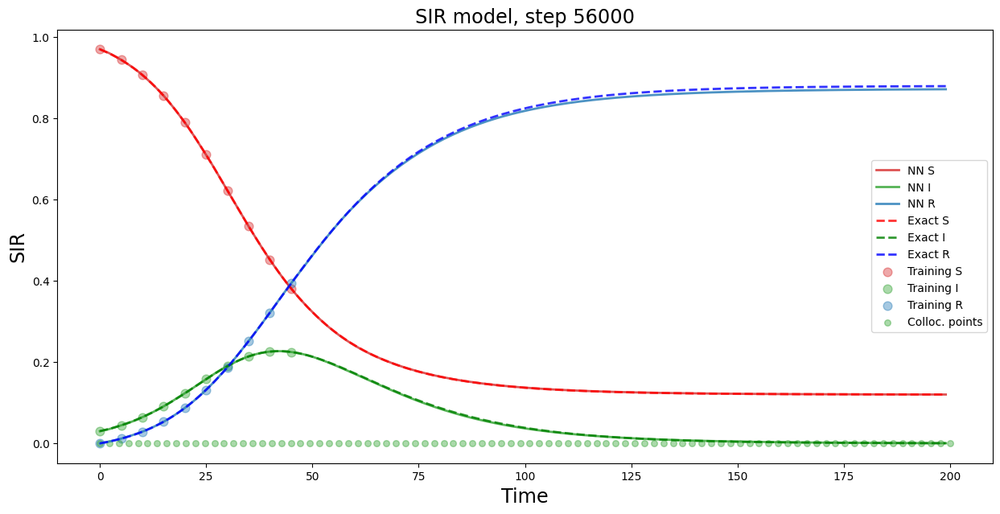

step = 56000 , loss1 = 8.994578e-09 , loss2 = 1.944954e-08 , loss = 2.844412e-08 , mse = 1.1832708e-05 , beta = 0.15062751 , gamma = 0.063552275
step = 57000 , loss1 = 3.4148322e-09 , loss2 = 1.362063e-08 , loss = 1.7035463e-08 , mse = 9.578143e-06 , beta = 0.15062226 , gamma = 0.06354174
step = 58000 , loss1 = 9.899149e-06 , loss2 = 3.6336512e-08 , loss = 9.935485e-06 , mse = 2.2781278e-05 , beta = 0.15004617 , gamma = 0.063213654
step = 59000 , loss1 = 1.9762696e-07 , loss2 = 2.1112584e-08 , loss = 2.1873954e-07 , mse = 1.911784e-05 , beta = 0.15039909 , gamma = 0.06322621
step = 60000 , loss1 = 6.487729e-09 , loss2 = 2.719981e-07 , loss = 2.7848583e-07 , mse = 0.00095696846 , beta = 0.1500435 , gamma = 0.06408443
step = 61000 , loss1 = 4.5203283e-10 , loss2 = 8.000745e-08 , loss = 8.0459486e-08 , mse = 0.00019546309 , beta = 0.15035549 , gamma = 0.06382207
step = 62000 , loss1 = 4.9154387e-08 , loss2 = 5.266734e-08 , loss = 1.01821726e-07 , mse = 7.03126e-05 , beta = 0.15059628 , ga

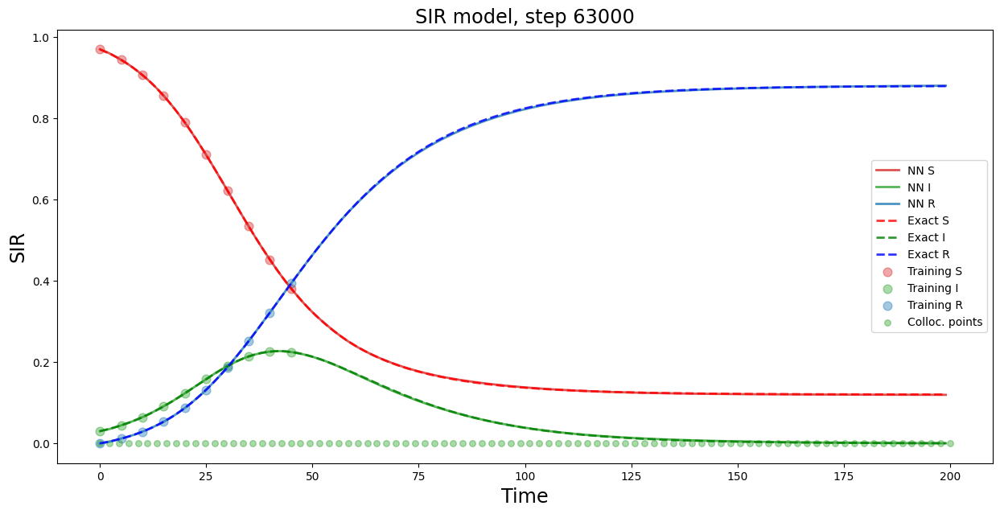

step = 63000 , loss1 = 7.825452e-11 , loss2 = 1.8276232e-08 , loss = 1.8354486e-08 , mse = 8.2036104e-07 , beta = 0.15062617 , gamma = 0.06352519
step = 64000 , loss1 = 4.2474147e-07 , loss2 = 2.3179478e-08 , loss = 4.4792094e-07 , mse = 2.4797714e-06 , beta = 0.15062189 , gamma = 0.063506044
step = 65000 , loss1 = 7.141418e-07 , loss2 = 5.1286673e-08 , loss = 7.6542847e-07 , mse = 1.9771745e-05 , beta = 0.14989159 , gamma = 0.06309504
step = 66000 , loss1 = 9.15168e-08 , loss2 = 2.2874136e-08 , loss = 1.1439094e-07 , mse = 4.280363e-06 , beta = 0.15037152 , gamma = 0.06345703
step = 67000 , loss1 = 1.5016775e-07 , loss2 = 9.977282e-07 , loss = 1.147896e-06 , mse = 0.0048107677 , beta = 0.1458679 , gamma = 0.06422478
step = 68000 , loss1 = 8.4531443e-10 , loss2 = 1.1906825e-07 , loss = 1.1991357e-07 , mse = 0.0007099915 , beta = 0.1503811 , gamma = 0.06380218
step = 69000 , loss1 = 1.17486316e-07 , loss2 = 2.7152475e-07 , loss = 3.8901106e-07 , mse = 0.0016922323 , beta = 0.1497309 , g

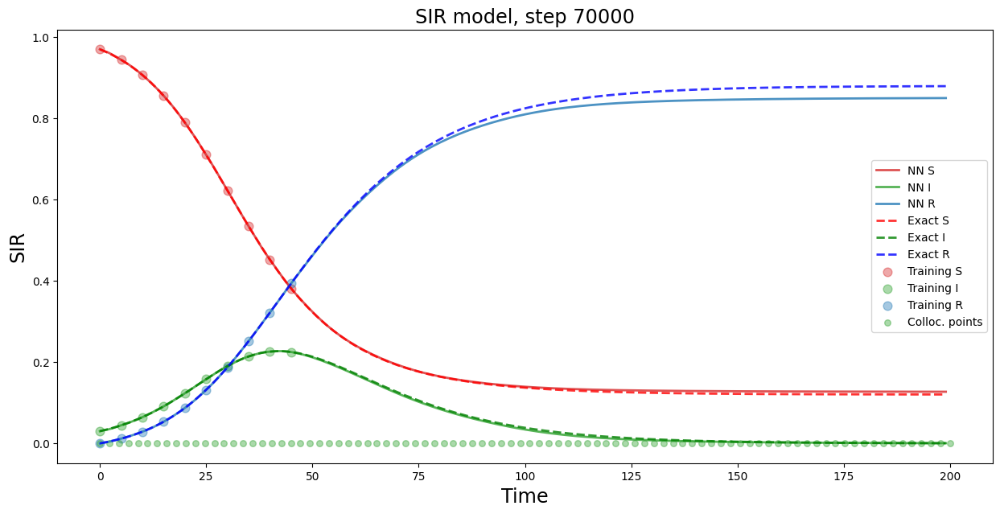

step = 70000 , loss1 = 1.4748465e-09 , loss2 = 3.5454704e-08 , loss = 3.692955e-08 , mse = 0.00012396087 , beta = 0.15042715 , gamma = 0.06360861


In [10]:
# Define device
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Your data tensors
x_data = sim_t_train.to(DEVICE)
y_data = sim_data_train.to(DEVICE)
x = sim_t.to(DEVICE)
y = sim_data.to(DEVICE)

# ......................
N = 1.0
torch.manual_seed(123)

# Move model to the device
modelD = FCND(1, 3, 42, 4).to(DEVICE)

optimizer = torch.optim.Adam(modelD.parameters(), lr=3e-3)

steps = 70000
print_steps = 500
n_prints = steps // print_steps

sim_loss1_history = np.zeros(n_prints)
sim_loss2_history = np.zeros(n_prints)
sim_loss_history = np.zeros(n_prints)
sim_mse_history = np.zeros(n_prints)
sim_beta_history = np.zeros(n_prints)
sim_gamma_history = np.zeros(n_prints)

x_physics = torch.linspace(0., 200, 90).view(-1, 1).requires_grad_(True).to(DEVICE)

for i in range(steps):
    optimizer.zero_grad()
    
    # compute the "data loss"
    yh = modelD(x_data)
    loss1 = 1 * torch.mean((yh - y_data)**2)
    
    # compute the "physics loss" with enforcing the initial data
    yhp = modelD(x_physics)
    yhp1 = yhp[:, 0].view(-1, 1)
    yhp2 = yhp[:, 1].view(-1, 1) 
    yhp3 = yhp[:, 2].view(-1, 1)
    
    # compute first and second derivatives by automatic differentiation
    dx1 = torch.autograd.grad(yhp1, x_physics, torch.ones_like(yhp1), create_graph=True)[0]
    dx2 = torch.autograd.grad(yhp2, x_physics, torch.ones_like(yhp2), create_graph=True)[0]
    dx3 = torch.autograd.grad(yhp3, x_physics, torch.ones_like(yhp3), create_graph=True)[0]

    # computes the residual
    physics2 = (dx1 + (modelD.beta/N) * yhp1 * yhp2)                
    physics1 = (dx2 - (modelD.beta/N) * yhp1 * yhp2 + modelD.gamma * yhp2)
    physics3 = (dx3 - modelD.gamma * yhp2)
    loss2 = 1 * torch.mean((physics1)**2) + 1 * torch.mean((physics2)**2) + 1 * torch.mean((physics3)**2)
    
    # backpropagate the total loss
    loss = loss1 + loss2
    loss.backward()
    optimizer.step()    
    
    # plot the result as training progresses
    if (i + 1) % print_steps == 0: 
        i_print = i // print_steps
        sim_loss1_history[i_print] = loss1.detach().cpu().numpy()
        sim_loss2_history[i_print] = loss2.detach().cpu().numpy()
        sim_loss_history[i_print] = loss.detach().cpu().numpy()
        
        yh = modelD(x).detach()
        xp = x_physics.detach()
        
        yhpp = modelD(x)
        mse = torch.mean((yhpp - y)**2)   # compute mean square error using exact solution
        sim_mse_history[i_print] = mse.detach().cpu().numpy()

        sim_beta_history[i_print] = modelD.beta.detach().cpu().numpy()[0]
        sim_gamma_history[i_print] = modelD.gamma.detach().cpu().numpy()[0]

        if (i + 1) == 500: plot_result(i, x.cpu(), y.cpu(), x_data.cpu(), y_data.cpu(), yh.cpu(), xp.cpu())
        if (i + 1) % 1000 == 0 and (i + 1) < 5000: plot_result(i, x.cpu(), y.cpu(), x_data.cpu(), y_data.cpu(), yh.cpu(), xp.cpu())
        if (i + 1) % 7000 == 0: plot_result(i, x.cpu(), y.cpu(), x_data.cpu(), y_data.cpu(), yh.cpu(), xp.cpu())
        else: plt.close("all")
    if (i + 1) % 1000 == 0:
        print('step =', i + 1, ', loss1 =', loss1.detach().cpu().numpy(), ', loss2 =', loss2.detach().cpu().numpy(), ', loss =', loss.detach().cpu().numpy(),
              ', mse =', mse.detach().cpu().numpy(), ', beta =', modelD.beta.detach().cpu().numpy()[0], ', gamma =', modelD.gamma.detach().cpu().numpy()[0])


In [ ]:
all_steps = np.arange(0, steps, print_steps)

fig33 = plt.figure(33)
plt.plot(all_steps,sim_loss_history, label="loss")
plt.plot(all_steps,sim_mse_history, label="mse")
plt.xlabel('Training step',fontsize="xx-large")
plt.yscale('log')
plt.legend()

fig50 = plt.figure(50)
plt.plot(all_steps,sim_loss1_history, label="loss1")
plt.plot(all_steps,sim_loss2_history, label="loss2")
plt.yscale('log')
plt.legend()

fig51 = plt.figure(51)
plt.plot(all_steps,sim_loss_history, label="loss")
plt.yscale('log')
plt.legend()

fig60 = plt.figure(60)
plt.plot(all_steps,sim_beta_history, label="beta")
plt.plot(all_steps,sim_gamma_history, label="gamma")
plt.legend()

#find the index of min loss
min_loss_index = np.argmin(sim_loss_history)
print('Los mejores valores de beta y gamma son, beta =', sim_beta_history[min_loss_index], ', gamma =', sim_gamma_history[min_loss_index])

### PINN sin busqueda de parametros

In [9]:
# ......................
ww=1.0
N = 1.0
beta = sim_beta_history[min_loss_index]
gamma = sim_gamma_history[min_loss_index]
torch.manual_seed(123)
model = FCN(1,3,42,4)

optimizer = torch.optim.Adam(model.parameters(),lr=3e-3)
files = []
loss1_history = []
loss2_history = []
loss_history = []
mse_history = []

x_physics = torch.linspace(0.,200,90).view(-1,1).requires_grad_(True)

for i in range(50000):
    #lim= np.minimum(200*i/74000.,200)
    #x_physics = torch.linspace(0.,lim,90).view(-1,1).requires_grad_(True)#
    optimizer.zero_grad()
    
    # compute the "data loss" ..................................................
    yh = model(x_data)
    loss1 = 1*torch.mean((yh-y_data)**2)
    
    # compute the "physics loss" with enforcing the initial data ..............
    yhp = model(x_physics)
    yhp1= yhp[:,0].view(-1,1)
    yhp2= yhp[:,1].view(-1,1) 
    yhp3= yhp[:,2].view(-1,1)
    
    # compute first and second derivatives by automatic differentiation ....................
    dx1 = torch.autograd.grad(yhp1, x_physics, torch.ones_like(yhp1), create_graph=True)[0]
    dx2 = torch.autograd.grad(yhp2, x_physics, torch.ones_like(yhp2), create_graph=True)[0]
    dx3 = torch.autograd.grad(yhp3, x_physics, torch.ones_like(yhp3), create_graph=True)[0]
    #! aqui quede
    # computes the residual .............................................
    physics2 = (dx1 + beta/N*yhp1*yhp2)                
    physics1 = (dx2 - beta/N*yhp1*yhp2 + gamma*yhp2)
    physics3 = (dx3 - gamma*yhp2)
    loss2 = 1*torch.mean((physics1)**2) + 1*torch.mean((physics2)**2) + 1*torch.mean((physics3)**2)
    
    # backpropagate the total loss ...............................................
    loss = loss1 + loss2  # add two loss terms together .....................
    loss.backward()
    optimizer.step()    
        
    # plot the result as training progresses ...............................
    
    if (i+1) % 500 == 0: 
        loss1_history.append(loss1.detach())
        loss2_history.append(loss2.detach())
        loss_history.append(loss.detach())
        
        yh = model(x).detach()
        xp = x_physics.detach()
        
        yhpp=model(x)
        mse=torch.mean((yhpp-y)**2)   # compute mean square error using exact solution .....
        mse_history.append(mse.detach())

        #if (i+1) == 500: plot_result(i,x,y,x_data,y_data,yh,xp)
        #if (i+1) % 1000 == 0 and (i+1) < 5000: plot_result(i,x,y,x_data,y_data,yh,xp)
        if (i+1) % 5000 == 0: plot_result(i,x,y,x_data,y_data,yh,xp)
        else: plt.close("all")
    if (i+1) % 1000 == 0: print(i+1, loss1.detach(), loss2.detach(), loss.detach(), mse)
    

NameError: name 'min_loss_index' is not defined

In [ ]:
fig33 = plt.figure(33)
plt.plot(loss_history, label="loss")
plt.plot(mse_history, label="mse")
plt.xlabel('Training step ($10^2$)',fontsize="xx-large")
plt.yscale('log')
plt.legend()

fig50 = plt.figure(50)
plt.plot(loss1_history, label="loss1")
plt.plot(loss2_history, label="loss2")
plt.yscale('log')
plt.legend()

fig51 = plt.figure(51)
plt.plot(loss_history, label="loss")
plt.yscale('log')
plt.legend()

### Prediccion de los datos con la red entrenada con los datos teoricos:

In [ ]:

modelD.eval()

# Ex
new_data = torch.tensor([[0.5], [1.0], [1.5]], dtype=torch.float32).to(DEVICE)  

new_data = new_data.to(DEVICE)

# Make predictions
with torch.no_grad():  
    predictions = modelD(new_data)

# Convert predictions to CPU and to numpy for further processing if needed
predictions = predictions.cpu().numpy()


print(predictions)

# Colombia

In [3]:
colom = pd.read_csv(r'colombia_data.csv')

In [4]:
colom.head()    

,t,S,I,R
0,0,4.550860e+07,15273.750000,6.085123e+06
1,1,4.550836e+07,15503.000000,6.085138e+06
2,2,4.550807e+07,15480.000000,6.085449e+06
3,3,4.550777e+07,15556.714286,6.085675e+06
4,4,4.550722e+07,15817.857143,6.085959e+06


torch.Size([115, 1]) torch.Size([115, 3])
torch.Size([28, 1]) torch.Size([28, 3])


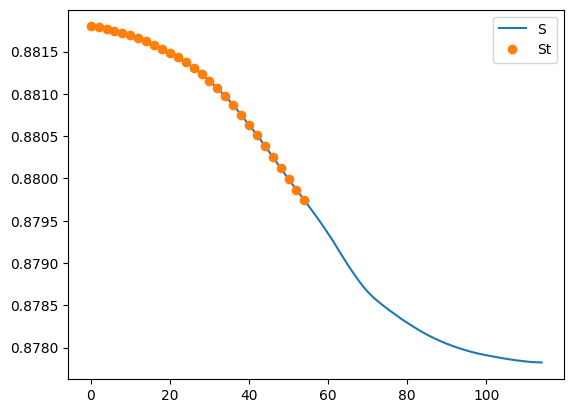

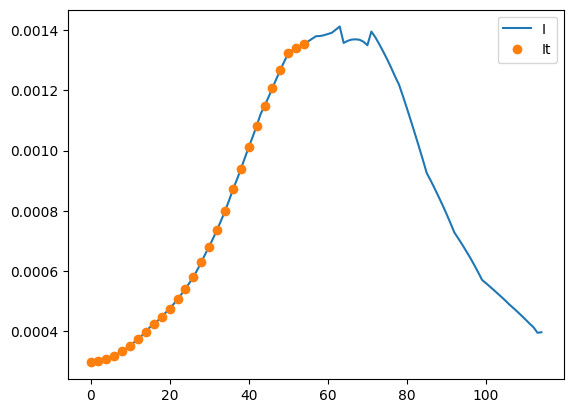

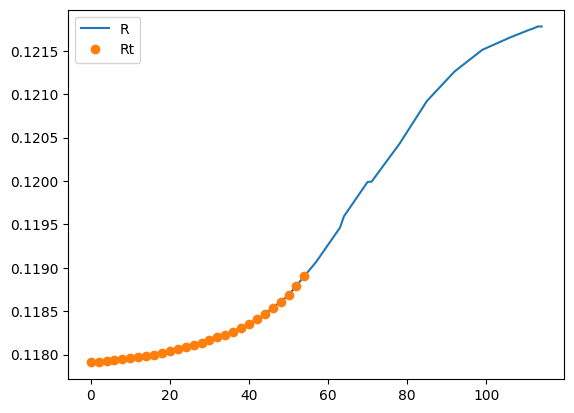

In [13]:
colom = pd.read_csv(r'colombia_data.csv')
N_old = colom['S'][0] + colom['I'][0] + colom['R'][0]
colom['S'] = colom['S'] / N_old
colom['I'] = colom['I'] / N_old
colom['R'] = colom['R'] / N_old

colom_t = torch.tensor(colom[['t']].values, dtype=torch.float32)
colom_data = torch.tensor(colom[['S', 'I', 'R']].values, dtype=torch.float32)

print(colom_t.shape, colom_data.shape)

colom_t_train = colom_t[:56:2]
colom_data_train = colom_data[:56:2]

print(colom_t_train.shape, colom_data_train.shape)

fig = plt.figure()
plt.plot(colom_t, colom_data[:,0], label='S' )
plt.plot(colom_t_train, colom_data_train[:,0], 'o', label='St')
plt.legend();

fig = plt.figure()
plt.plot(colom_t, colom_data[:,1], label='I' )
plt.plot(colom_t_train, colom_data_train[:,1], 'o', label='It')
plt.legend();

fig = plt.figure()
plt.plot(colom_t, colom_data[:,2], label='R' )
plt.plot(colom_t_train, colom_data_train[:,2], 'o', label='Rt')
plt.legend();

### Entrenando con los datos de colombia:

In [ ]:
# Define device
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Your data tensors
x_data = colom_t_train.to(DEVICE)
y_data = colom_data_train.to(DEVICE)
x = colom_t.to(DEVICE)
y = colom_data.to(DEVICE)

# ......................
N = 1.0
torch.manual_seed(123)

# Move model to the device
modelD = FCND(1, 3, 128, 6).to(DEVICE)

optimizer = torch.optim.Adam(modelD.parameters(), lr=1e-4)

steps = 70000
print_steps = 500
n_prints = steps // print_steps

Alem_loss1_history = np.zeros(n_prints)
Alem_loss2_history = np.zeros(n_prints)
Alem_loss_history = np.zeros(n_prints)
Alem_mse_history = np.zeros(n_prints)
Alem_beta_history = np.zeros(n_prints)
Alem_gamma_history = np.zeros(n_prints)

x_physics = torch.linspace(0., colom['t'].max(), 90).view(-1, 1).requires_grad_(True).to(DEVICE)

for i in range(steps):
    optimizer.zero_grad()
    
    # compute the "data loss"
    yh = modelD(x_data)
    loss1 = 1 * torch.mean((yh - y_data)**2)
    
    # compute the "physics loss" with enforcing the initial data
    yhp = modelD(x_physics)
    yhp1 = yhp[:, 0].view(-1, 1)
    yhp2 = yhp[:, 1].view(-1, 1)
    yhp3 = yhp[:, 2].view(-1, 1)
    
    # compute first and second derivatives by automatic differentiation
    dx1 = torch.autograd.grad(yhp1, x_physics, torch.ones_like(yhp1), create_graph=True)[0]
    dx2 = torch.autograd.grad(yhp2, x_physics, torch.ones_like(yhp2), create_graph=True)[0]
    dx3 = torch.autograd.grad(yhp3, x_physics, torch.ones_like(yhp3), create_graph=True)[0]

    # computes the residual
    physics2 = (dx1 + (modelD.beta / N) * yhp1 * yhp2)
    physics1 = (dx2 - (modelD.beta / N) * yhp1 * yhp2 + modelD.gamma * yhp2)
    physics3 = (dx3 - modelD.gamma * yhp2)
    loss2 = 1 * torch.mean((physics1)**2) + 1 * torch.mean((physics2)**2) + 1 * torch.mean((physics3)**2)
    
    # backpropagate the total loss
    loss = loss1 + loss2
    loss.backward()
    optimizer.step()    
    
    # plot the result as training progresses
    if (i + 1) % print_steps == 0: 
        i_print = i // print_steps
        Alem_loss1_history[i_print] = loss1.detach().cpu().numpy()
        Alem_loss2_history[i_print] = loss2.detach().cpu().numpy()
        Alem_loss_history[i_print] = loss.detach().cpu().numpy()
        
        yh = modelD(x).detach()
        xp = x_physics.detach()
        
        yhpp = modelD(x)
        mse = torch.mean((yhpp - y)**2)   # compute mean square error using exact solution
        Alem_mse_history[i_print] = mse.detach().cpu().numpy()

        Alem_beta_history[i_print] = modelD.beta.detach().cpu().numpy()[0]
        Alem_gamma_history[i_print] = modelD.gamma.detach().cpu().numpy()[0]

        if (i + 1) == 500: plot_result_al(i, x.cpu(), y.cpu(), x_data.cpu(), y_data.cpu(), yh.cpu(), xp.cpu())
        if (i + 1) % 1000 == 0 and (i + 1) < 5000: plot_result_al(i, x.cpu(), y.cpu(), x_data.cpu(), y_data.cpu(), yh.cpu(), xp.cpu())
        if (i + 1) % 7000 == 0: plot_result_al(i, x.cpu(), y.cpu(), x_data.cpu(), y_data.cpu(), yh.cpu(), xp.cpu())
        else: plt.close("all")
    if (i + 1) % 1000 == 0:
        print('step =', i + 1, ', loss1 =', loss1.detach().cpu().numpy(), ', loss2 =', loss2.detach().cpu().numpy(), ', loss =', loss.detach().cpu().numpy(),
              ', mse =', mse.detach().cpu().numpy(), ', beta =', modelD.beta.detach().cpu().numpy()[0], ', gamma =', modelD.gamma.detach().cpu().numpy()[0])


### Prediccion de los datos de colombia con la red entrenada con los datos teoricos:

# Alemania 

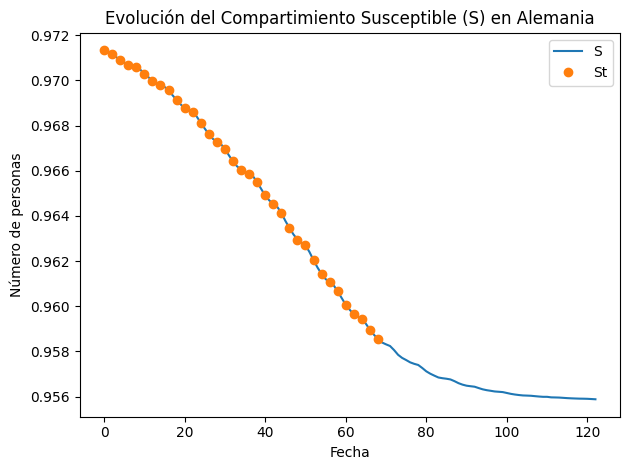

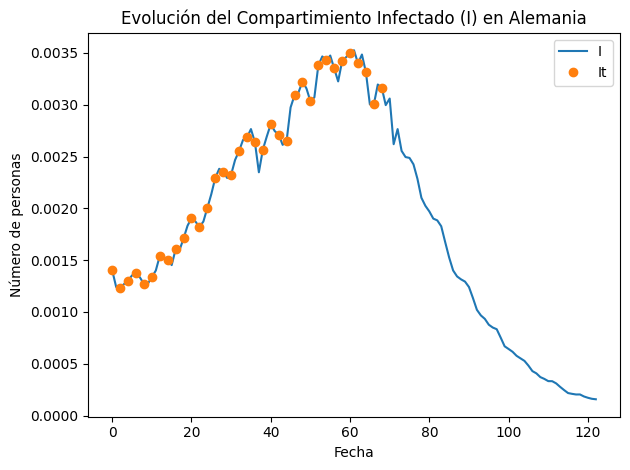

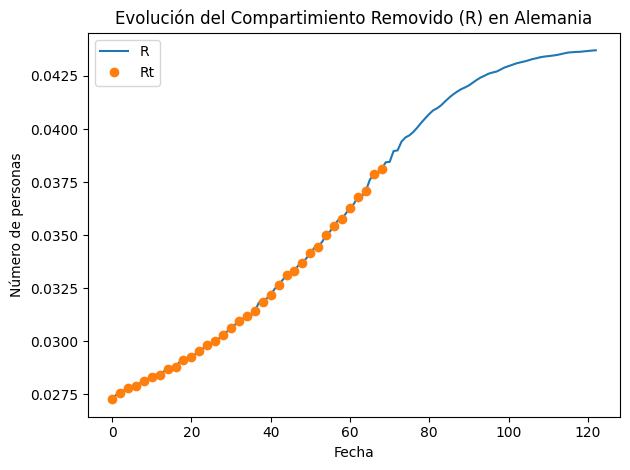

In [45]:
# Cargar los datos
Alem = pd.read_csv('Serie_Covid_Alemania_Parcial.csv')
N_old = Alem['S'][0] + Alem['I'][0] + Alem['R'][0]
Alem['S'] = Alem['S'] / N_old
Alem['I'] = Alem['I'] / N_old
Alem['R'] = Alem['R'] / N_old

Alem_t = torch.tensor(Alem[['t']].values, dtype=torch.float32)
Alem_data = torch.tensor(Alem[['S', 'I', 'R']].values, dtype=torch.float32)

Alem_t_train = Alem_t[:70:2]
Alem_data_train = Alem_data[:70:2]

# Gráfico del compartimiento Susceptible (S)
fig = plt.figure()
plt.plot(Alem_t, Alem_data[:,0], label='S' )
plt.plot(Alem_t_train, Alem_data_train[:,0], 'o', label='St')
plt.xlabel('Fecha')
plt.ylabel('Número de personas')
plt.title('Evolución del Compartimiento Susceptible (S) en Alemania')
plt.legend()
plt.tight_layout()  # Ajustar el diseño para evitar que se corte el título
plt.savefig('Evolucion_S_Compartimiento_Alemania.png')
plt.show()

# Gráfico del compartimiento Infectado (I)
fig = plt.figure()
plt.plot(Alem_t, Alem_data[:,1], label='I' )
plt.plot(Alem_t_train, Alem_data_train[:,1], 'o', label='It')
plt.xlabel('Fecha')
plt.ylabel('Número de personas')
plt.title('Evolución del Compartimiento Infectado (I) en Alemania')
plt.legend()
plt.tight_layout()  # Ajustar el diseño para evitar que se corte el título
plt.savefig('Evolucion_I_Compartimiento_Alemania.png')
plt.show()

# Gráfico del compartimiento Removido (R)
fig = plt.figure()
plt.plot(Alem_t, Alem_data[:,2], label='R' )
plt.plot(Alem_t_train, Alem_data_train[:,2], 'o', label='Rt')
plt.xlabel('Fecha')
plt.ylabel('Número de personas')
plt.title('Evolución del Compartimiento Removido (R) en Alemania')
plt.legend()
plt.tight_layout()  # Ajustar el diseño para evitar que se corte el título
plt.savefig('Evolucion_R_Compartimiento_Alemania.png')
plt.show()

In [32]:
N_old

82929327.75

### PINN con busqueda de parametros

In [33]:
alem = pd.read_csv('Serie_Covid_Alemania_Parcial.csv')

In [34]:
alem.head()

,t,S,I,R
0,0,8.054249e+07,106721.000000,2.280120e+06
1,1,8.053749e+07,107000.600000,2.284675e+06
2,2,8.053256e+07,107864.000000,2.288578e+06
3,3,8.052788e+07,108723.714286,2.292267e+06
4,4,8.051958e+07,107906.714286,2.301127e+06


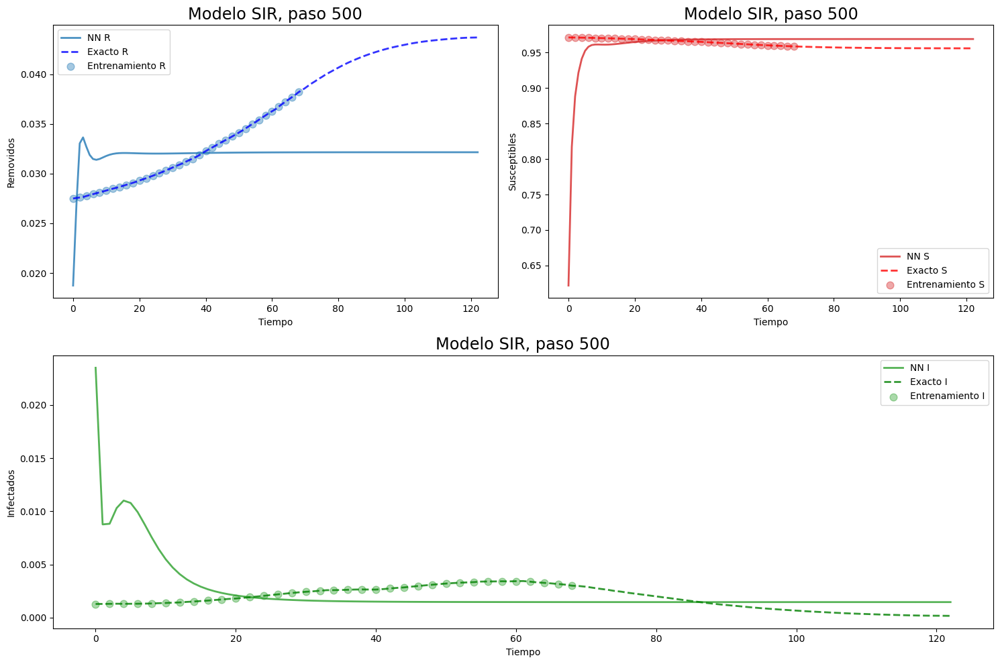

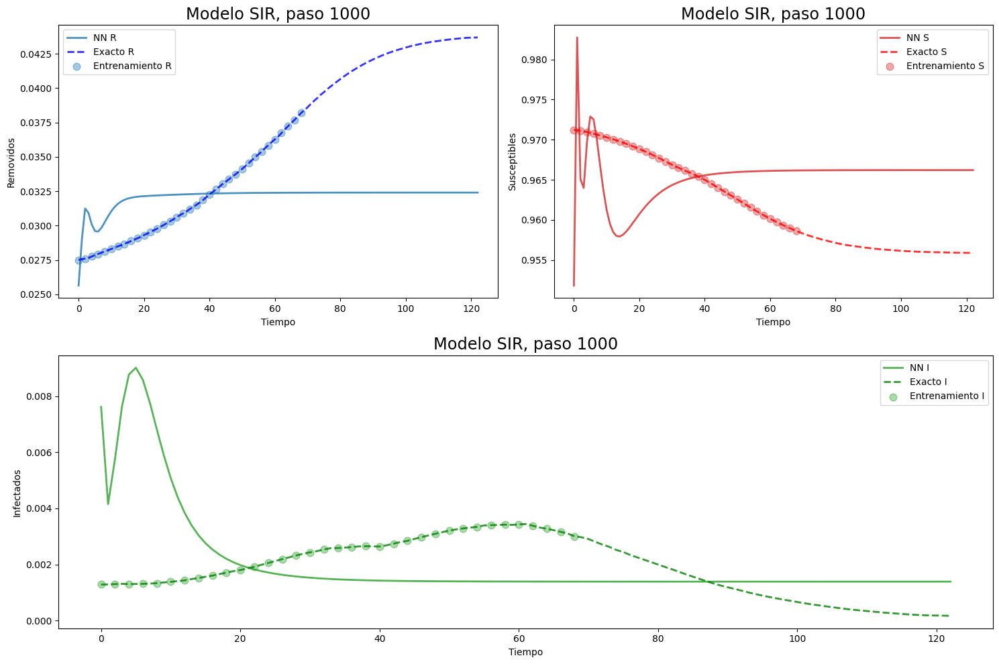

Paso = 1000 , pérdida de datos = 1.9874446e-05 , pérdida física = 0.00013933305 , pérdida total = 0.0001592075 , mse = 3.8167604e-05 , beta = -0.06946694 , gamma = 0.037629236


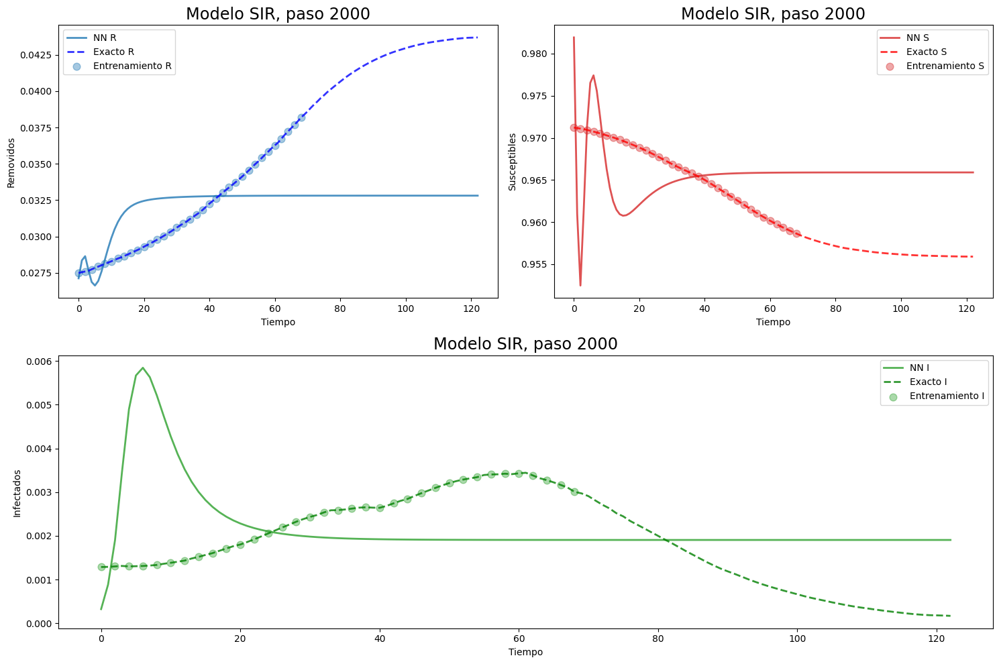

Paso = 2000 , pérdida de datos = 1.4911185e-05 , pérdida física = 9.270487e-06 , pérdida total = 2.418167e-05 , mse = 3.3519533e-05 , beta = -0.07123937 , gamma = 0.0352473


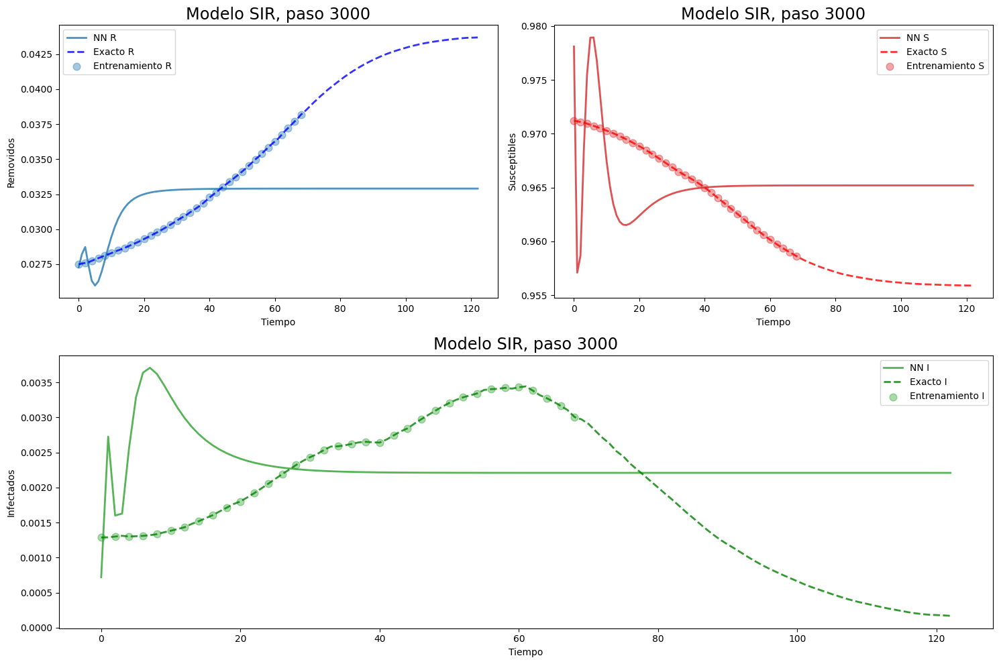

Paso = 3000 , pérdida de datos = 1.1085802e-05 , pérdida física = 2.2962633e-06 , pérdida total = 1.3382065e-05 , mse = 3.0108286e-05 , beta = -0.06781752 , gamma = 0.030162157


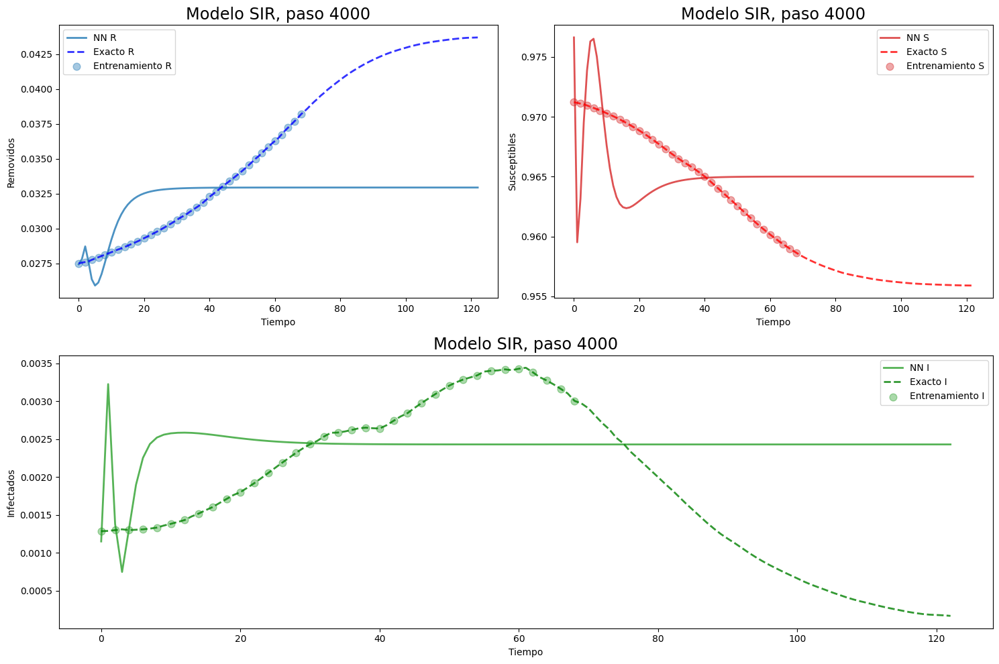

Paso = 4000 , pérdida de datos = 8.552126e-06 , pérdida física = 1.1953426e-06 , pérdida total = 9.7474685e-06 , mse = 2.8280261e-05 , beta = -0.062302273 , gamma = 0.022942793
Paso = 5000 , pérdida de datos = 6.7005817e-06 , pérdida física = 6.920694e-07 , pérdida total = 7.3926512e-06 , mse = 2.6380183e-05 , beta = -0.054690097 , gamma = 0.013130373
Paso = 6000 , pérdida de datos = 5.4316865e-06 , pérdida física = 5.2589735e-07 , pérdida total = 5.957584e-06 , mse = 2.453827e-05 , beta = -0.04472027 , gamma = 0.0023374804


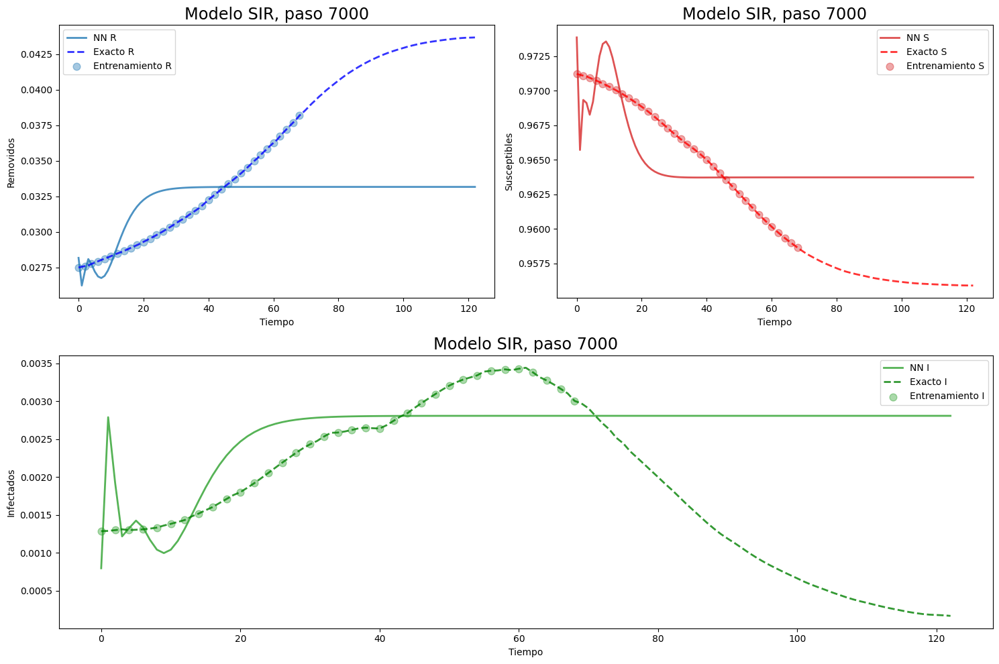

Paso = 7000 , pérdida de datos = 4.453671e-06 , pérdida física = 4.4854767e-07 , pérdida total = 4.9022187e-06 , mse = 2.2540788e-05 , beta = -0.03242827 , gamma = -0.004560996
Paso = 8000 , pérdida de datos = 2.678653e-06 , pérdida física = 2.6735768e-07 , pérdida total = 2.9460107e-06 , mse = 1.7613602e-05 , beta = -0.01779845 , gamma = -0.0034427592
Paso = 9000 , pérdida de datos = 2.044222e-07 , pérdida física = 1.036918e-07 , pérdida total = 3.0811398e-07 , mse = 4.160924e-06 , beta = 0.005425039 , gamma = 0.008036766
Paso = 10000 , pérdida de datos = 8.589188e-08 , pérdida física = 5.3931565e-08 , pérdida total = 1.3982344e-07 , mse = 3.1485763e-06 , beta = 0.029969556 , gamma = 0.023922447
Paso = 11000 , pérdida de datos = 5.081924e-08 , pérdida física = 2.957308e-08 , pérdida total = 8.039232e-08 , mse = 3.0930498e-06 , beta = 0.03952804 , gamma = 0.030247057
Paso = 12000 , pérdida de datos = 8.5424847e-07 , pérdida física = 2.1926827e-08 , pérdida total = 8.761753e-07 , mse = 

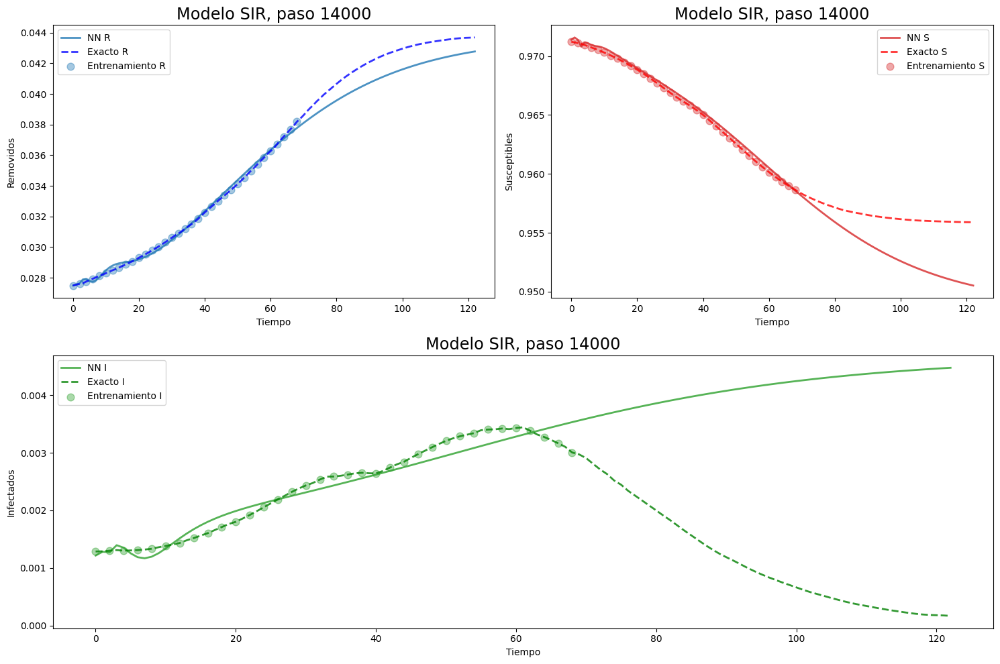

Paso = 14000 , pérdida de datos = 2.5903478e-08 , pérdida física = 1.45574095e-08 , pérdida total = 4.046089e-08 , mse = 3.3650606e-06 , beta = 0.047484484 , gamma = 0.03633626
Paso = 15000 , pérdida de datos = 2.3179147e-08 , pérdida física = 1.3053677e-08 , pérdida total = 3.6232827e-08 , mse = 3.866588e-06 , beta = 0.049395632 , gamma = 0.03796733
Paso = 16000 , pérdida de datos = 7.584666e-07 , pérdida física = 1.4831909e-08 , pérdida total = 7.7329855e-07 , mse = 6.490009e-06 , beta = 0.051202312 , gamma = 0.039560404
Paso = 17000 , pérdida de datos = 1.9580602e-08 , pérdida física = 1.0808965e-08 , pérdida total = 3.0389568e-08 , mse = 4.5717675e-06 , beta = 0.05290191 , gamma = 0.041074958
Paso = 18000 , pérdida de datos = 2.1197533e-08 , pérdida física = 9.962934e-09 , pérdida total = 3.1160468e-08 , mse = 5.0668114e-06 , beta = 0.054546226 , gamma = 0.042558353
Paso = 19000 , pérdida de datos = 1.7660497e-08 , pérdida física = 9.163472e-09 , pérdida total = 2.6823969e-08 , mse

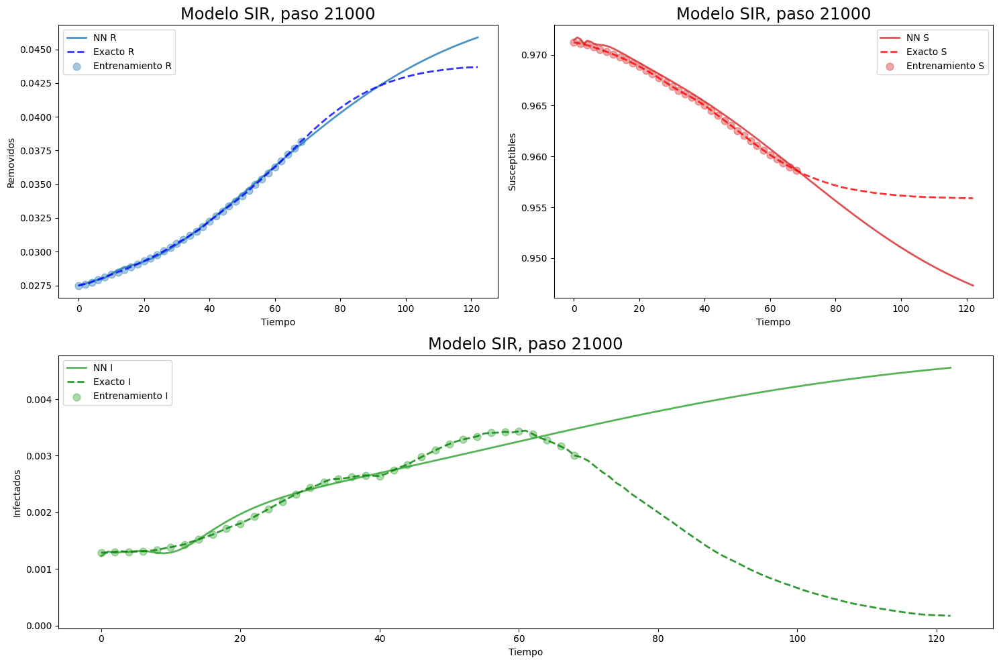

Paso = 21000 , pérdida de datos = 2.7262177e-08 , pérdida física = 7.889042e-09 , pérdida total = 3.5151217e-08 , mse = 5.3626113e-06 , beta = 0.058743745 , gamma = 0.04642924
Paso = 22000 , pérdida de datos = 1.4891087e-08 , pérdida física = 7.2334245e-09 , pérdida total = 2.212451e-08 , mse = 6.2281665e-06 , beta = 0.059961375 , gamma = 0.047556095
Paso = 23000 , pérdida de datos = 6.755813e-08 , pérdida física = 8.712438e-09 , pérdida total = 7.6270574e-08 , mse = 6.7693773e-06 , beta = 0.060640458 , gamma = 0.048210386
Paso = 24000 , pérdida de datos = 1.4291888e-08 , pérdida física = 6.254675e-09 , pérdida total = 2.0546562e-08 , mse = 6.8251356e-06 , beta = 0.062085316 , gamma = 0.049569886
Paso = 25000 , pérdida de datos = 3.5982648e-08 , pérdida física = 5.836731e-09 , pérdida total = 4.181938e-08 , mse = 7.4476334e-06 , beta = 0.06302478 , gamma = 0.050472498
Paso = 26000 , pérdida de datos = 4.7345182e-08 , pérdida física = 5.4945906e-09 , pérdida total = 5.2839773e-08 , mse 

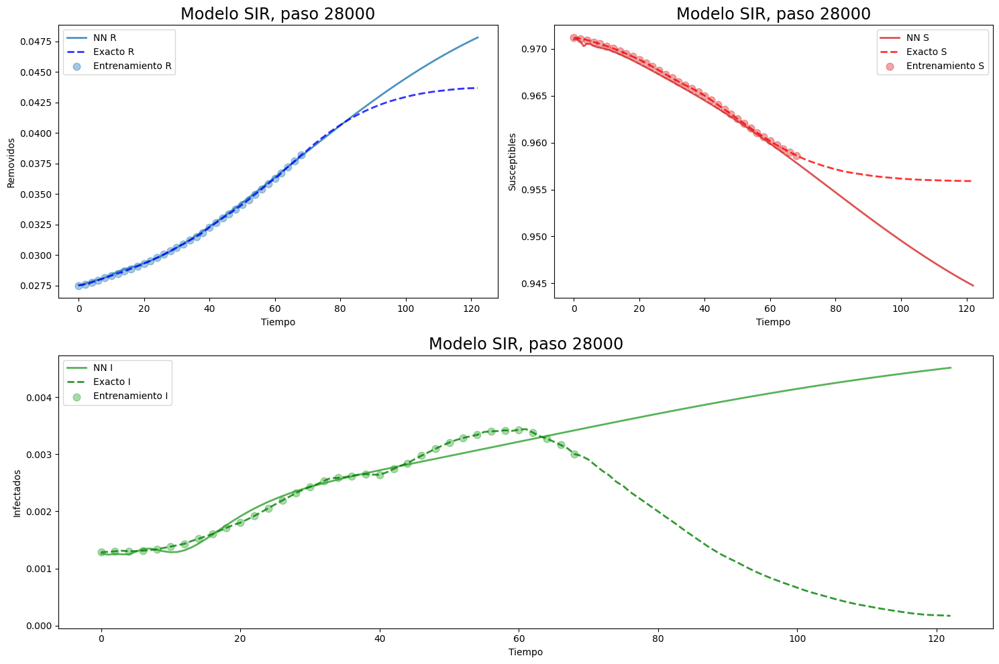

Paso = 28000 , pérdida de datos = 2.957252e-07 , pérdida física = 6.0824723e-09 , pérdida total = 3.0180766e-07 , mse = 8.31712e-06 , beta = 0.065223 , gamma = 0.052667964
Paso = 29000 , pérdida de datos = 1.4072276e-07 , pérdida física = 5.0517537e-09 , pérdida total = 1.4577452e-07 , mse = 9.180381e-06 , beta = 0.06594969 , gamma = 0.053343765
Paso = 30000 , pérdida de datos = 1.332018e-07 , pérdida física = 4.8246465e-09 , pérdida total = 1.3802644e-07 , mse = 9.449874e-06 , beta = 0.06651871 , gamma = 0.053916425
Paso = 31000 , pérdida de datos = 4.1594024e-08 , pérdida física = 3.8700105e-09 , pérdida total = 4.5464034e-08 , mse = 7.92426e-06 , beta = 0.06642116 , gamma = 0.053938705
Paso = 32000 , pérdida de datos = 1.6402828e-08 , pérdida física = 4.0663024e-09 , pérdida total = 2.046913e-08 , mse = 8.493955e-06 , beta = 0.06701954 , gamma = 0.05450065
Paso = 33000 , pérdida de datos = 1.1741146e-08 , pérdida física = 3.6085472e-09 , pérdida total = 1.5349693e-08 , mse = 8.31809

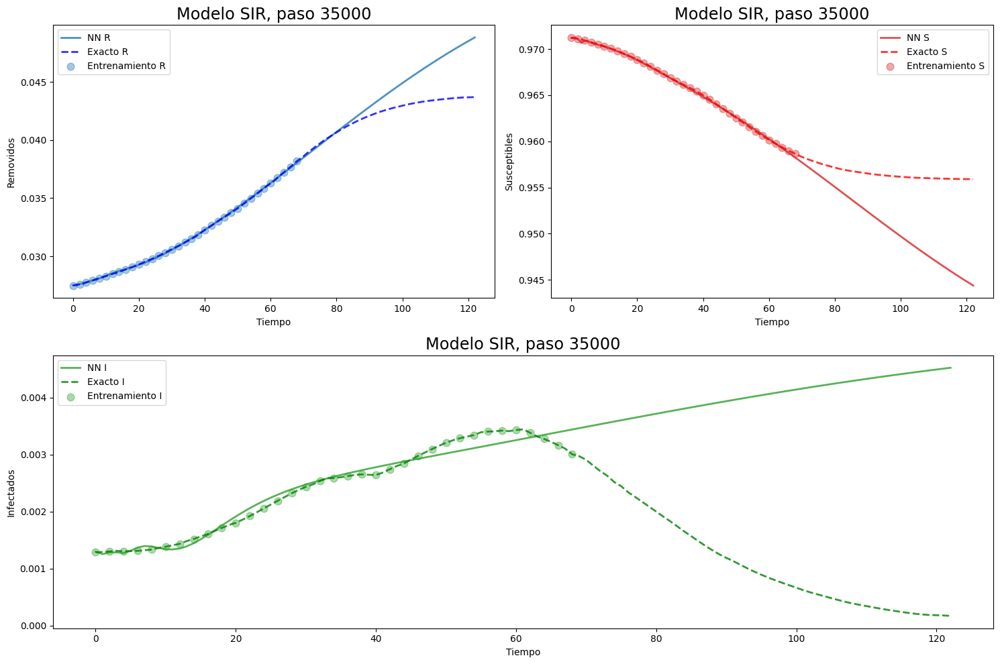

Paso = 35000 , pérdida de datos = 1.4521597e-08 , pérdida física = 3.3150838e-09 , pérdida total = 1.7836681e-08 , mse = 8.564231e-06 , beta = 0.0686888 , gamma = 0.05618392
Paso = 36000 , pérdida de datos = 1.1548345e-08 , pérdida física = 3.1120169e-09 , pérdida total = 1.4660362e-08 , mse = 8.5904685e-06 , beta = 0.06900794 , gamma = 0.0565216
Paso = 37000 , pérdida de datos = 1.1162002e-08 , pérdida física = 2.9735503e-09 , pérdida total = 1.4135552e-08 , mse = 8.644499e-06 , beta = 0.069316424 , gamma = 0.056864083
Paso = 38000 , pérdida de datos = 4.374254e-08 , pérdida física = 4.1434194e-09 , pérdida total = 4.788596e-08 , mse = 8.711797e-06 , beta = 0.06903627 , gamma = 0.056717068
Paso = 39000 , pérdida de datos = 1.2619763e-08 , pérdida física = 2.740569e-09 , pérdida total = 1.5360332e-08 , mse = 8.820026e-06 , beta = 0.06982251 , gamma = 0.057457116
Paso = 40000 , pérdida de datos = 9.098486e-08 , pérdida física = 3.78083e-09 , pérdida total = 9.4765696e-08 , mse = 8.22944

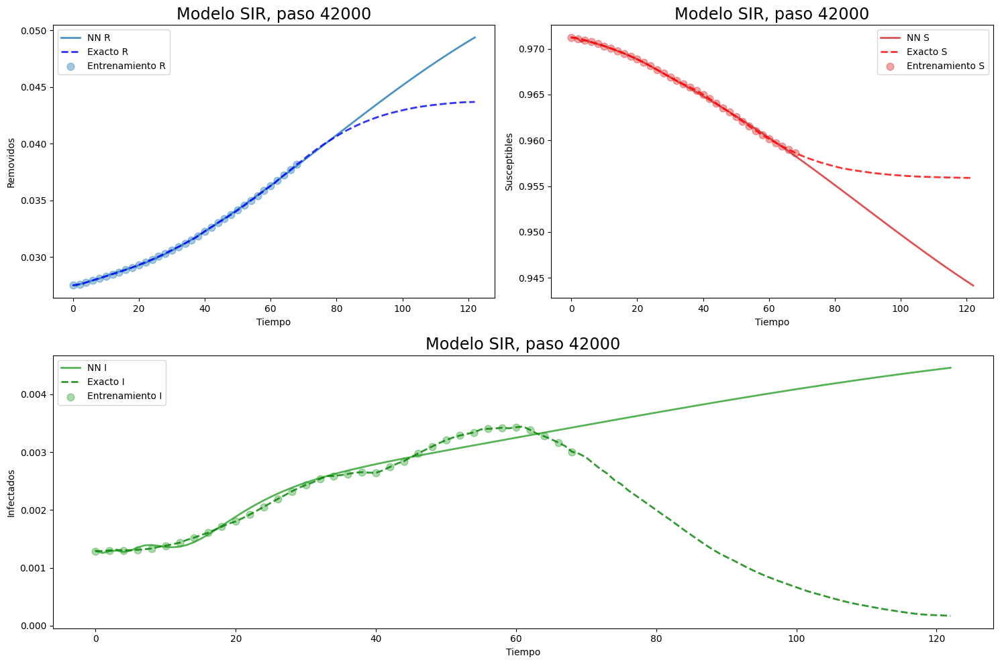

Paso = 42000 , pérdida de datos = 1.0789671e-08 , pérdida física = 2.4139002e-09 , pérdida total = 1.3203572e-08 , mse = 8.831288e-06 , beta = 0.0704566 , gamma = 0.05822801
Paso = 43000 , pérdida de datos = 1.1111755e-08 , pérdida física = 2.336747e-09 , pérdida total = 1.3448502e-08 , mse = 8.9075265e-06 , beta = 0.070629515 , gamma = 0.058434173
Paso = 44000 , pérdida de datos = 1.07312745e-08 , pérdida física = 2.242344e-09 , pérdida total = 1.2973619e-08 , mse = 8.769372e-06 , beta = 0.07081241 , gamma = 0.05866745
Paso = 45000 , pérdida de datos = 2.663383e-07 , pérdida física = 2.7475513e-09 , pérdida total = 2.6908586e-07 , mse = 9.704788e-06 , beta = 0.07099501 , gamma = 0.058890264
Paso = 46000 , pérdida de datos = 1.1504439e-08 , pérdida física = 2.1524817e-09 , pérdida total = 1.3656921e-08 , mse = 8.91755e-06 , beta = 0.07114171 , gamma = 0.059075814
Paso = 47000 , pérdida de datos = 1.3966586e-08 , pérdida física = 2.100549e-09 , pérdida total = 1.6067135e-08 , mse = 8.67

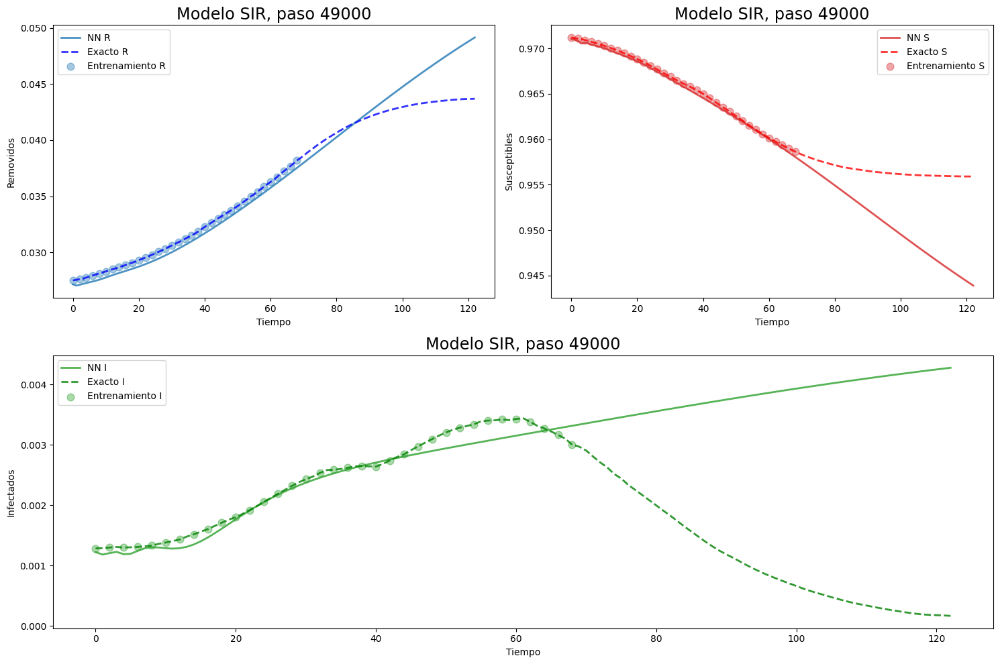

Paso = 49000 , pérdida de datos = 1.01762325e-07 , pérdida física = 2.1094393e-09 , pérdida total = 1.0387176e-07 , mse = 8.971068e-06 , beta = 0.071527325 , gamma = 0.059644822
Paso = 50000 , pérdida de datos = 9.990661e-09 , pérdida física = 1.9053514e-09 , pérdida total = 1.1896012e-08 , mse = 8.837127e-06 , beta = 0.07168685 , gamma = 0.05979872
Paso = 51000 , pérdida de datos = 9.822157e-09 , pérdida física = 1.8765496e-09 , pérdida total = 1.1698707e-08 , mse = 8.849894e-06 , beta = 0.07185341 , gamma = 0.060000796
Paso = 52000 , pérdida de datos = 1.8642735e-08 , pérdida física = 1.8467594e-09 , pérdida total = 2.0489495e-08 , mse = 9.099886e-06 , beta = 0.0718305 , gamma = 0.060046818
Paso = 53000 , pérdida de datos = 1.3400686e-08 , pérdida física = 1.8147335e-09 , pérdida total = 1.521542e-08 , mse = 8.656891e-06 , beta = 0.07208085 , gamma = 0.060325883
Paso = 54000 , pérdida de datos = 9.752379e-09 , pérdida física = 1.7501878e-09 , pérdida total = 1.1502567e-08 , mse = 8.7

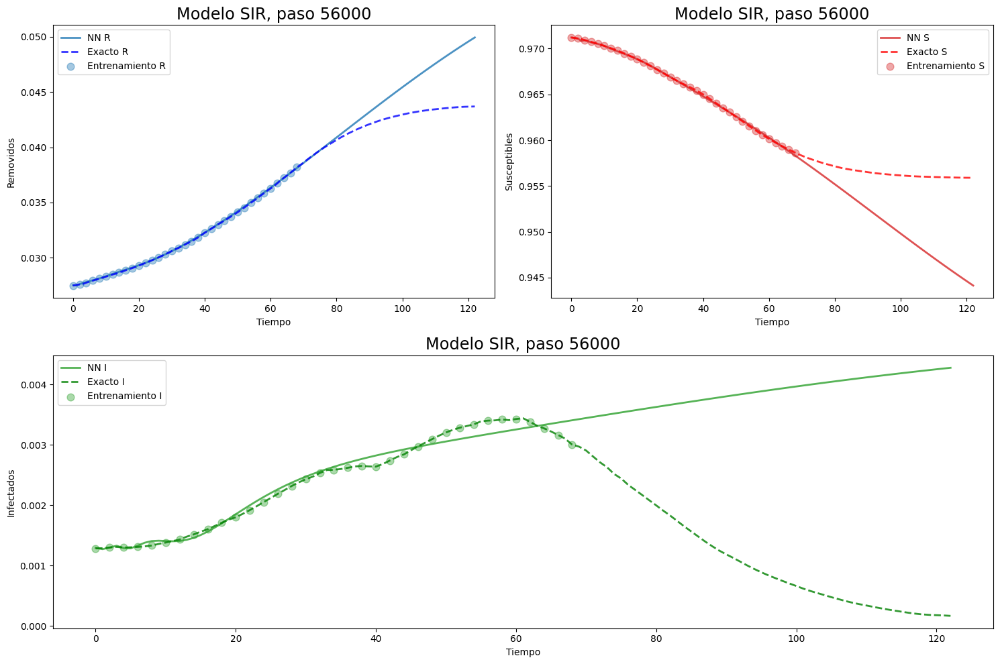

Paso = 56000 , pérdida de datos = 1.0219046e-08 , pérdida física = 1.705684e-09 , pérdida total = 1.192473e-08 , mse = 8.880643e-06 , beta = 0.07240626 , gamma = 0.060794838
Paso = 57000 , pérdida de datos = 3.344565e-08 , pérdida física = 1.7624365e-09 , pérdida total = 3.520809e-08 , mse = 9.3455055e-06 , beta = 0.07253614 , gamma = 0.06097417
Paso = 58000 , pérdida de datos = 1.5127167e-08 , pérdida física = 1.6824119e-09 , pérdida total = 1.680958e-08 , mse = 9.067364e-06 , beta = 0.07240635 , gamma = 0.0609162
Paso = 59000 , pérdida de datos = 9.710558e-09 , pérdida física = 1.614618e-09 , pérdida total = 1.13251755e-08 , mse = 8.7522e-06 , beta = 0.07276172 , gamma = 0.06127118
Paso = 60000 , pérdida de datos = 1.08208305e-08 , pérdida física = 1.5774915e-09 , pérdida total = 1.2398322e-08 , mse = 8.628162e-06 , beta = 0.0729094 , gamma = 0.06144829
Paso = 61000 , pérdida de datos = 9.6551345e-09 , pérdida física = 1.5528197e-09 , pérdida total = 1.1207954e-08 , mse = 8.73167e-06

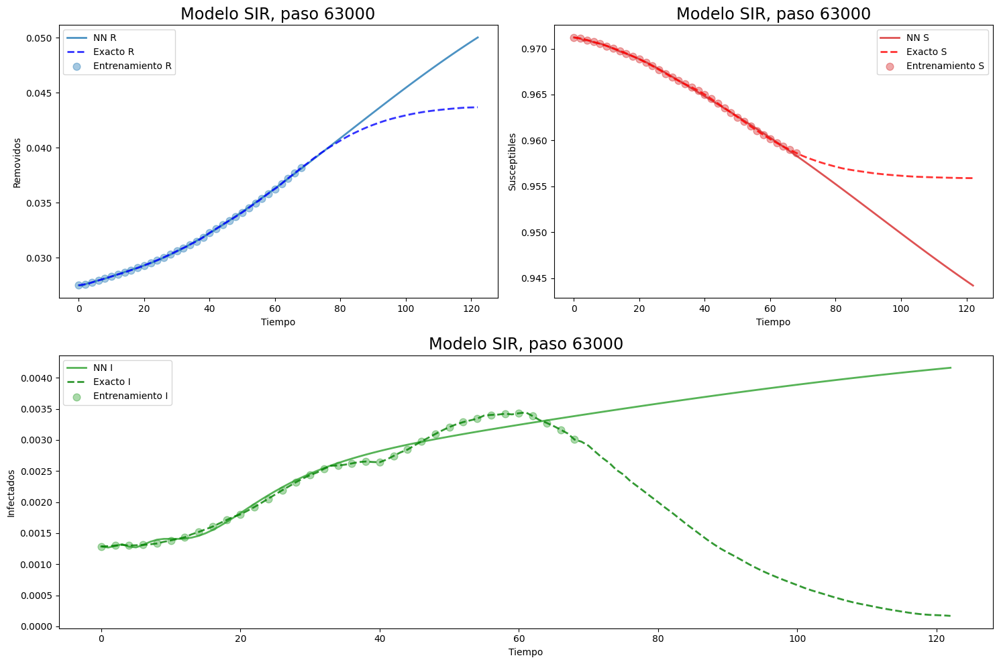

Paso = 63000 , pérdida de datos = 9.18139e-09 , pérdida física = 1.5060864e-09 , pérdida total = 1.0687476e-08 , mse = 8.750309e-06 , beta = 0.073193565 , gamma = 0.061859045
Paso = 64000 , pérdida de datos = 3.530243e-08 , pérdida física = 1.727813e-09 , pérdida total = 3.7030244e-08 , mse = 8.5908705e-06 , beta = 0.07280802 , gamma = 0.06159303
Paso = 65000 , pérdida de datos = 1.5837488e-08 , pérdida física = 1.4824538e-09 , pérdida total = 1.7319941e-08 , mse = 8.851468e-06 , beta = 0.07307587 , gamma = 0.061914142
Paso = 66000 , pérdida de datos = 9.0402255e-09 , pérdida física = 1.4446597e-09 , pérdida total = 1.0484885e-08 , mse = 8.69973e-06 , beta = 0.07350001 , gamma = 0.06229883
Paso = 67000 , pérdida de datos = 1.8955556e-07 , pérdida física = 1.969737e-09 , pérdida total = 1.915253e-07 , mse = 1.037233e-05 , beta = 0.073577896 , gamma = 0.06242078
Paso = 68000 , pérdida de datos = 6.887559e-08 , pérdida física = 1.971521e-09 , pérdida total = 7.0847115e-08 , mse = 8.054359

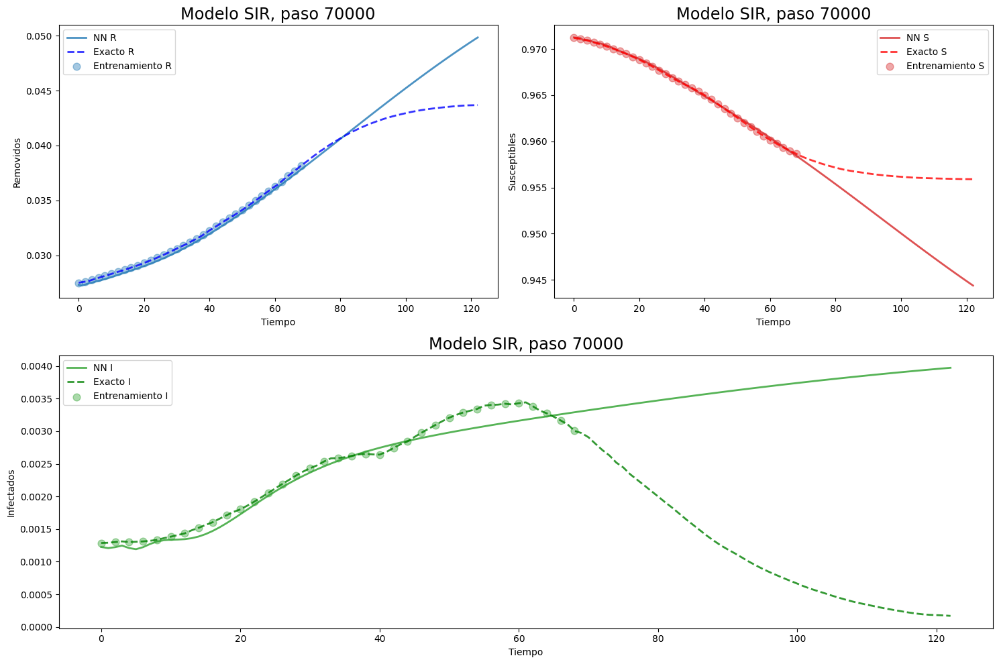

Paso = 70000 , pérdida de datos = 2.920878e-08 , pérdida física = 1.3761101e-09 , pérdida total = 3.058489e-08 , mse = 8.280513e-06 , beta = 0.073848814 , gamma = 0.062807925
Paso = 71000 , pérdida de datos = 5.3892446e-08 , pérdida física = 1.4940637e-09 , pérdida total = 5.538651e-08 , mse = 9.172883e-06 , beta = 0.073925585 , gamma = 0.06293406
Paso = 72000 , pérdida de datos = 2.1441938e-08 , pérdida física = 1.3898322e-09 , pérdida total = 2.283177e-08 , mse = 8.309422e-06 , beta = 0.07369075 , gamma = 0.06280553
Paso = 73000 , pérdida de datos = 2.7048966e-08 , pérdida física = 1.398734e-09 , pérdida total = 2.84477e-08 , mse = 8.963604e-06 , beta = 0.074052334 , gamma = 0.06314859
Paso = 74000 , pérdida de datos = 1.13206e-08 , pérdida física = 1.3107119e-09 , pérdida total = 1.2631311e-08 , mse = 8.4947e-06 , beta = 0.07410344 , gamma = 0.063206896
Paso = 75000 , pérdida de datos = 1.9690053e-07 , pérdida física = 2.2374314e-09 , pérdida total = 1.9913796e-07 , mse = 9.12606e-0

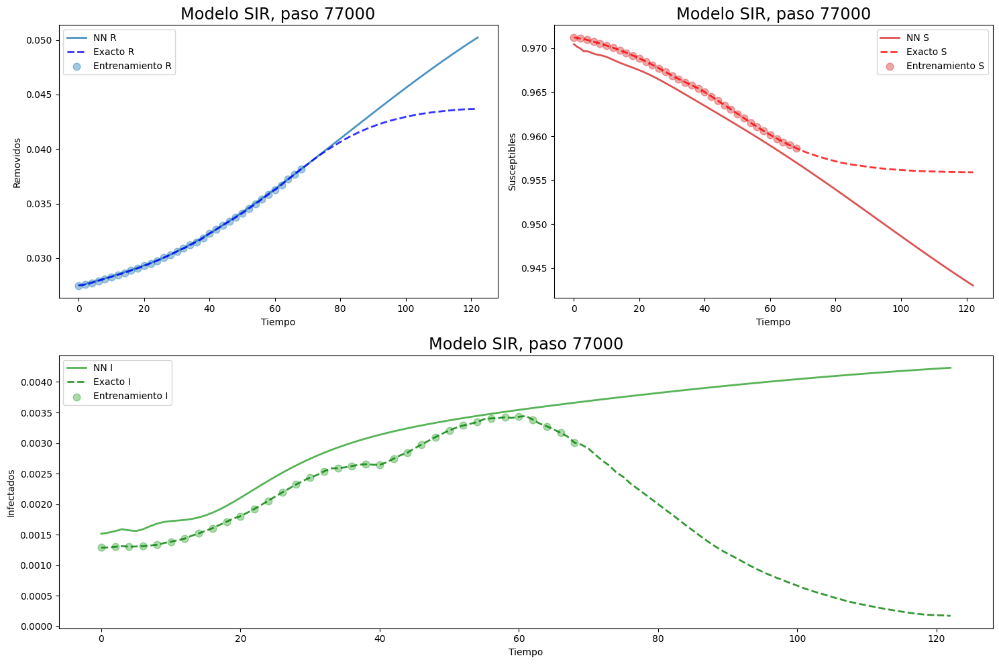

Paso = 77000 , pérdida de datos = 5.47189e-07 , pérdida física = 3.3892347e-09 , pérdida total = 5.5057825e-07 , mse = 1.15272405e-05 , beta = 0.07431318 , gamma = 0.06354833
Paso = 78000 , pérdida de datos = 1.3250177e-08 , pérdida física = 1.2658966e-09 , pérdida total = 1.4516074e-08 , mse = 8.221259e-06 , beta = 0.074032374 , gamma = 0.06338559
Paso = 79000 , pérdida de datos = 8.821198e-09 , pérdida física = 1.2696031e-09 , pérdida total = 1.0090801e-08 , mse = 8.363105e-06 , beta = 0.07437188 , gamma = 0.06371759
Paso = 80000 , pérdida de datos = 8.489135e-09 , pérdida física = 1.2738254e-09 , pérdida total = 9.76296e-09 , mse = 8.379059e-06 , beta = 0.074384466 , gamma = 0.06379495
Paso = 81000 , pérdida de datos = 2.0863295e-08 , pérdida física = 1.2556074e-09 , pérdida total = 2.2118902e-08 , mse = 7.908409e-06 , beta = 0.07443927 , gamma = 0.063848734
Paso = 82000 , pérdida de datos = 1.0059856e-08 , pérdida física = 1.2514287e-09 , pérdida total = 1.1311284e-08 , mse = 8.260

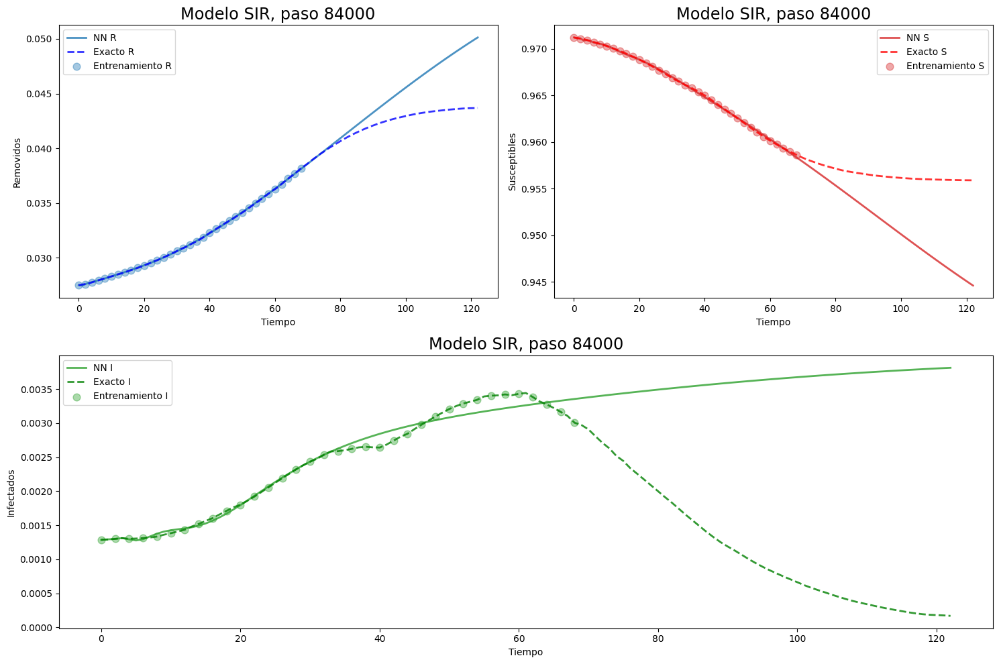

Paso = 84000 , pérdida de datos = 8.323035e-09 , pérdida física = 1.242936e-09 , pérdida total = 9.565971e-09 , mse = 8.199378e-06 , beta = 0.07462936 , gamma = 0.064197764
Paso = 85000 , pérdida de datos = 1.2686474e-08 , pérdida física = 1.2631266e-09 , pérdida total = 1.3949601e-08 , mse = 7.986168e-06 , beta = 0.07461623 , gamma = 0.06423617
Paso = 86000 , pérdida de datos = 3.1594883e-08 , pérdida física = 1.2831052e-09 , pérdida total = 3.287799e-08 , mse = 7.863471e-06 , beta = 0.07471829 , gamma = 0.064405024
Paso = 87000 , pérdida de datos = 3.7115946e-08 , pérdida física = 1.2750357e-09 , pérdida total = 3.8390983e-08 , mse = 7.635863e-06 , beta = 0.074817754 , gamma = 0.064567074
Paso = 88000 , pérdida de datos = 8.835757e-09 , pérdida física = 1.1954328e-09 , pérdida total = 1.003119e-08 , mse = 7.903459e-06 , beta = 0.074903466 , gamma = 0.064680174
Paso = 89000 , pérdida de datos = 8.208253e-09 , pérdida física = 1.1884499e-09 , pérdida total = 9.396703e-09 , mse = 8.0968

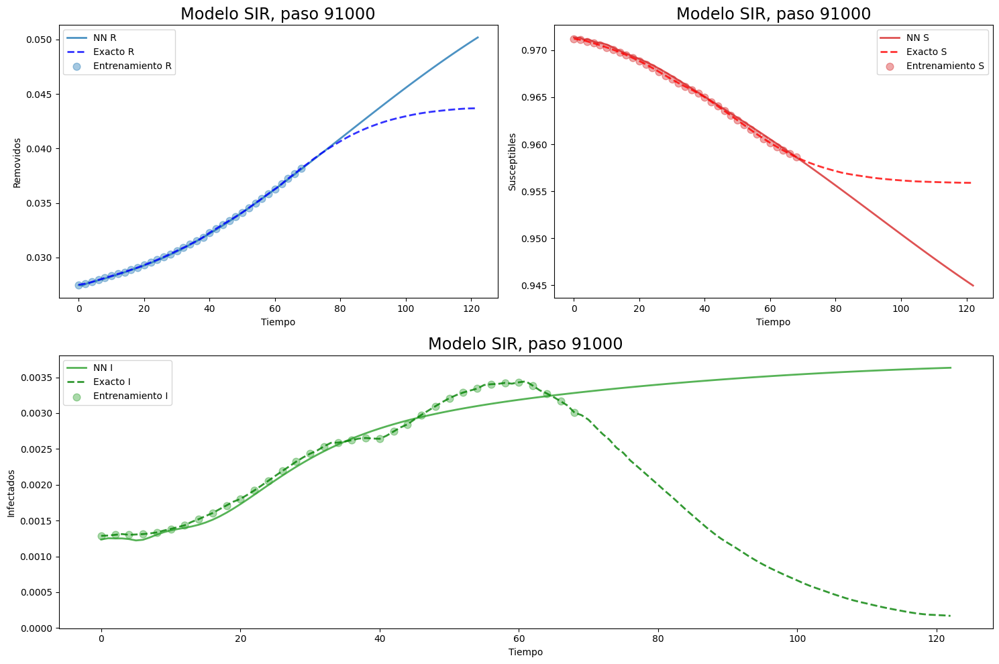

Paso = 91000 , pérdida de datos = 2.4775083e-08 , pérdida física = 1.1725697e-09 , pérdida total = 2.5947653e-08 , mse = 7.6278766e-06 , beta = 0.074935645 , gamma = 0.06493228
Paso = 92000 , pérdida de datos = 8.332826e-09 , pérdida física = 1.183573e-09 , pérdida total = 9.516399e-09 , mse = 8.038873e-06 , beta = 0.07516375 , gamma = 0.06515167
Paso = 93000 , pérdida de datos = 8.0732105e-09 , pérdida física = 1.1531766e-09 , pérdida total = 9.226387e-09 , mse = 8.04576e-06 , beta = 0.075282246 , gamma = 0.065279655
Paso = 94000 , pérdida de datos = 1.7660373e-07 , pérdida física = 1.5501416e-09 , pérdida total = 1.7815388e-07 , mse = 9.129711e-06 , beta = 0.07534959 , gamma = 0.06539452
Paso = 95000 , pérdida de datos = 8.040002e-09 , pérdida física = 1.1444659e-09 , pérdida total = 9.184468e-09 , mse = 8.009969e-06 , beta = 0.07540137 , gamma = 0.06548545
Paso = 96000 , pérdida de datos = 9.85528e-09 , pérdida física = 1.134926e-09 , pérdida total = 1.0990206e-08 , mse = 8.027308e-

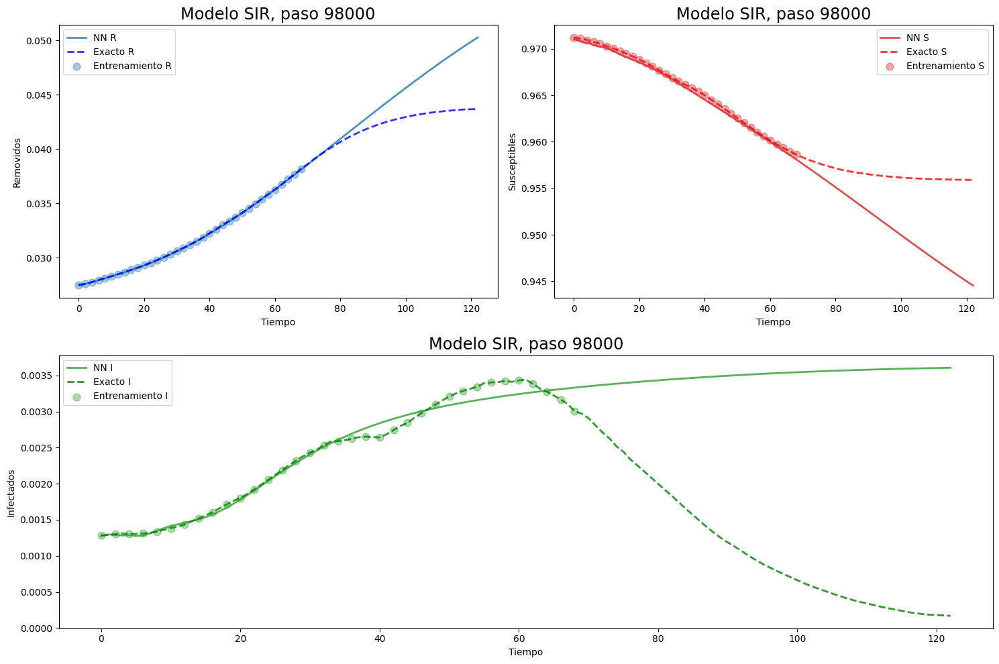

Paso = 98000 , pérdida de datos = 6.155467e-08 , pérdida física = 1.2457302e-09 , pérdida total = 6.28004e-08 , mse = 8.393597e-06 , beta = 0.07555886 , gamma = 0.06577493
Paso = 99000 , pérdida de datos = 7.7046565e-08 , pérdida física = 1.3321395e-09 , pérdida total = 7.8378704e-08 , mse = 7.9054735e-06 , beta = 0.07557781 , gamma = 0.06584524
Paso = 100000 , pérdida de datos = 8.863706e-09 , pérdida física = 1.1023465e-09 , pérdida total = 9.966053e-09 , mse = 7.81992e-06 , beta = 0.07563737 , gamma = 0.06594121
Paso = 101000 , pérdida de datos = 2.8266444e-07 , pérdida física = 1.7445965e-09 , pérdida total = 2.8440905e-07 , mse = 9.070791e-06 , beta = 0.075709 , gamma = 0.066048376
Paso = 102000 , pérdida de datos = 3.5664247e-08 , pérdida física = 1.1849652e-09 , pérdida total = 3.684921e-08 , mse = 7.982601e-06 , beta = 0.07573064 , gamma = 0.06611126
Paso = 103000 , pérdida de datos = 4.2073182e-07 , pérdida física = 2.2590934e-09 , pérdida total = 4.2299092e-07 , mse = 6.87362

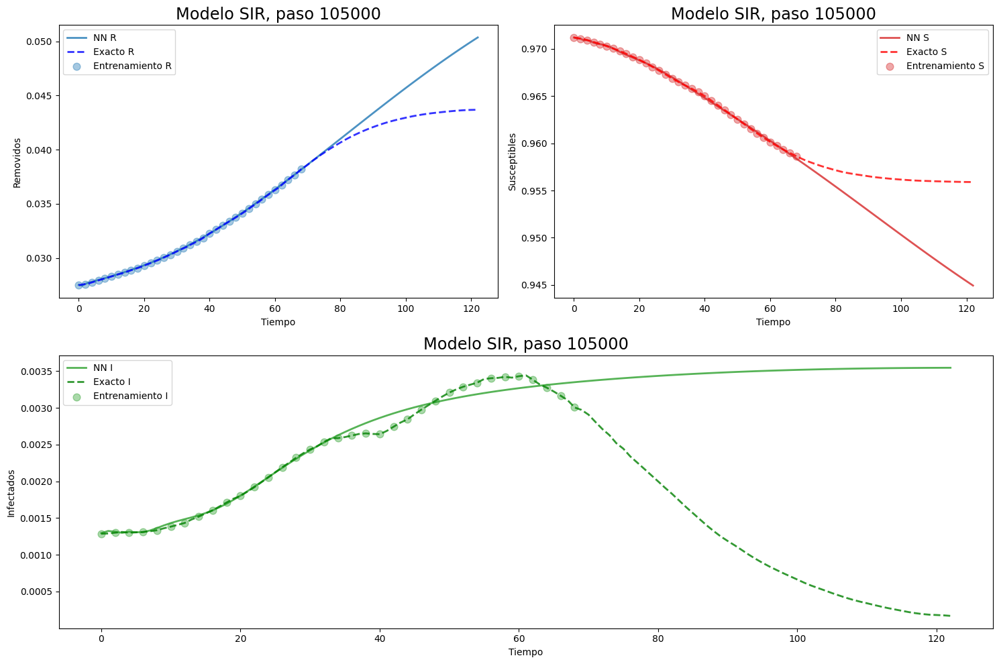

Paso = 105000 , pérdida de datos = 1.11816085e-08 , pérdida física = 1.0940872e-09 , pérdida total = 1.2275696e-08 , mse = 7.8619005e-06 , beta = 0.07588691 , gamma = 0.06634586
Paso = 106000 , pérdida de datos = 1.6779626e-07 , pérdida física = 1.725886e-09 , pérdida total = 1.6952214e-07 , mse = 9.021133e-06 , beta = 0.07582489 , gamma = 0.06638561
Paso = 107000 , pérdida de datos = 2.9626317e-08 , pérdida física = 1.1357884e-09 , pérdida total = 3.0762106e-08 , mse = 8.094979e-06 , beta = 0.07594046 , gamma = 0.066515
Paso = 108000 , pérdida de datos = 1.2794816e-08 , pérdida física = 1.1708478e-09 , pérdida total = 1.3965663e-08 , mse = 7.5972234e-06 , beta = 0.07571411 , gamma = 0.066402644
Paso = 109000 , pérdida de datos = 1.9347505e-08 , pérdida física = 1.1002005e-09 , pérdida total = 2.0447706e-08 , mse = 8.244715e-06 , beta = 0.07600316 , gamma = 0.066669576
Paso = 110000 , pérdida de datos = 8.626358e-09 , pérdida física = 1.0842462e-09 , pérdida total = 9.710605e-09 , mse 

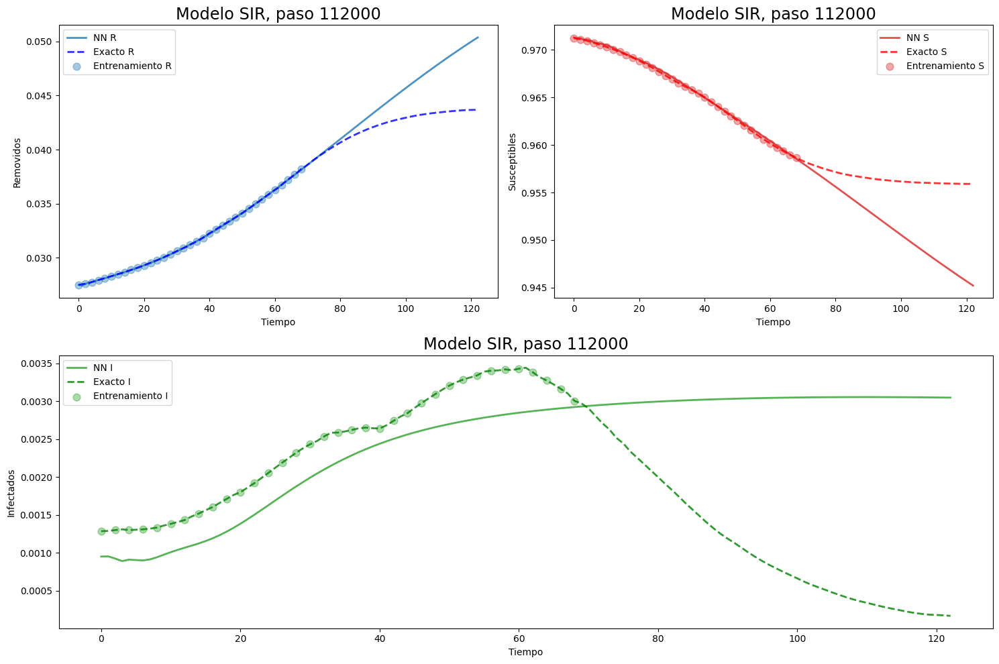

Paso = 112000 , pérdida de datos = 4.8119283e-08 , pérdida física = 2.003651e-09 , pérdida total = 5.0122935e-08 , mse = 7.2521207e-06 , beta = 0.07609499 , gamma = 0.06685835
Paso = 113000 , pérdida de datos = 1.2421337e-08 , pérdida física = 1.1125986e-09 , pérdida total = 1.3533936e-08 , mse = 7.537158e-06 , beta = 0.07613068 , gamma = 0.066938266
Paso = 114000 , pérdida de datos = 1.3407984e-07 , pérdida física = 1.3371009e-09 , pérdida total = 1.3541694e-07 , mse = 8.820185e-06 , beta = 0.07617473 , gamma = 0.067017846
Paso = 115000 , pérdida de datos = 7.43978e-09 , pérdida física = 1.0716876e-09 , pérdida total = 8.511467e-09 , mse = 7.639505e-06 , beta = 0.07618306 , gamma = 0.067085475
Paso = 116000 , pérdida de datos = 2.5536645e-08 , pérdida física = 1.1169714e-09 , pérdida total = 2.6653616e-08 , mse = 8.299141e-06 , beta = 0.076216556 , gamma = 0.06714574
Paso = 117000 , pérdida de datos = 2.7983248e-08 , pérdida física = 1.1000141e-09 , pérdida total = 2.9083262e-08 , mse

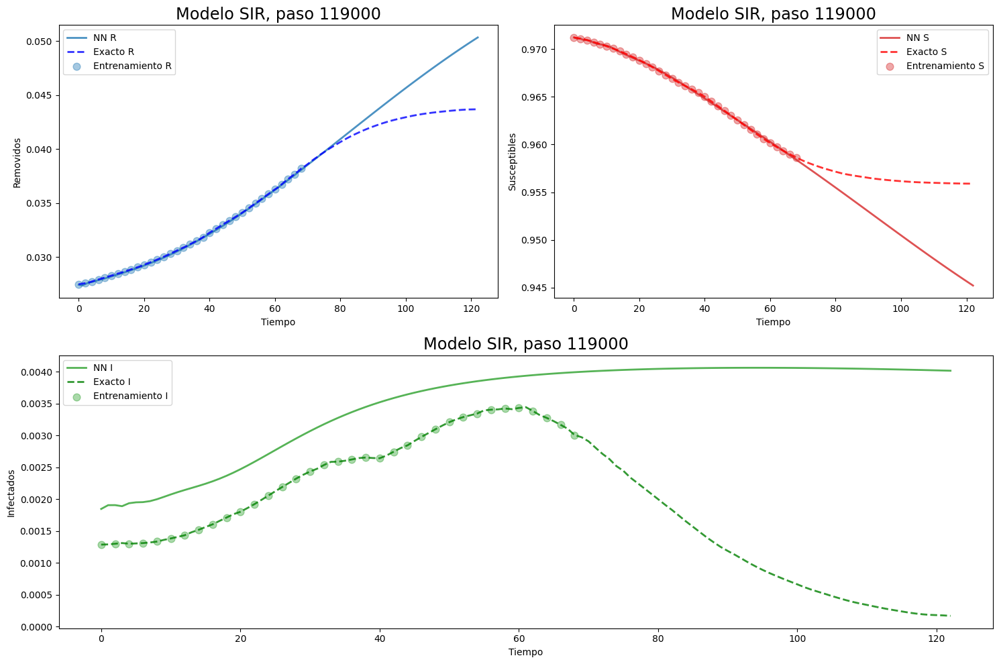

Paso = 119000 , pérdida de datos = 1.4660435e-07 , pérdida física = 5.478401e-09 , pérdida total = 1.5208275e-07 , mse = 8.0360205e-06 , beta = 0.07622194 , gamma = 0.067268275
Paso = 120000 , pérdida de datos = 7.3682473e-09 , pérdida física = 1.0666429e-09 , pérdida total = 8.43489e-09 , mse = 7.4547784e-06 , beta = 0.07631508 , gamma = 0.06738677
Paso = 121000 , pérdida de datos = 2.2294147e-08 , pérdida física = 1.0889118e-09 , pérdida total = 2.3383059e-08 , mse = 7.202206e-06 , beta = 0.0762063 , gamma = 0.06733405
Paso = 122000 , pérdida de datos = 9.594011e-09 , pérdida física = 1.067957e-09 , pérdida total = 1.0661968e-08 , mse = 7.2688977e-06 , beta = 0.07631718 , gamma = 0.06748152
Paso = 123000 , pérdida de datos = 1.8961499e-08 , pérdida física = 1.5330618e-09 , pérdida total = 2.049456e-08 , mse = 7.4722957e-06 , beta = 0.0757588 , gamma = 0.06703199
Paso = 124000 , pérdida de datos = 8.498784e-09 , pérdida física = 1.0676467e-09 , pérdida total = 9.56643e-09 , mse = 7.29

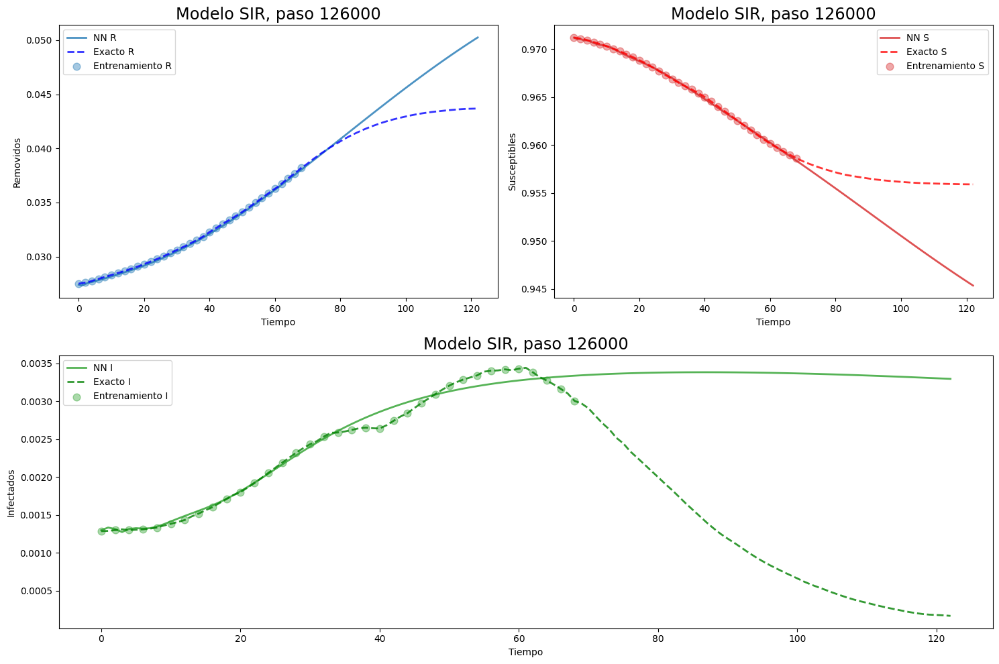

Paso = 126000 , pérdida de datos = 1.1587182e-08 , pérdida física = 1.0800296e-09 , pérdida total = 1.2667211e-08 , mse = 7.296463e-06 , beta = 0.07645889 , gamma = 0.067777626
Paso = 127000 , pérdida de datos = 9.62547e-09 , pérdida física = 1.1767629e-09 , pérdida total = 1.0802233e-08 , mse = 7.3845003e-06 , beta = 0.076122686 , gamma = 0.067526266
Paso = 128000 , pérdida de datos = 1.1261318e-08 , pérdida física = 1.1502523e-09 , pérdida total = 1.241157e-08 , mse = 7.2856974e-06 , beta = 0.076491274 , gamma = 0.06788693
Paso = 129000 , pérdida de datos = 9.621999e-09 , pérdida física = 1.0770728e-09 , pérdida total = 1.0699072e-08 , mse = 7.0877427e-06 , beta = 0.07652041 , gamma = 0.06794711
Paso = 130000 , pérdida de datos = 1.41051e-08 , pérdida física = 1.0821356e-09 , pérdida total = 1.5187236e-08 , mse = 6.930028e-06 , beta = 0.0765457 , gamma = 0.06802067
Paso = 131000 , pérdida de datos = 8.371943e-09 , pérdida física = 1.0769812e-09 , pérdida total = 9.448924e-09 , mse = 

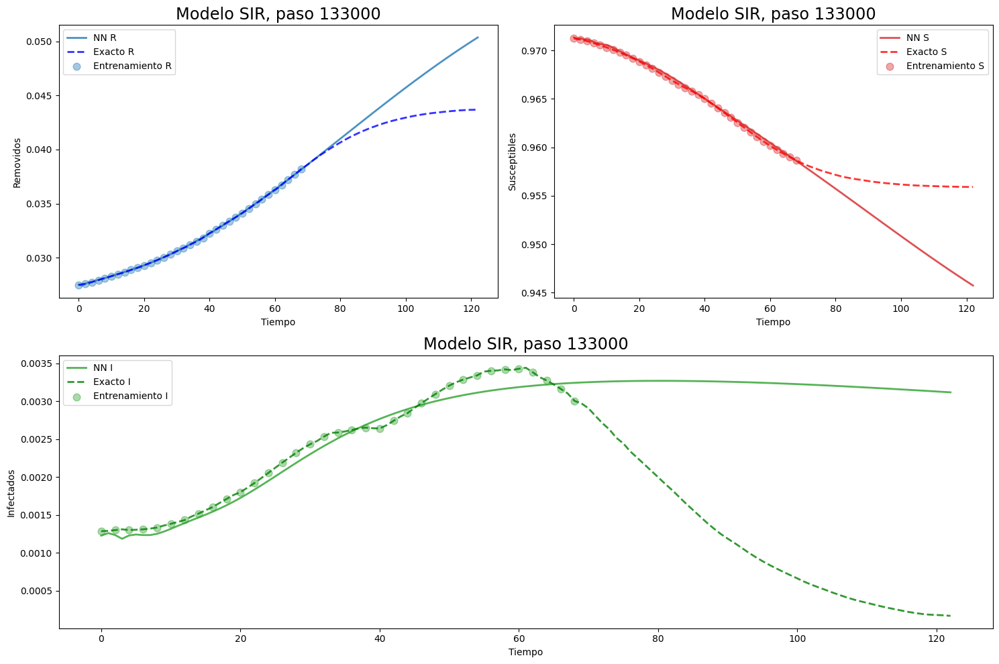

Paso = 133000 , pérdida de datos = 1.3213377e-08 , pérdida física = 1.0972945e-09 , pérdida total = 1.4310672e-08 , mse = 6.8475715e-06 , beta = 0.07636147 , gamma = 0.06795912
Paso = 134000 , pérdida de datos = 7.6232896e-09 , pérdida física = 1.0923965e-09 , pérdida total = 8.715686e-09 , mse = 7.0463107e-06 , beta = 0.07659431 , gamma = 0.06823557
Paso = 135000 , pérdida de datos = 7.124358e-09 , pérdida física = 1.0807719e-09 , pérdida total = 8.20513e-09 , mse = 7.0366027e-06 , beta = 0.076583855 , gamma = 0.06825505
Paso = 136000 , pérdida de datos = 1.13765966e-08 , pérdida física = 1.0883077e-09 , pérdida total = 1.2464904e-08 , mse = 6.9642383e-06 , beta = 0.07662037 , gamma = 0.068328716
Paso = 137000 , pérdida de datos = 3.820514e-08 , pérdida física = 1.971885e-09 , pérdida total = 4.0177024e-08 , mse = 6.853078e-06 , beta = 0.076606594 , gamma = 0.06837213
Paso = 138000 , pérdida de datos = 8.195104e-09 , pérdida física = 1.1231931e-09 , pérdida total = 9.318297e-09 , mse 

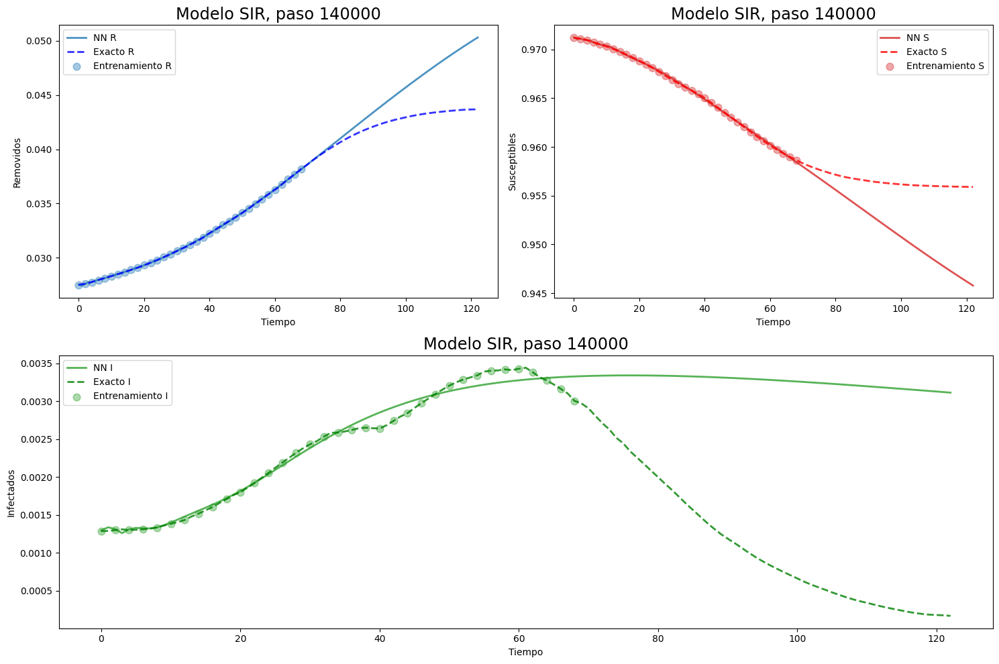

Paso = 140000 , pérdida de datos = 6.9209083e-09 , pérdida física = 1.1080589e-09 , pérdida total = 8.028967e-09 , mse = 6.8816257e-06 , beta = 0.076350376 , gamma = 0.06824725
Paso = 141000 , pérdida de datos = 3.5928068e-08 , pérdida física = 1.1287866e-09 , pérdida total = 3.7056854e-08 , mse = 6.8447134e-06 , beta = 0.07625696 , gamma = 0.068222165
Paso = 142000 , pérdida de datos = 7.4299216e-09 , pérdida física = 1.1108925e-09 , pérdida total = 8.540814e-09 , mse = 6.810954e-06 , beta = 0.07641465 , gamma = 0.06839332
Paso = 143000 , pérdida de datos = 7.059164e-09 , pérdida física = 1.0976591e-09 , pérdida total = 8.156823e-09 , mse = 6.7427295e-06 , beta = 0.07595303 , gamma = 0.068016745
Paso = 144000 , pérdida de datos = 6.6154784e-09 , pérdida física = 1.0989339e-09 , pérdida total = 7.714412e-09 , mse = 6.7386077e-06 , beta = 0.076568715 , gamma = 0.068628274
Paso = 145000 , pérdida de datos = 1.1056343e-08 , pérdida física = 1.117518e-09 , pérdida total = 1.2173861e-08 , m

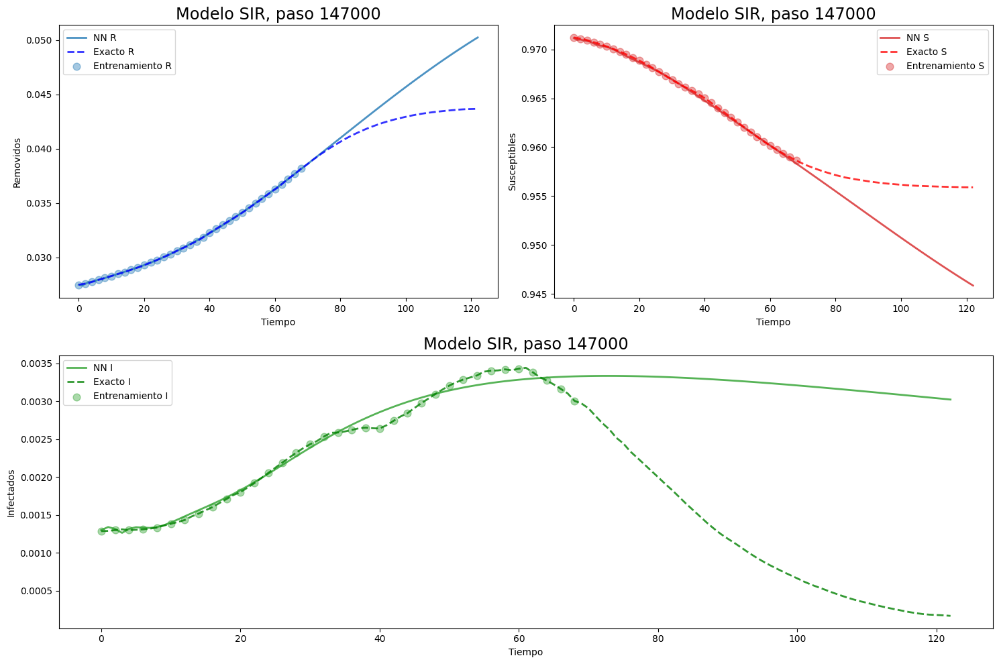

Paso = 147000 , pérdida de datos = 1.40530565e-08 , pérdida física = 1.1228312e-09 , pérdida total = 1.5175887e-08 , mse = 6.8254967e-06 , beta = 0.0766013 , gamma = 0.068763144
Paso = 148000 , pérdida de datos = 6.912569e-09 , pérdida física = 1.1014154e-09 , pérdida total = 8.013984e-09 , mse = 6.638474e-06 , beta = 0.07638594 , gamma = 0.06862309
Paso = 149000 , pérdida de datos = 7.714813e-09 , pérdida física = 1.1058124e-09 , pérdida total = 8.820625e-09 , mse = 6.6510097e-06 , beta = 0.07658259 , gamma = 0.0688319
Paso = 150000 , pérdida de datos = 8.116051e-09 , pérdida física = 1.115244e-09 , pérdida total = 9.231295e-09 , mse = 6.6441517e-06 , beta = 0.076530315 , gamma = 0.06881585
Paso = 151000 , pérdida de datos = 1.697977e-07 , pérdida física = 1.6186251e-09 , pérdida total = 1.7141633e-07 , mse = 7.235941e-06 , beta = 0.0764342 , gamma = 0.06878649
Paso = 152000 , pérdida de datos = 1.2402877e-07 , pérdida física = 1.3209225e-09 , pérdida total = 1.253497e-07 , mse = 7.50

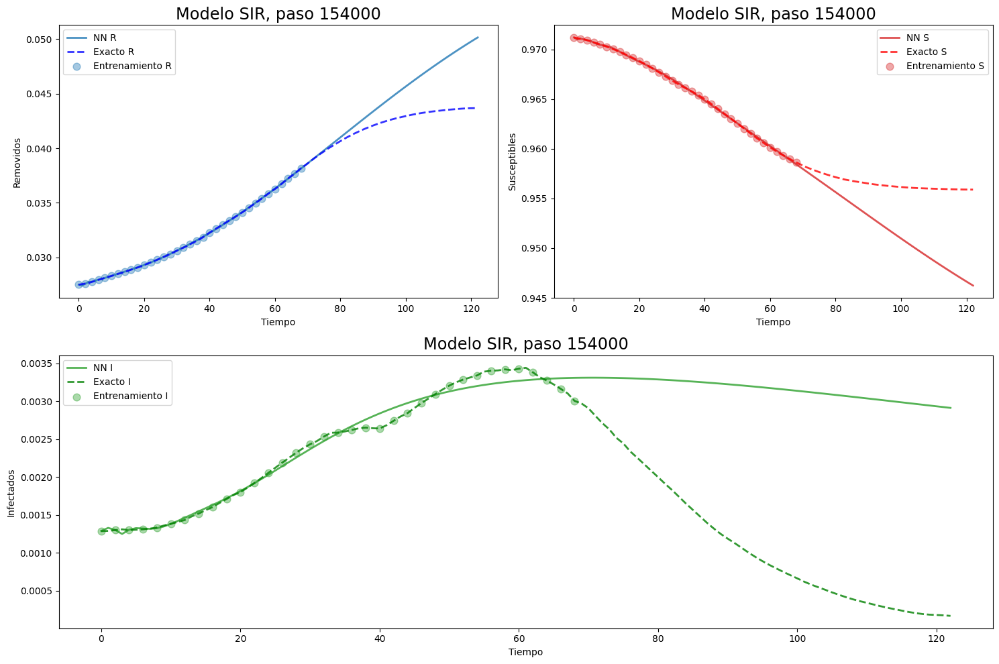

Paso = 154000 , pérdida de datos = 6.316906e-09 , pérdida física = 1.1141084e-09 , pérdida total = 7.4310145e-09 , mse = 6.370286e-06 , beta = 0.07647103 , gamma = 0.068956986
Paso = 155000 , pérdida de datos = 2.9385065e-08 , pérdida física = 1.8343937e-09 , pérdida total = 3.1219457e-08 , mse = 6.511741e-06 , beta = 0.07642922 , gamma = 0.06893446
Paso = 156000 , pérdida de datos = 6.414785e-09 , pérdida física = 1.1136566e-09 , pérdida total = 7.528442e-09 , mse = 6.2851686e-06 , beta = 0.07640443 , gamma = 0.068930656
Paso = 157000 , pérdida de datos = 3.5485364e-08 , pérdida física = 1.2639322e-09 , pérdida total = 3.6749295e-08 , mse = 6.1110704e-06 , beta = 0.07641308 , gamma = 0.06901644
Paso = 158000 , pérdida de datos = 4.4601656e-08 , pérdida física = 1.3048016e-09 , pérdida total = 4.5906457e-08 , mse = 6.892984e-06 , beta = 0.07630745 , gamma = 0.06895623
Paso = 159000 , pérdida de datos = 6.5843917e-09 , pérdida física = 1.135066e-09 , pérdida total = 7.719458e-09 , mse =

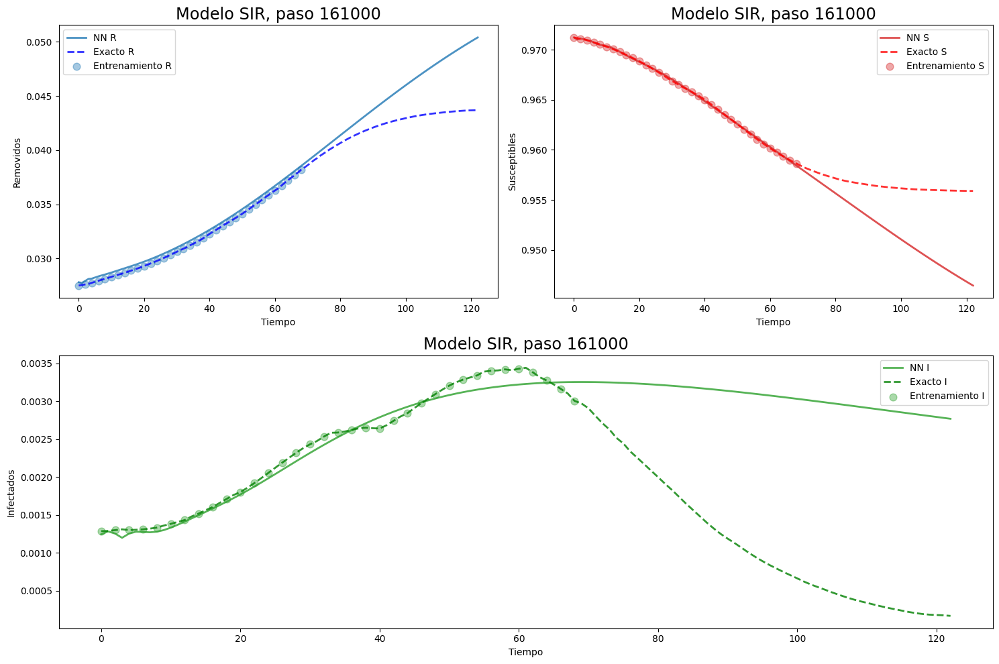

Paso = 161000 , pérdida de datos = 2.6608951e-08 , pérdida física = 1.1779767e-09 , pérdida total = 2.7786928e-08 , mse = 6.4050587e-06 , beta = 0.07625752 , gamma = 0.06899601
Paso = 162000 , pérdida de datos = 3.1113518e-07 , pérdida física = 1.7870638e-09 , pérdida total = 3.1292225e-07 , mse = 5.2065316e-06 , beta = 0.07614741 , gamma = 0.068934254
Paso = 163000 , pérdida de datos = 7.9590246e-09 , pérdida física = 1.1259775e-09 , pérdida total = 9.085002e-09 , mse = 5.970725e-06 , beta = 0.07625934 , gamma = 0.06903515
Paso = 164000 , pérdida de datos = 1.4750048e-08 , pérdida física = 1.1450356e-09 , pérdida total = 1.5895084e-08 , mse = 5.4810953e-06 , beta = 0.07620515 , gamma = 0.06904286
Paso = 165000 , pérdida de datos = 1.3000213e-08 , pérdida física = 1.2067104e-09 , pérdida total = 1.4206924e-08 , mse = 5.848543e-06 , beta = 0.075767525 , gamma = 0.06864425
Paso = 166000 , pérdida de datos = 5.620921e-08 , pérdida física = 2.5336075e-09 , pérdida total = 5.8742817e-08 , m

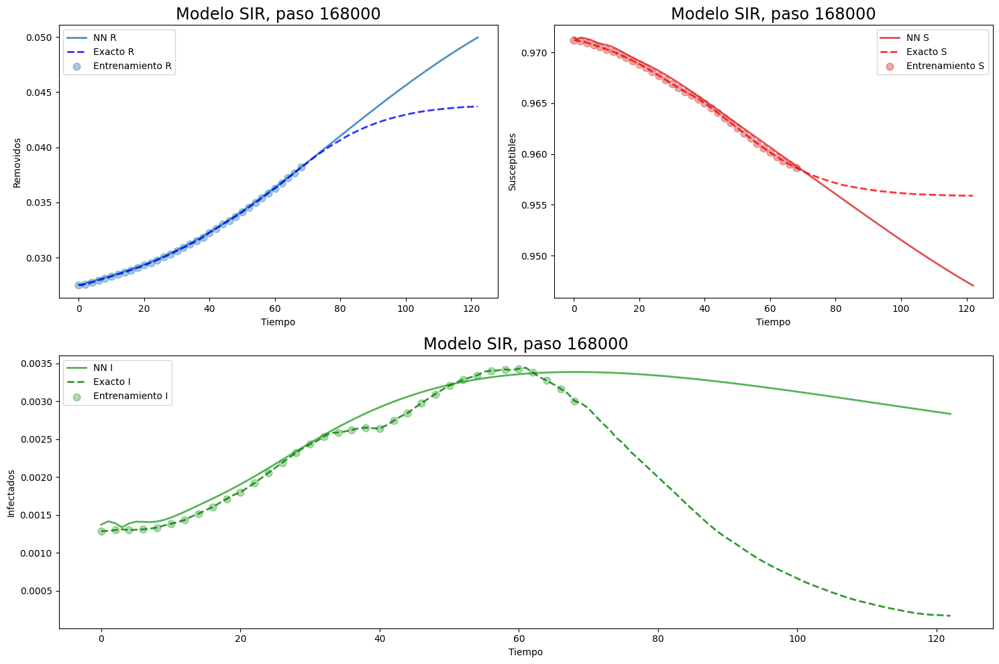

Paso = 168000 , pérdida de datos = 4.471222e-08 , pérdida física = 1.2742677e-09 , pérdida total = 4.5986486e-08 , mse = 5.5107007e-06 , beta = 0.07604419 , gamma = 0.06898119
Paso = 169000 , pérdida de datos = 6.347546e-09 , pérdida física = 1.1416178e-09 , pérdida total = 7.489164e-09 , mse = 5.855967e-06 , beta = 0.0761167 , gamma = 0.06909229
Paso = 170000 , pérdida de datos = 6.062699e-09 , pérdida física = 1.1170107e-09 , pérdida total = 7.1797093e-09 , mse = 5.8914134e-06 , beta = 0.076117165 , gamma = 0.069073685
Paso = 171000 , pérdida de datos = 1.135866e-08 , pérdida física = 1.1192186e-09 , pérdida total = 1.2477878e-08 , mse = 5.566557e-06 , beta = 0.07610831 , gamma = 0.069081426
Paso = 172000 , pérdida de datos = 6.3742718e-09 , pérdida física = 1.1335819e-09 , pérdida total = 7.507854e-09 , mse = 5.7489237e-06 , beta = 0.07596263 , gamma = 0.06901067
Paso = 173000 , pérdida de datos = 3.8013898e-08 , pérdida física = 1.255806e-09 , pérdida total = 3.9269704e-08 , mse = 

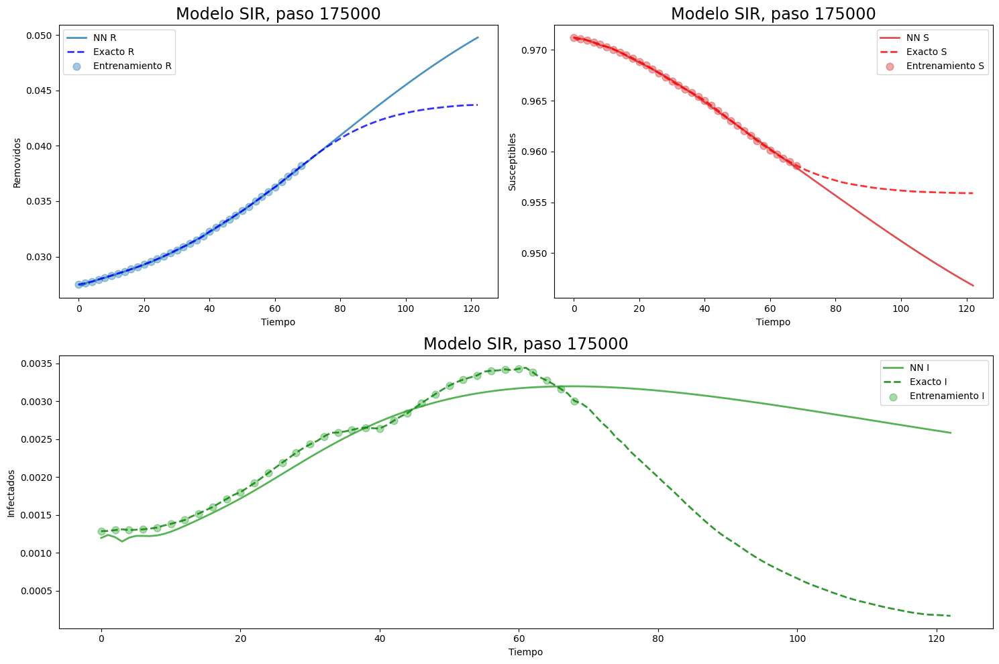

Paso = 175000 , pérdida de datos = 8.269031e-09 , pérdida física = 1.1628823e-09 , pérdida total = 9.431913e-09 , mse = 5.6505883e-06 , beta = 0.07579424 , gamma = 0.06892017
Paso = 176000 , pérdida de datos = 1.0495251e-07 , pérdida física = 1.4503307e-09 , pérdida total = 1.06402844e-07 , mse = 6.502744e-06 , beta = 0.07586214 , gamma = 0.06900021
Paso = 177000 , pérdida de datos = 1.551859e-08 , pérdida física = 1.1323569e-09 , pérdida total = 1.6650947e-08 , mse = 5.4901157e-06 , beta = 0.0757244 , gamma = 0.0688779
Paso = 178000 , pérdida de datos = 5.591107e-08 , pérdida física = 1.3044079e-09 , pérdida total = 5.7215477e-08 , mse = 6.1000133e-06 , beta = 0.07587975 , gamma = 0.06910196
Paso = 179000 , pérdida de datos = 9.2224575e-09 , pérdida física = 1.1279621e-09 , pérdida total = 1.0350419e-08 , mse = 5.674281e-06 , beta = 0.07589213 , gamma = 0.06911406
Paso = 180000 , pérdida de datos = 2.8393675e-08 , pérdida física = 1.3102099e-09 , pérdida total = 2.9703886e-08 , mse = 

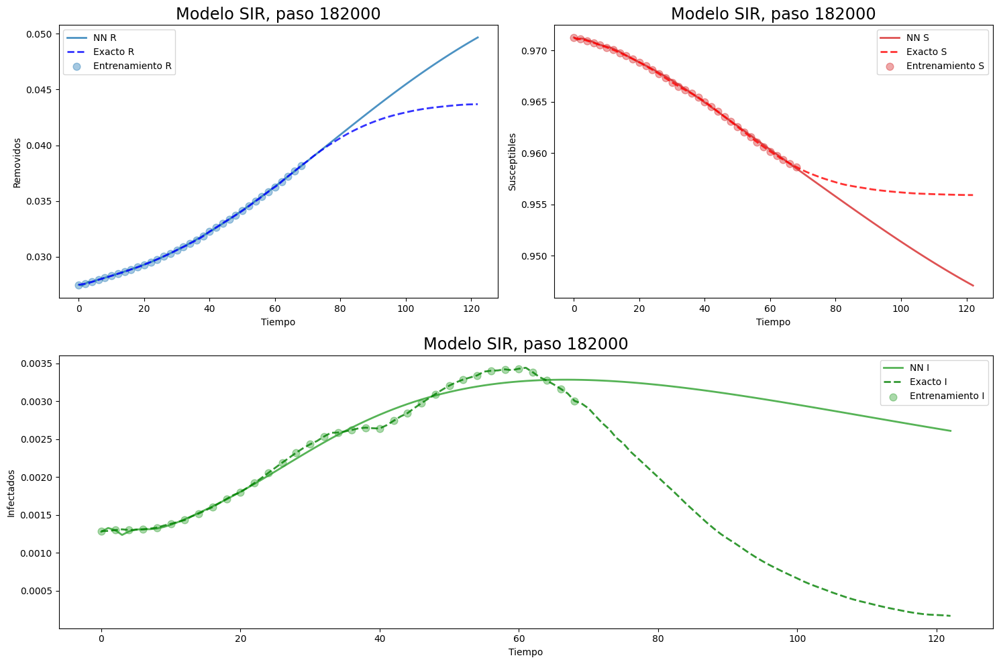

Paso = 182000 , pérdida de datos = 7.553711e-09 , pérdida física = 1.1297459e-09 , pérdida total = 8.6834575e-09 , mse = 5.406468e-06 , beta = 0.075447306 , gamma = 0.06872015
Paso = 183000 , pérdida de datos = 5.9497234e-09 , pérdida física = 1.1250408e-09 , pérdida total = 7.0747643e-09 , mse = 5.5244427e-06 , beta = 0.07588731 , gamma = 0.06912259
Paso = 184000 , pérdida de datos = 1.0432947e-08 , pérdida física = 1.1295149e-09 , pérdida total = 1.1562462e-08 , mse = 5.3316057e-06 , beta = 0.07507894 , gamma = 0.06840068
Paso = 185000 , pérdida de datos = 5.9039067e-09 , pérdida física = 1.1289462e-09 , pérdida total = 7.032853e-09 , mse = 5.400883e-06 , beta = 0.07579111 , gamma = 0.06913577
Paso = 186000 , pérdida de datos = 2.5594927e-08 , pérdida física = 1.1600303e-09 , pérdida total = 2.6754957e-08 , mse = 5.262005e-06 , beta = 0.07574613 , gamma = 0.06910802
Paso = 187000 , pérdida de datos = 8.9002645e-09 , pérdida física = 1.1422638e-09 , pérdida total = 1.0042529e-08 , mse

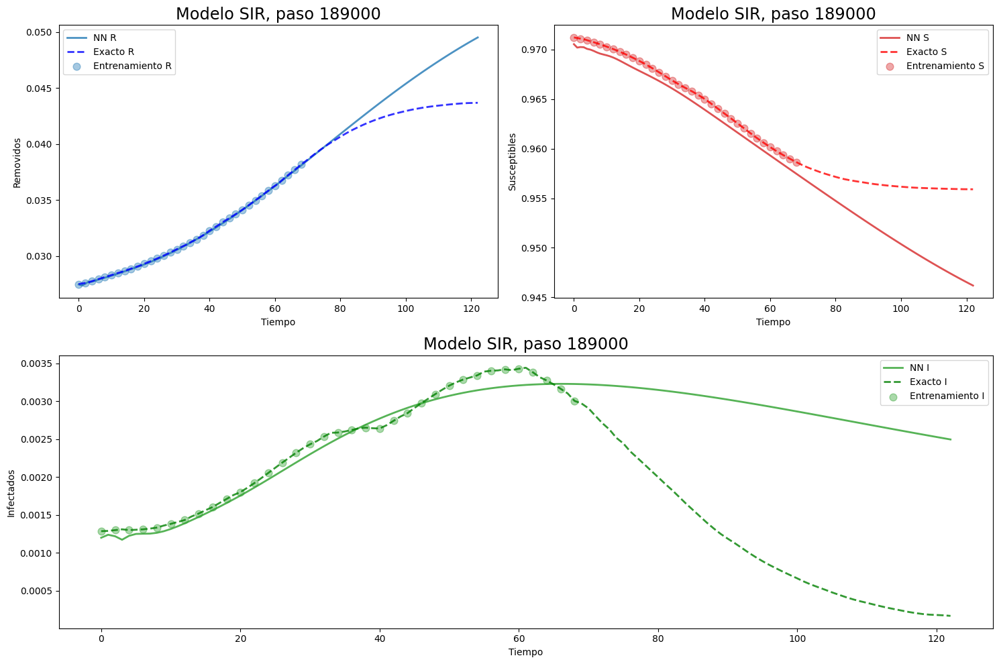

Paso = 189000 , pérdida de datos = 6.141621e-07 , pérdida física = 2.1601927e-09 , pérdida total = 6.163223e-07 , mse = 6.758036e-06 , beta = 0.07554062 , gamma = 0.06899863
Paso = 190000 , pérdida de datos = 1.3530094e-08 , pérdida física = 1.2701727e-09 , pérdida total = 1.4800267e-08 , mse = 4.9624314e-06 , beta = 0.075409465 , gamma = 0.06884662
Paso = 191000 , pérdida de datos = 1.6495508e-07 , pérdida física = 1.3677219e-09 , pérdida total = 1.663228e-07 , mse = 6.422161e-06 , beta = 0.07536426 , gamma = 0.068878725
Paso = 192000 , pérdida de datos = 7.041844e-09 , pérdida física = 1.13705e-09 , pérdida total = 8.178894e-09 , mse = 5.2843666e-06 , beta = 0.075648054 , gamma = 0.06901716
Paso = 193000 , pérdida de datos = 1.2350266e-07 , pérdida física = 1.2461894e-09 , pérdida total = 1.2474885e-07 , mse = 5.146458e-06 , beta = 0.07555859 , gamma = 0.068978526
Paso = 194000 , pérdida de datos = 6.017939e-09 , pérdida física = 1.140141e-09 , pérdida total = 7.15808e-09 , mse = 5.1

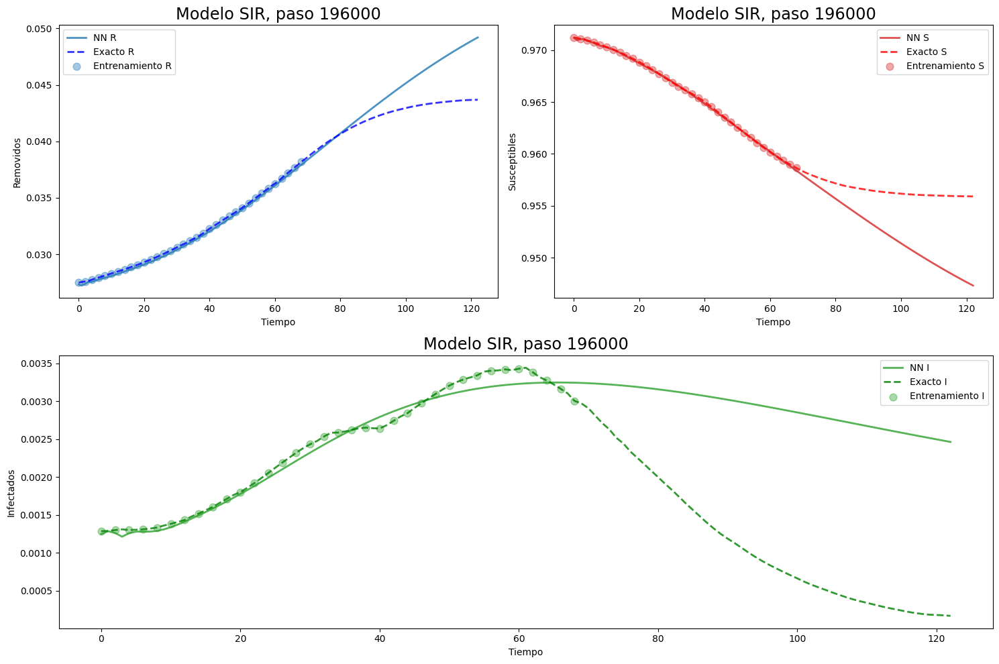

Paso = 196000 , pérdida de datos = 2.3812438e-08 , pérdida física = 1.1482806e-09 , pérdida total = 2.496072e-08 , mse = 5.035362e-06 , beta = 0.07544506 , gamma = 0.06897258
Paso = 197000 , pérdida de datos = 2.2976627e-07 , pérdida física = 1.4500166e-09 , pérdida total = 2.3121629e-07 , mse = 4.3755754e-06 , beta = 0.07523063 , gamma = 0.06881432
Paso = 198000 , pérdida de datos = 8.0321785e-09 , pérdida física = 1.1481698e-09 , pérdida total = 9.180348e-09 , mse = 5.0122544e-06 , beta = 0.0754572 , gamma = 0.068905346
Paso = 199000 , pérdida de datos = 8.6904235e-09 , pérdida física = 1.192744e-09 , pérdida total = 9.883167e-09 , mse = 5.171723e-06 , beta = 0.075400814 , gamma = 0.06897244
Paso = 200000 , pérdida de datos = 5.5455947e-09 , pérdida física = 1.1544885e-09 , pérdida total = 6.700083e-09 , mse = 5.051127e-06 , beta = 0.07498676 , gamma = 0.068609245
Paso = 201000 , pérdida de datos = 8.660241e-08 , pérdida física = 3.4600287e-09 , pérdida total = 9.006244e-08 , mse = 4

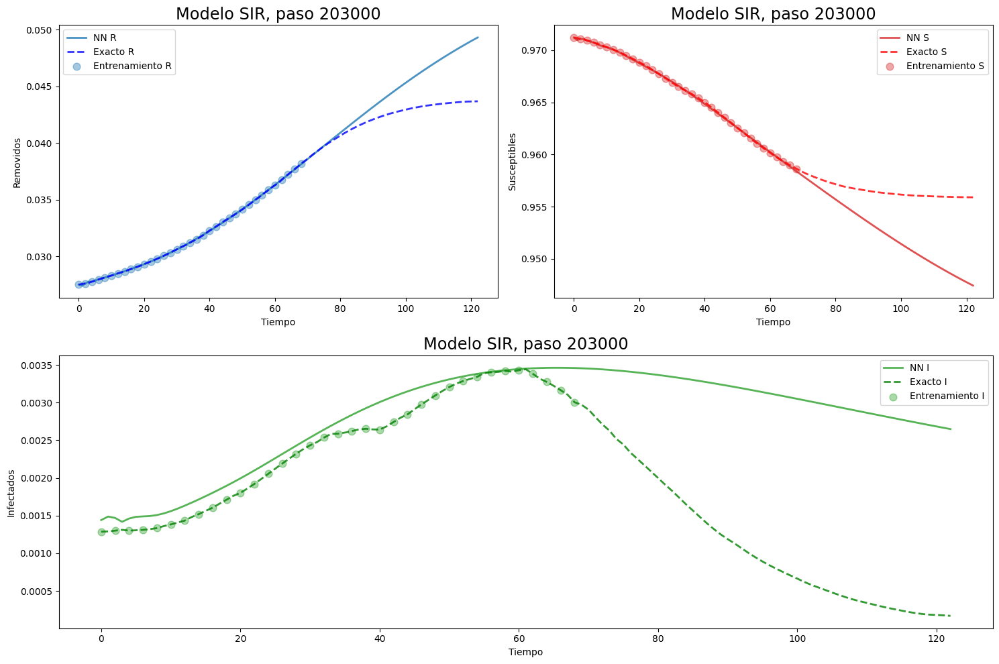

Paso = 203000 , pérdida de datos = 2.1231232e-08 , pérdida física = 1.6986447e-09 , pérdida total = 2.2929877e-08 , mse = 5.1351676e-06 , beta = 0.074893504 , gamma = 0.068559
Paso = 204000 , pérdida de datos = 1.417816e-07 , pérdida física = 5.3971e-09 , pérdida total = 1.471787e-07 , mse = 5.3639455e-06 , beta = 0.07519869 , gamma = 0.06884088
Paso = 205000 , pérdida de datos = 6.3318755e-09 , pérdida física = 1.1605538e-09 , pérdida total = 7.492429e-09 , mse = 4.9747014e-06 , beta = 0.075389184 , gamma = 0.0690133
Paso = 206000 , pérdida de datos = 5.9020884e-08 , pérdida física = 2.3417772e-09 , pérdida total = 6.136266e-08 , mse = 5.0005933e-06 , beta = 0.07499739 , gamma = 0.06871177
Paso = 207000 , pérdida de datos = 1.956702e-08 , pérdida física = 1.2660051e-09 , pérdida total = 2.0833024e-08 , mse = 4.8234488e-06 , beta = 0.07515712 , gamma = 0.068860814
Paso = 208000 , pérdida de datos = 2.6894478e-08 , pérdida física = 1.1916065e-09 , pérdida total = 2.8086085e-08 , mse = 5

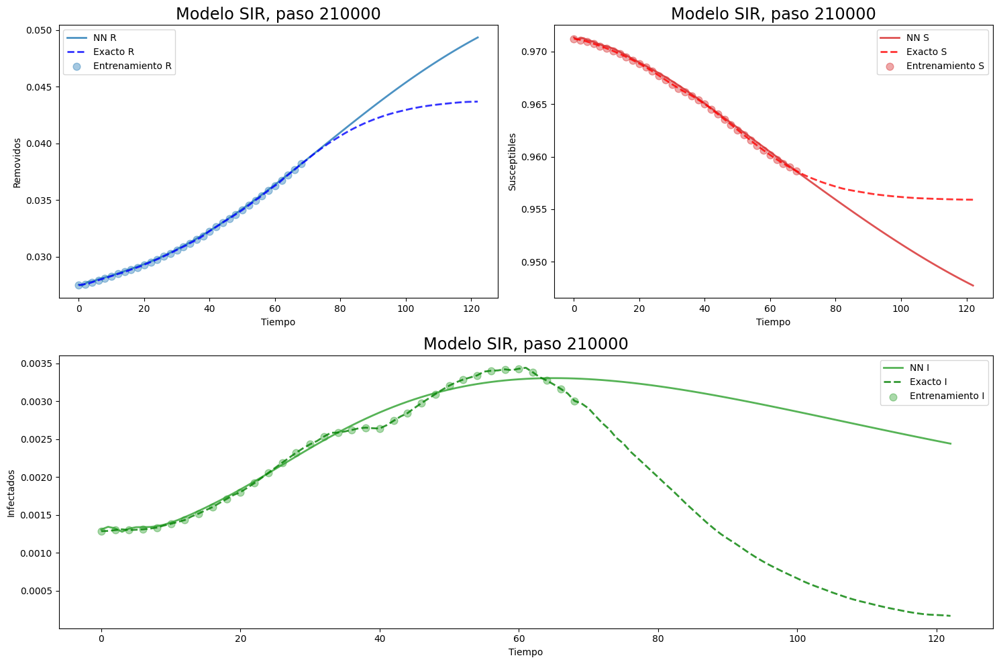

Paso = 210000 , pérdida de datos = 1.3766936e-08 , pérdida física = 1.1849478e-09 , pérdida total = 1.4951883e-08 , mse = 4.759651e-06 , beta = 0.07526004 , gamma = 0.06898997
Paso = 211000 , pérdida de datos = 8.636503e-08 , pérdida física = 1.5943693e-09 , pérdida total = 8.79594e-08 , mse = 4.212603e-06 , beta = 0.07500091 , gamma = 0.06876522
Paso = 212000 , pérdida de datos = 5.769153e-09 , pérdida física = 1.1712968e-09 , pérdida total = 6.94045e-09 , mse = 4.845001e-06 , beta = 0.07485537 , gamma = 0.06863884
Paso = 213000 , pérdida de datos = 1.795941e-08 , pérdida física = 1.5629431e-09 , pérdida total = 1.9522354e-08 , mse = 4.8745396e-06 , beta = 0.07498475 , gamma = 0.068772614
Paso = 214000 , pérdida de datos = 5.441076e-09 , pérdida física = 1.1727345e-09 , pérdida total = 6.6138104e-09 , mse = 4.848119e-06 , beta = 0.07517957 , gamma = 0.068923645
Paso = 215000 , pérdida de datos = 4.9186312e-08 , pérdida física = 1.2330128e-09 , pérdida total = 5.0419324e-08 , mse = 5.3

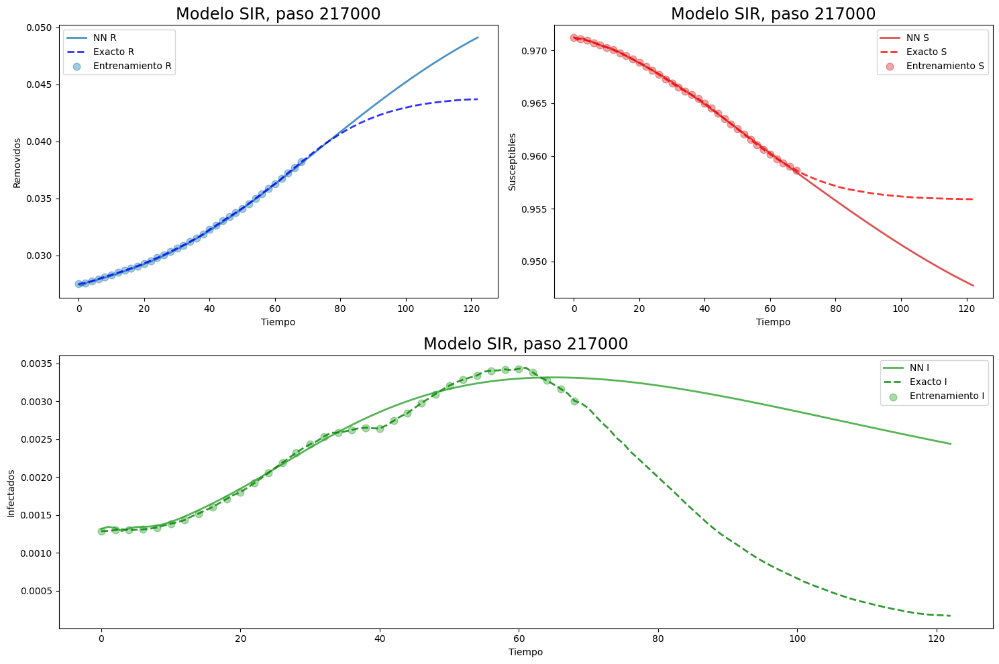

Paso = 217000 , pérdida de datos = 5.648133e-09 , pérdida física = 1.1754293e-09 , pérdida total = 6.823562e-09 , mse = 4.7117155e-06 , beta = 0.07489652 , gamma = 0.068640076
Paso = 218000 , pérdida de datos = 5.5067466e-09 , pérdida física = 1.177692e-09 , pérdida total = 6.684439e-09 , mse = 4.793697e-06 , beta = 0.07526108 , gamma = 0.06905733
Paso = 219000 , pérdida de datos = 9.2330424e-08 , pérdida física = 1.721645e-09 , pérdida total = 9.405207e-08 , mse = 4.7180906e-06 , beta = 0.07510519 , gamma = 0.06897094
Paso = 220000 , pérdida de datos = 5.400957e-09 , pérdida física = 1.1811174e-09 , pérdida total = 6.5820744e-09 , mse = 4.7955373e-06 , beta = 0.075230874 , gamma = 0.06905895
Paso = 221000 , pérdida de datos = 3.2673736e-08 , pérdida física = 1.2321415e-09 , pérdida total = 3.3905877e-08 , mse = 5.3734802e-06 , beta = 0.07502967 , gamma = 0.068926685
Paso = 222000 , pérdida de datos = 5.5754974e-09 , pérdida física = 1.1952284e-09 , pérdida total = 6.7707258e-09 , mse 

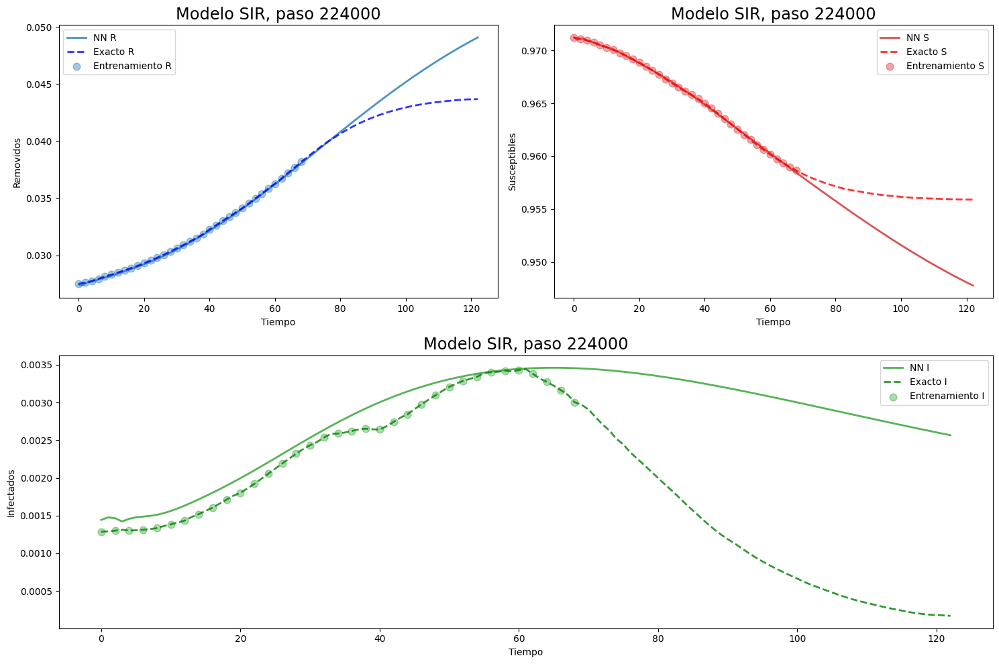

Paso = 224000 , pérdida de datos = 1.4542548e-08 , pérdida física = 1.4422581e-09 , pérdida total = 1.5984806e-08 , mse = 4.755495e-06 , beta = 0.07442739 , gamma = 0.068356626
Paso = 225000 , pérdida de datos = 5.391153e-09 , pérdida física = 1.1943608e-09 , pérdida total = 6.5855135e-09 , mse = 4.707175e-06 , beta = 0.07486045 , gamma = 0.06879743
Paso = 226000 , pérdida de datos = 6.518954e-09 , pérdida física = 1.1898034e-09 , pérdida total = 7.708757e-09 , mse = 4.7247386e-06 , beta = 0.07462496 , gamma = 0.06850864
Paso = 227000 , pérdida de datos = 5.510224e-09 , pérdida física = 1.1800568e-09 , pérdida total = 6.6902808e-09 , mse = 4.783418e-06 , beta = 0.07507392 , gamma = 0.06885956
Paso = 228000 , pérdida de datos = 3.4969247e-08 , pérdida física = 1.2493071e-09 , pérdida total = 3.6218555e-08 , mse = 4.8178827e-06 , beta = 0.075047836 , gamma = 0.06897982
Paso = 229000 , pérdida de datos = 1.3707066e-08 , pérdida física = 1.1941128e-09 , pérdida total = 1.4901179e-08 , mse 

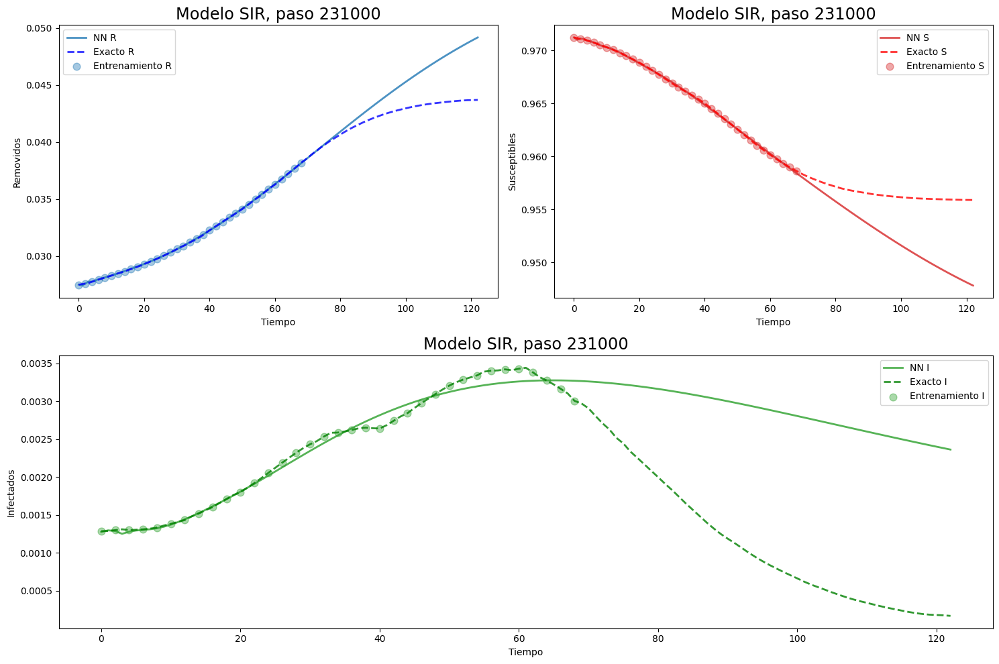

Paso = 231000 , pérdida de datos = 6.111241e-09 , pérdida física = 1.2018789e-09 , pérdida total = 7.31312e-09 , mse = 4.6567347e-06 , beta = 0.07437904 , gamma = 0.068356805
Paso = 232000 , pérdida de datos = 1.9048228e-08 , pérdida física = 1.2159841e-09 , pérdida total = 2.0264212e-08 , mse = 4.2953143e-06 , beta = 0.07492651 , gamma = 0.068885095
Paso = 233000 , pérdida de datos = 6.635382e-09 , pérdida física = 1.204412e-09 , pérdida total = 7.839794e-09 , mse = 4.6982723e-06 , beta = 0.07483775 , gamma = 0.068752974
Paso = 234000 , pérdida de datos = 1.0149171e-08 , pérdida física = 1.2047197e-09 , pérdida total = 1.1353891e-08 , mse = 4.7513267e-06 , beta = 0.074547164 , gamma = 0.068502784
Paso = 235000 , pérdida de datos = 7.962793e-09 , pérdida física = 1.2013464e-09 , pérdida total = 9.16414e-09 , mse = 4.6325413e-06 , beta = 0.07486792 , gamma = 0.068787426
Paso = 236000 , pérdida de datos = 3.5703817e-08 , pérdida física = 1.3317012e-09 , pérdida total = 3.703552e-08 , mse

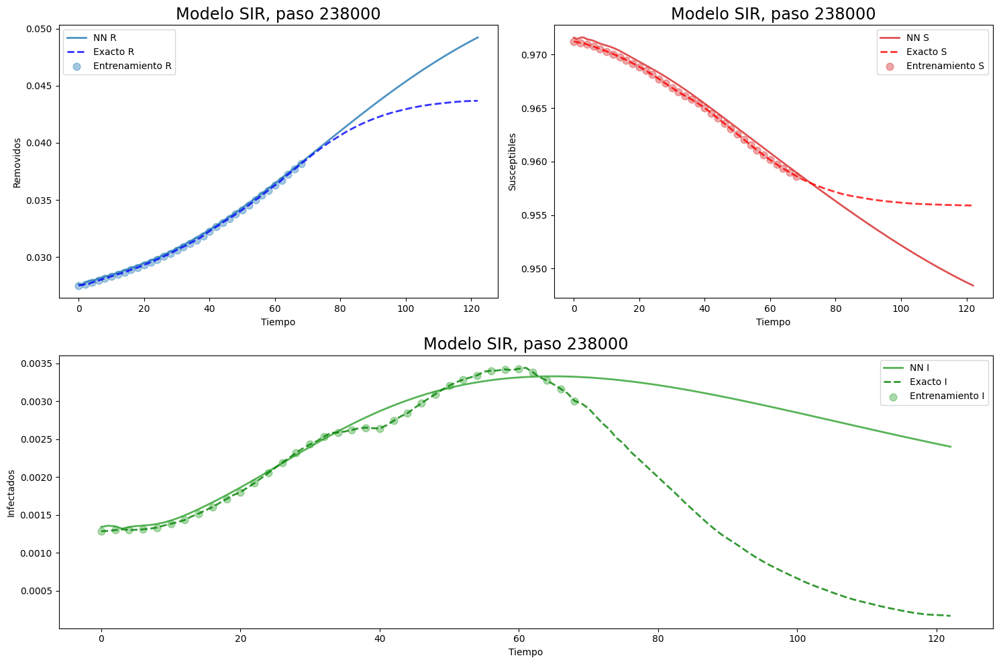

Paso = 238000 , pérdida de datos = 1.090292e-07 , pérdida física = 1.3740096e-09 , pérdida total = 1.10403214e-07 , mse = 4.2018855e-06 , beta = 0.07414503 , gamma = 0.06814161
Paso = 239000 , pérdida de datos = 3.1516322e-08 , pérdida física = 1.2793284e-09 , pérdida total = 3.279565e-08 , mse = 4.257814e-06 , beta = 0.07494875 , gamma = 0.06893656
Paso = 240000 , pérdida de datos = 1.1452504e-08 , pérdida física = 1.3051769e-09 , pérdida total = 1.2757681e-08 , mse = 4.4716685e-06 , beta = 0.07399189 , gamma = 0.06796001
Paso = 241000 , pérdida de datos = 6.7571806e-09 , pérdida física = 1.2082455e-09 , pérdida total = 7.965426e-09 , mse = 4.54099e-06 , beta = 0.0748552 , gamma = 0.068834946
Paso = 242000 , pérdida de datos = 5.1738372e-08 , pérdida física = 1.211032e-09 , pérdida total = 5.2949403e-08 , mse = 4.3730033e-06 , beta = 0.0742316 , gamma = 0.068224244
Paso = 243000 , pérdida de datos = 6.4071344e-08 , pérdida física = 3.0187015e-09 , pérdida total = 6.709004e-08 , mse = 

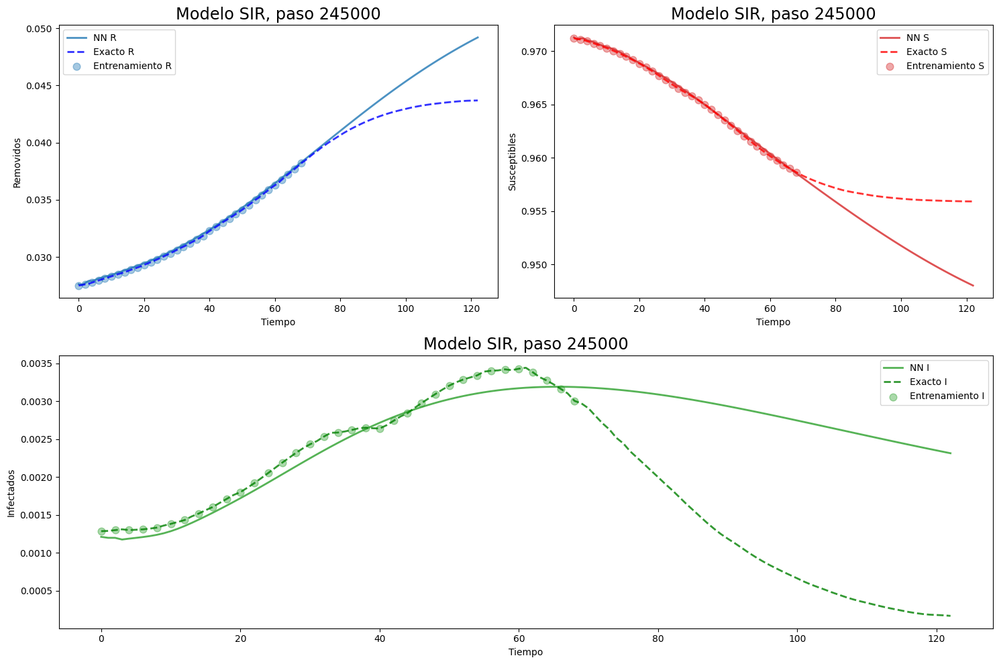

Paso = 245000 , pérdida de datos = 1.6246283e-08 , pérdida física = 1.2172594e-09 , pérdida total = 1.7463542e-08 , mse = 4.519845e-06 , beta = 0.073959626 , gamma = 0.06794015
Paso = 246000 , pérdida de datos = 6.4448194e-08 , pérdida física = 2.3209454e-09 , pérdida total = 6.676914e-08 , mse = 4.4250196e-06 , beta = 0.07479908 , gamma = 0.06884656
Paso = 247000 , pérdida de datos = 2.3162242e-08 , pérdida física = 1.2392629e-09 , pérdida total = 2.4401505e-08 , mse = 4.9280425e-06 , beta = 0.07485083 , gamma = 0.06890358
Paso = 248000 , pérdida de datos = 7.1122908e-09 , pérdida física = 1.2070347e-09 , pérdida total = 8.319326e-09 , mse = 4.4882545e-06 , beta = 0.07433173 , gamma = 0.06822201
Paso = 249000 , pérdida de datos = 8.742796e-09 , pérdida física = 1.2252467e-09 , pérdida total = 9.968042e-09 , mse = 4.6016153e-06 , beta = 0.0743312 , gamma = 0.06835705
Paso = 250000 , pérdida de datos = 7.817559e-08 , pérdida física = 1.301546e-09 , pérdida total = 7.947713e-08 , mse = 5

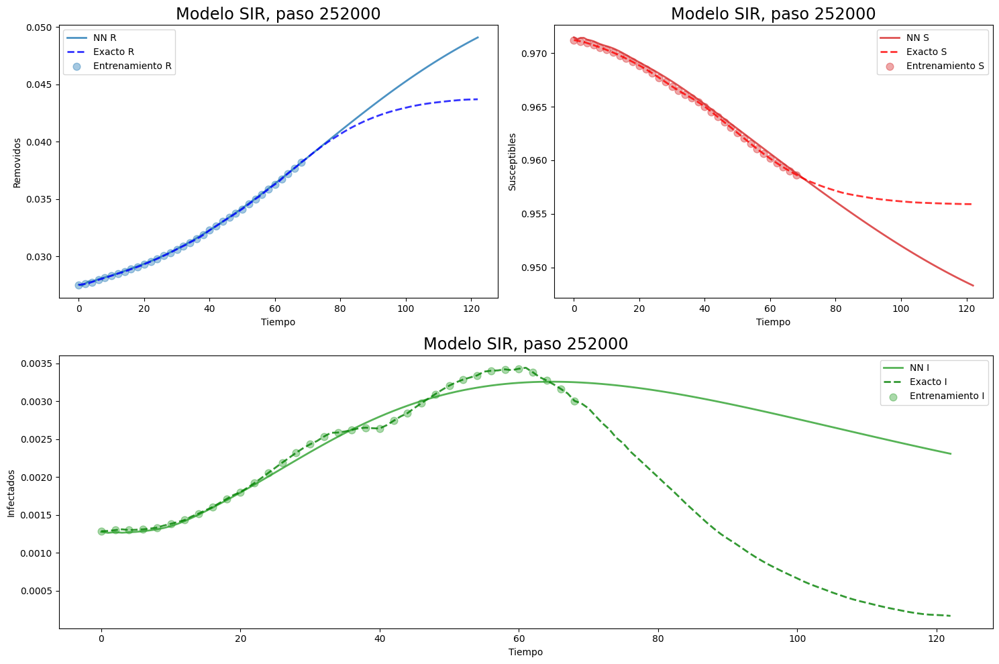

Paso = 252000 , pérdida de datos = 7.8398195e-08 , pérdida física = 1.2900094e-09 , pérdida total = 7.9688206e-08 , mse = 4.182657e-06 , beta = 0.07423041 , gamma = 0.068268105
Paso = 253000 , pérdida de datos = 8.041082e-09 , pérdida física = 1.2224946e-09 , pérdida total = 9.263577e-09 , mse = 4.623744e-06 , beta = 0.07442822 , gamma = 0.06849482
Paso = 254000 , pérdida de datos = 1.0050483e-08 , pérdida física = 1.222191e-09 , pérdida total = 1.1272674e-08 , mse = 4.329952e-06 , beta = 0.07462475 , gamma = 0.06870106
Paso = 255000 , pérdida de datos = 1.37729e-08 , pérdida física = 1.2366167e-09 , pérdida total = 1.5009517e-08 , mse = 4.6257924e-06 , beta = 0.07469258 , gamma = 0.06881463
Paso = 256000 , pérdida de datos = 2.3736854e-07 , pérdida física = 1.4922419e-09 , pérdida total = 2.388608e-07 , mse = 5.8130045e-06 , beta = 0.07430528 , gamma = 0.06838202
Paso = 257000 , pérdida de datos = 5.2759543e-09 , pérdida física = 1.2343112e-09 , pérdida total = 6.5102657e-09 , mse = 4

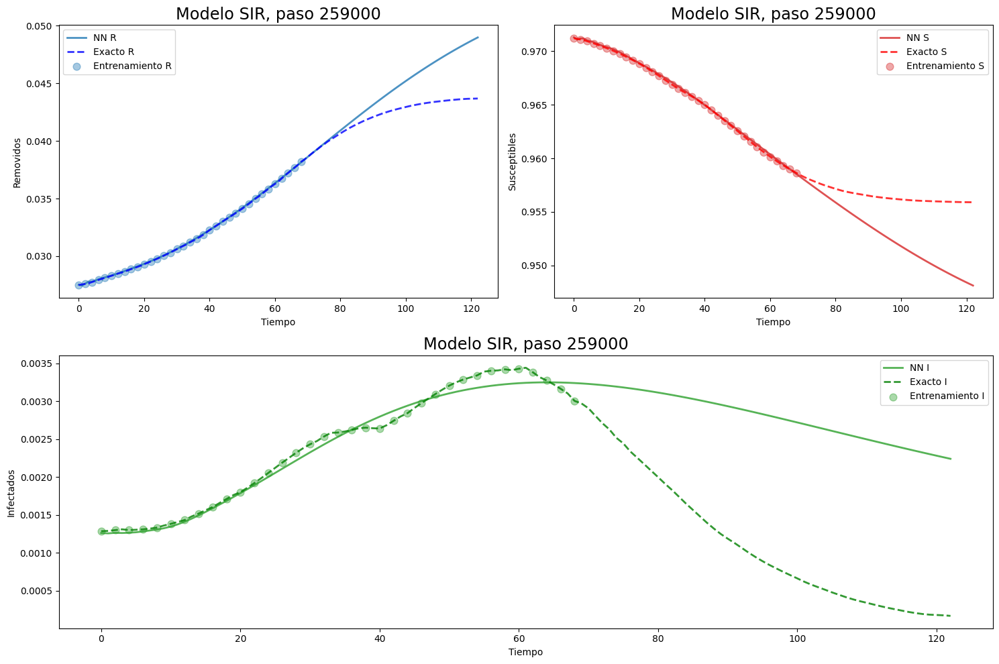

Paso = 259000 , pérdida de datos = 8.969979e-09 , pérdida física = 1.2438406e-09 , pérdida total = 1.021382e-08 , mse = 4.3247187e-06 , beta = 0.07471459 , gamma = 0.06878333
Paso = 260000 , pérdida de datos = 8.144793e-09 , pérdida física = 1.323374e-09 , pérdida total = 9.468168e-09 , mse = 4.504475e-06 , beta = 0.07429468 , gamma = 0.068395354
Paso = 261000 , pérdida de datos = 2.7071746e-08 , pérdida física = 1.4156585e-09 , pérdida total = 2.8487404e-08 , mse = 4.2837014e-06 , beta = 0.074281484 , gamma = 0.06844654
Paso = 262000 , pérdida de datos = 2.5416027e-08 , pérdida física = 1.2509598e-09 , pérdida total = 2.6666987e-08 , mse = 4.7300077e-06 , beta = 0.07455447 , gamma = 0.06867387
Paso = 263000 , pérdida de datos = 8.121348e-09 , pérdida física = 1.2467725e-09 , pérdida total = 9.3681205e-09 , mse = 4.4277895e-06 , beta = 0.07449145 , gamma = 0.06863402
Paso = 264000 , pérdida de datos = 6.5125056e-09 , pérdida física = 1.2409619e-09 , pérdida total = 7.753467e-09 , mse =

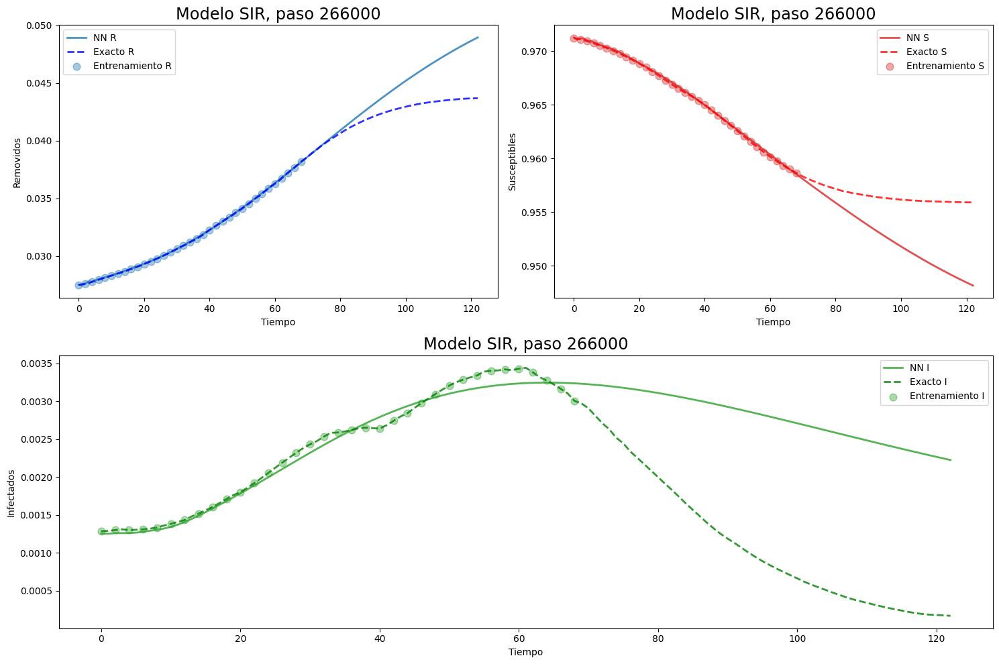

Paso = 266000 , pérdida de datos = 7.02992e-09 , pérdida física = 1.2438663e-09 , pérdida total = 8.273787e-09 , mse = 4.306845e-06 , beta = 0.07454835 , gamma = 0.068676814
Paso = 267000 , pérdida de datos = 1.0171229e-08 , pérdida física = 1.2582247e-09 , pérdida total = 1.1429454e-08 , mse = 4.229775e-06 , beta = 0.07466941 , gamma = 0.068827696
Paso = 268000 , pérdida de datos = 2.398064e-08 , pérdida física = 1.3925684e-09 , pérdida total = 2.5373208e-08 , mse = 4.531069e-06 , beta = 0.07396953 , gamma = 0.06810034
Paso = 269000 , pérdida de datos = 1.4964502e-07 , pérdida física = 1.7819155e-09 , pérdida total = 1.5142693e-07 , mse = 5.068257e-06 , beta = 0.07459043 , gamma = 0.068808824
Paso = 270000 , pérdida de datos = 3.26145e-08 , pérdida física = 1.2964274e-09 , pérdida total = 3.391093e-08 , mse = 4.3624245e-06 , beta = 0.07460183 , gamma = 0.06878562
Paso = 271000 , pérdida de datos = 1.1580769e-08 , pérdida física = 1.2611229e-09 , pérdida total = 1.2841892e-08 , mse = 4

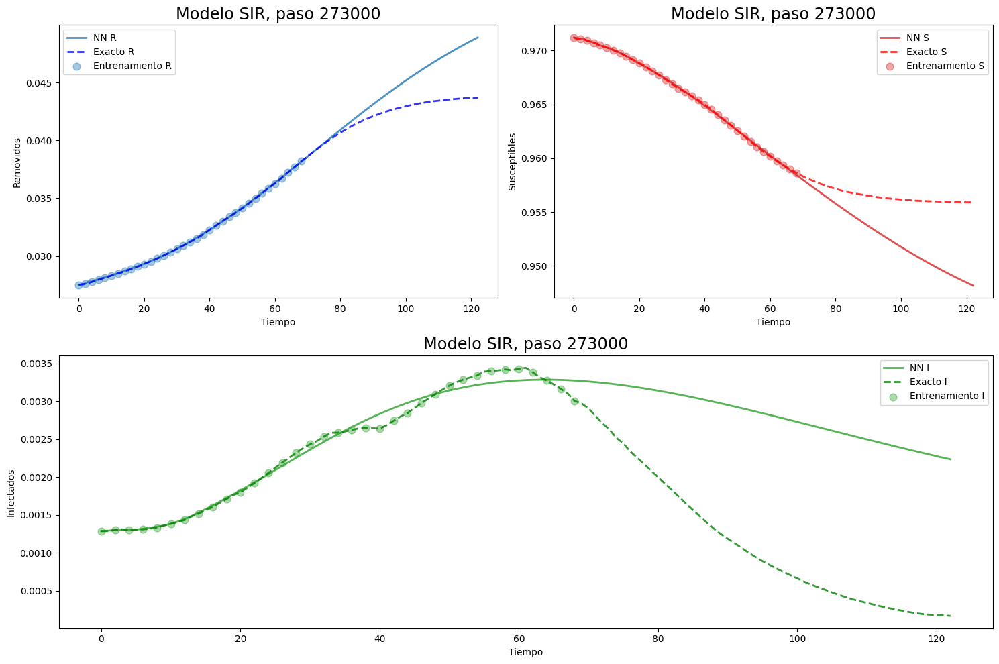

Paso = 273000 , pérdida de datos = 5.295927e-09 , pérdida física = 1.2621673e-09 , pérdida total = 6.558094e-09 , mse = 4.313363e-06 , beta = 0.074592344 , gamma = 0.06883799
Paso = 274000 , pérdida de datos = 4.3606832e-08 , pérdida física = 1.3233427e-09 , pérdida total = 4.4930175e-08 , mse = 4.6034165e-06 , beta = 0.074363194 , gamma = 0.06860281
Paso = 275000 , pérdida de datos = 7.83288e-09 , pérdida física = 1.2560808e-09 , pérdida total = 9.088961e-09 , mse = 4.3159257e-06 , beta = 0.07472256 , gamma = 0.06891718
Paso = 276000 , pérdida de datos = 5.305049e-09 , pérdida física = 1.2666743e-09 , pérdida total = 6.571723e-09 , mse = 4.2617935e-06 , beta = 0.074502945 , gamma = 0.068759814
Paso = 277000 , pérdida de datos = 1.815391e-08 , pérdida física = 1.2770718e-09 , pérdida total = 1.9430981e-08 , mse = 4.530136e-06 , beta = 0.07447345 , gamma = 0.06873674
Paso = 278000 , pérdida de datos = 2.7732849e-08 , pérdida física = 1.2917237e-09 , pérdida total = 2.9024573e-08 , mse =

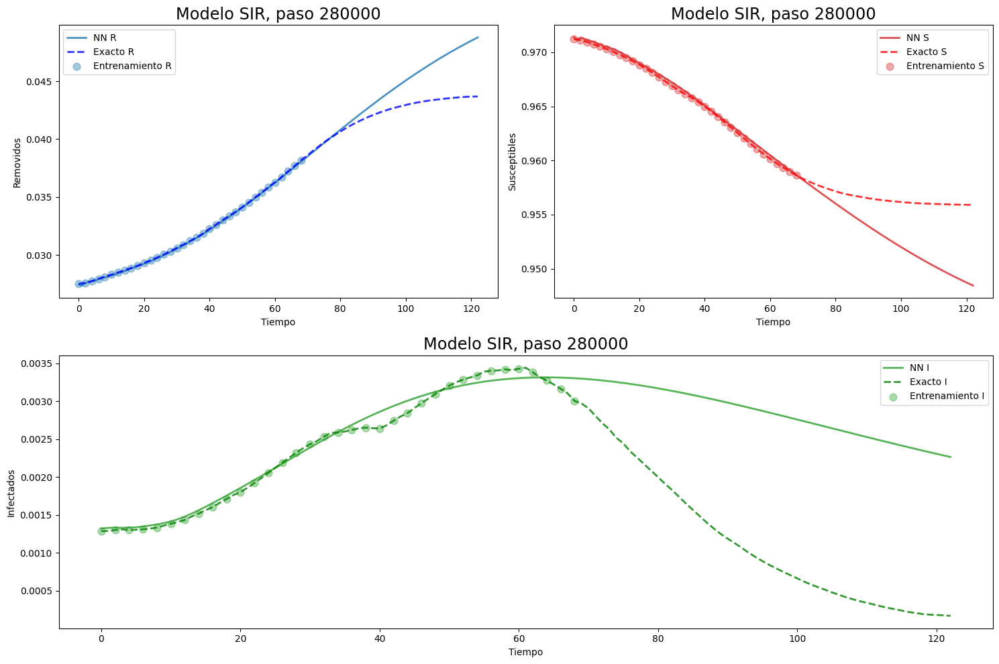

Paso = 280000 , pérdida de datos = 3.0730288e-08 , pérdida física = 1.3228695e-09 , pérdida total = 3.205316e-08 , mse = 4.0055907e-06 , beta = 0.07422651 , gamma = 0.068521485
Paso = 281000 , pérdida de datos = 5.2293934e-09 , pérdida física = 1.2735736e-09 , pérdida total = 6.502967e-09 , mse = 4.23267e-06 , beta = 0.07445489 , gamma = 0.0687431
Paso = 282000 , pérdida de datos = 6.7603727e-09 , pérdida física = 1.2771306e-09 , pérdida total = 8.037503e-09 , mse = 4.2565343e-06 , beta = 0.074426815 , gamma = 0.06875861
Paso = 283000 , pérdida de datos = 1.2744186e-08 , pérdida física = 1.2885292e-09 , pérdida total = 1.4032715e-08 , mse = 4.0451146e-06 , beta = 0.07430937 , gamma = 0.068649024
Paso = 284000 , pérdida de datos = 8.379043e-08 , pérdida física = 1.488691e-09 , pérdida total = 8.5279126e-08 , mse = 4.629071e-06 , beta = 0.07458002 , gamma = 0.068895854
Paso = 285000 , pérdida de datos = 5.0845305e-08 , pérdida física = 1.4562249e-09 , pérdida total = 5.230153e-08 , mse =

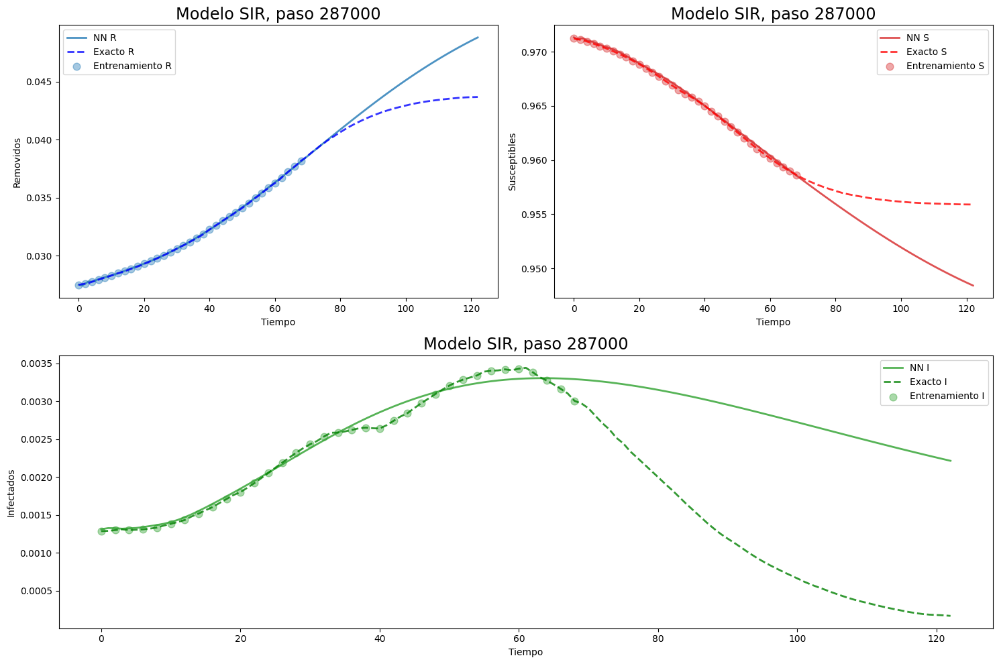

Paso = 287000 , pérdida de datos = 1.163779e-08 , pérdida física = 1.2984963e-09 , pérdida total = 1.2936287e-08 , mse = 4.0567515e-06 , beta = 0.07451272 , gamma = 0.06882948
Paso = 288000 , pérdida de datos = 5.6092864e-09 , pérdida física = 1.3040924e-09 , pérdida total = 6.9133788e-09 , mse = 4.2091415e-06 , beta = 0.07455623 , gamma = 0.06891513
Paso = 289000 , pérdida de datos = 1.071425e-08 , pérdida física = 1.3044775e-09 , pérdida total = 1.2018727e-08 , mse = 4.361449e-06 , beta = 0.07386994 , gamma = 0.068211
Paso = 290000 , pérdida de datos = 3.2216334e-08 , pérdida física = 1.8353088e-09 , pérdida total = 3.4051645e-08 , mse = 4.26e-06 , beta = 0.07445833 , gamma = 0.06884028
Paso = 291000 , pérdida de datos = 6.179131e-09 , pérdida física = 1.3040792e-09 , pérdida total = 7.4832105e-09 , mse = 4.2658307e-06 , beta = 0.074319564 , gamma = 0.06860409
Paso = 292000 , pérdida de datos = 6.4715614e-08 , pérdida física = 1.7030134e-09 , pérdida total = 6.641863e-08 , mse = 3.94

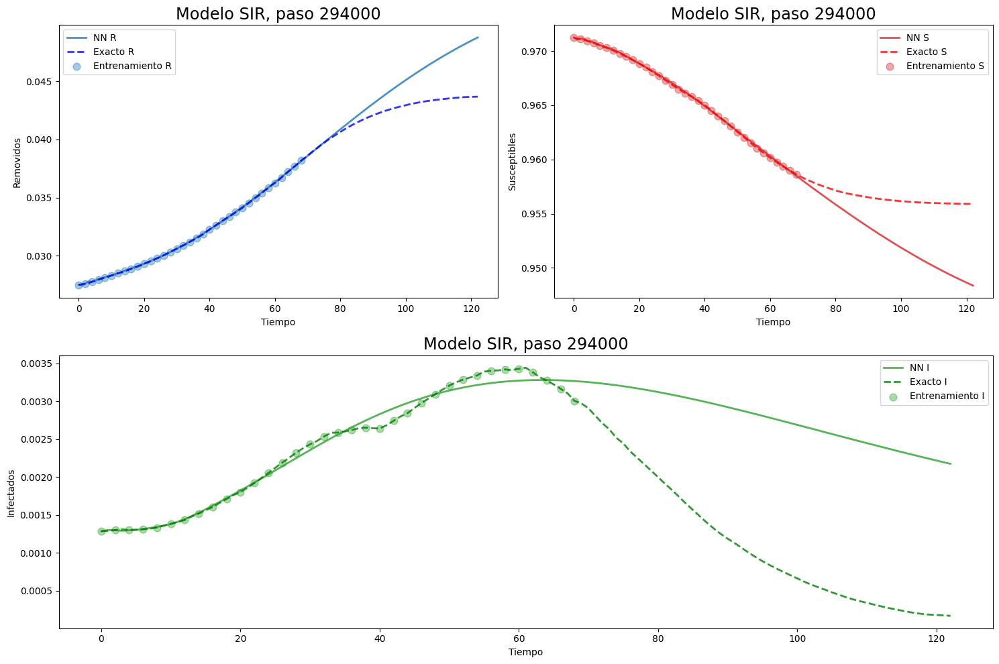

Paso = 294000 , pérdida de datos = 5.8086247e-09 , pérdida física = 1.2923506e-09 , pérdida total = 7.1009754e-09 , mse = 4.0930954e-06 , beta = 0.074454434 , gamma = 0.06881118
Paso = 295000 , pérdida de datos = 5.603154e-09 , pérdida física = 1.3121375e-09 , pérdida total = 6.9152915e-09 , mse = 4.184915e-06 , beta = 0.07408153 , gamma = 0.06842057
Paso = 296000 , pérdida de datos = 5.117982e-09 , pérdida física = 1.2926981e-09 , pérdida total = 6.41068e-09 , mse = 4.151975e-06 , beta = 0.07456803 , gamma = 0.068960994
Paso = 297000 , pérdida de datos = 5.1125855e-09 , pérdida física = 1.2937355e-09 , pérdida total = 6.406321e-09 , mse = 4.152945e-06 , beta = 0.074550286 , gamma = 0.068954155
Paso = 298000 , pérdida de datos = 1.3736719e-08 , pérdida física = 1.2872217e-09 , pérdida total = 1.5023941e-08 , mse = 4.317217e-06 , beta = 0.07440664 , gamma = 0.06876561
Paso = 299000 , pérdida de datos = 8.3063965e-09 , pérdida física = 1.2938516e-09 , pérdida total = 9.600248e-09 , mse =

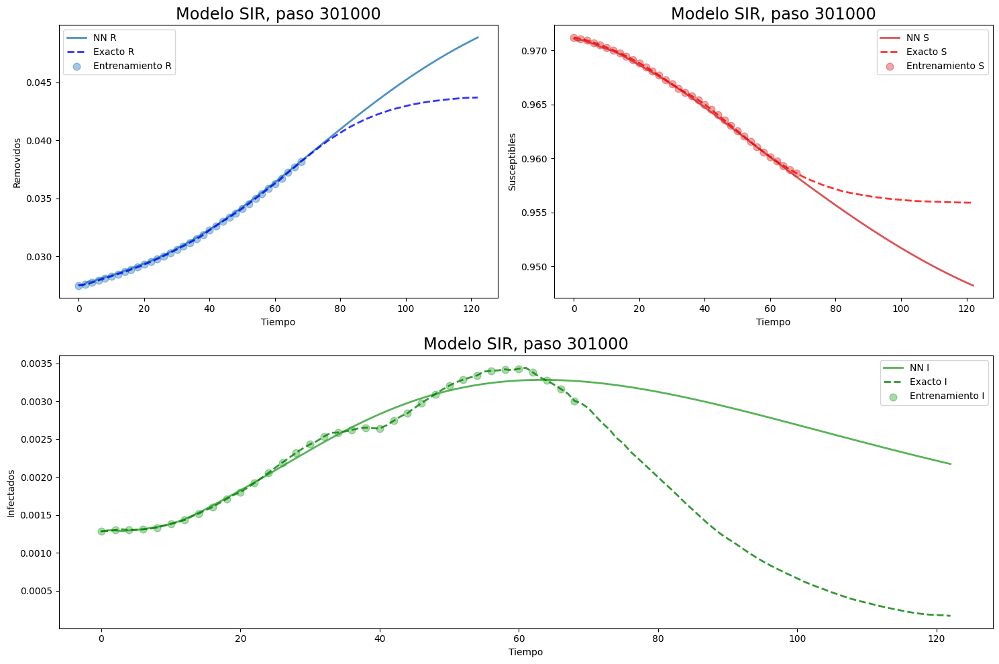

Paso = 301000 , pérdida de datos = 1.5690468e-08 , pérdida física = 1.3020223e-09 , pérdida total = 1.699249e-08 , mse = 4.329724e-06 , beta = 0.07431235 , gamma = 0.06874943
Paso = 302000 , pérdida de datos = 9.997968e-09 , pérdida física = 1.3048813e-09 , pérdida total = 1.1302849e-08 , mse = 3.93854e-06 , beta = 0.07444673 , gamma = 0.06886312
Paso = 303000 , pérdida de datos = 5.990313e-09 , pérdida física = 1.3051618e-09 , pérdida total = 7.295475e-09 , mse = 4.1564995e-06 , beta = 0.074040756 , gamma = 0.06845593
Paso = 304000 , pérdida de datos = 1.0813198e-08 , pérdida física = 1.3032797e-09 , pérdida total = 1.21164785e-08 , mse = 3.989734e-06 , beta = 0.07446033 , gamma = 0.06887015
Paso = 305000 , pérdida de datos = 5.659199e-09 , pérdida física = 1.2956832e-09 , pérdida total = 6.954882e-09 , mse = 4.125851e-06 , beta = 0.07439386 , gamma = 0.06875465
Paso = 306000 , pérdida de datos = 1.1890553e-07 , pérdida física = 1.3433947e-09 , pérdida total = 1.2024893e-07 , mse = 4.

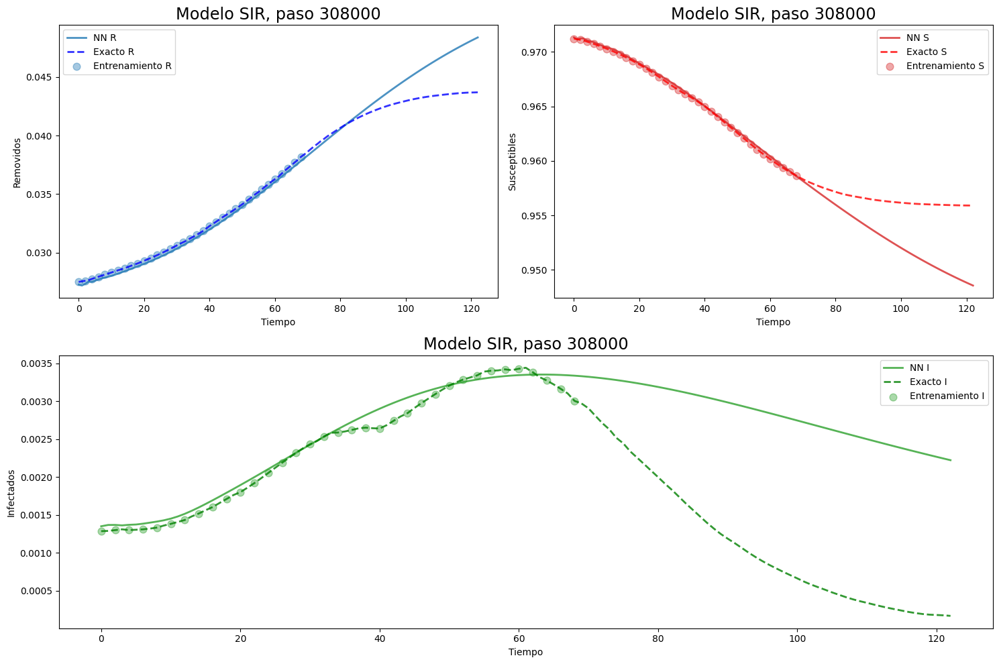

Paso = 308000 , pérdida de datos = 2.8316482e-08 , pérdida física = 1.3392929e-09 , pérdida total = 2.9655775e-08 , mse = 3.781037e-06 , beta = 0.07442155 , gamma = 0.068790965
Paso = 309000 , pérdida de datos = 5.425022e-09 , pérdida física = 1.298479e-09 , pérdida total = 6.7235013e-09 , mse = 4.087803e-06 , beta = 0.074594885 , gamma = 0.06900802
Paso = 310000 , pérdida de datos = 5.1017084e-09 , pérdida física = 1.3044197e-09 , pérdida total = 6.406128e-09 , mse = 4.083771e-06 , beta = 0.07451091 , gamma = 0.06897054
Paso = 311000 , pérdida de datos = 5.3168345e-09 , pérdida física = 1.3031387e-09 , pérdida total = 6.619973e-09 , mse = 4.0727255e-06 , beta = 0.07449191 , gamma = 0.06891497
Paso = 312000 , pérdida de datos = 5.0969065e-09 , pérdida física = 1.3030962e-09 , pérdida total = 6.4000027e-09 , mse = 4.0937875e-06 , beta = 0.074546374 , gamma = 0.06898897
Paso = 313000 , pérdida de datos = 5.244708e-09 , pérdida física = 1.3131357e-09 , pérdida total = 6.5578436e-09 , mse 

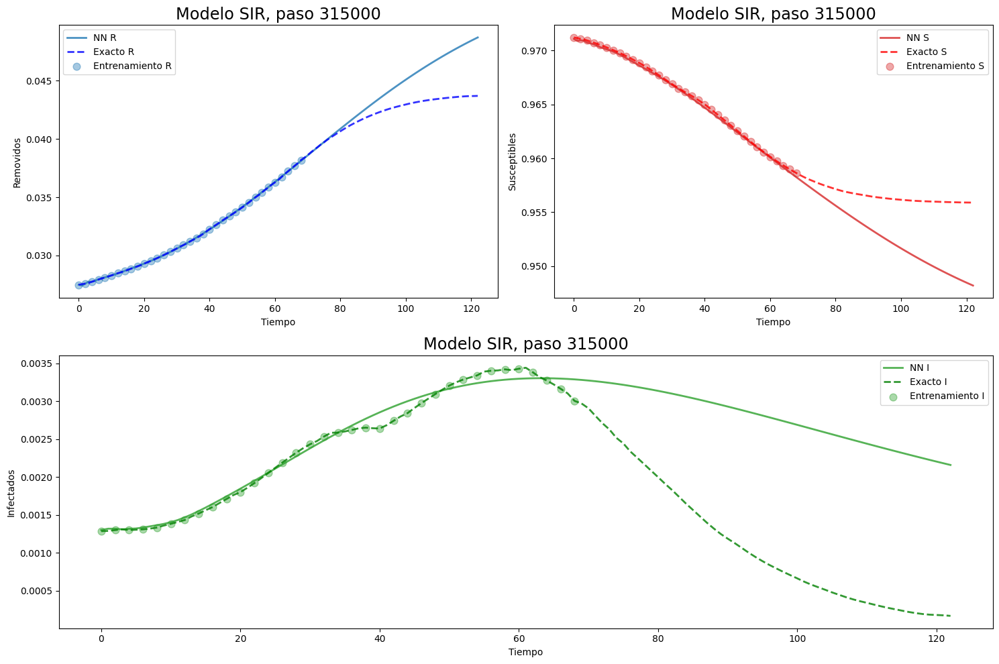

Paso = 315000 , pérdida de datos = 1.0884794e-08 , pérdida física = 1.307661e-09 , pérdida total = 1.2192455e-08 , mse = 4.2927486e-06 , beta = 0.07443088 , gamma = 0.068837
Paso = 316000 , pérdida de datos = 7.895849e-09 , pérdida física = 1.3078012e-09 , pérdida total = 9.20365e-09 , mse = 3.932264e-06 , beta = 0.074306495 , gamma = 0.06875714
Paso = 317000 , pérdida de datos = 6.153483e-09 , pérdida física = 1.3104107e-09 , pérdida total = 7.4638935e-09 , mse = 4.007749e-06 , beta = 0.07390397 , gamma = 0.06837792
Paso = 318000 , pérdida de datos = 5.6282983e-09 , pérdida física = 1.3091426e-09 , pérdida total = 6.937441e-09 , mse = 4.1798626e-06 , beta = 0.07437903 , gamma = 0.068828285
Paso = 319000 , pérdida de datos = 1.6477436e-08 , pérdida física = 1.3459955e-09 , pérdida total = 1.7823432e-08 , mse = 3.8486505e-06 , beta = 0.0744122 , gamma = 0.06890343
Paso = 320000 , pérdida de datos = 3.2004053e-08 , pérdida física = 1.3295134e-09 , pérdida total = 3.3333567e-08 , mse = 4.

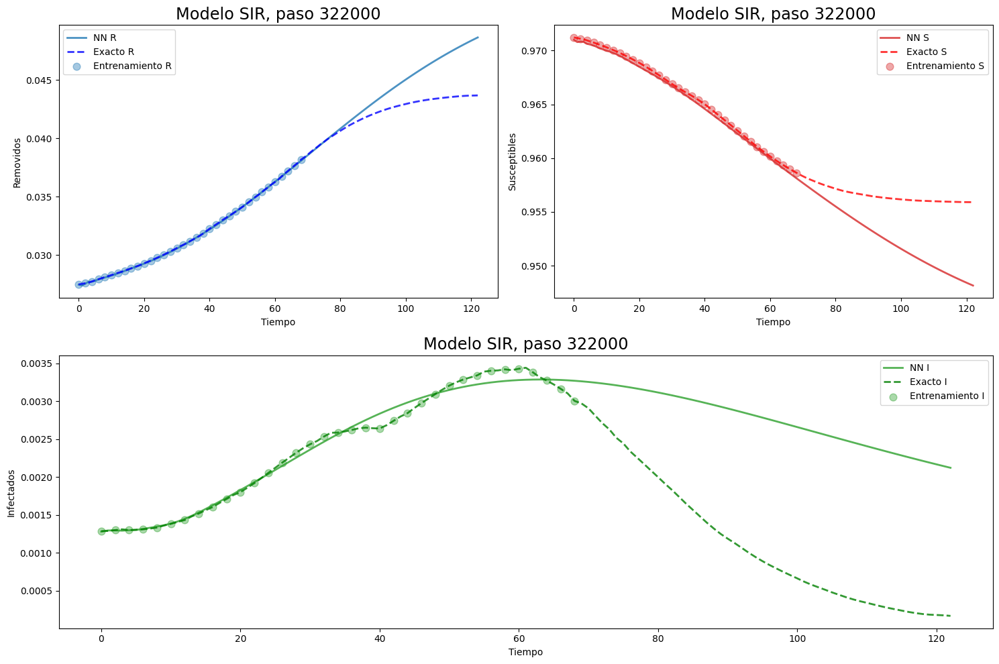

Paso = 322000 , pérdida de datos = 2.0987432e-08 , pérdida física = 1.3287718e-09 , pérdida total = 2.2316204e-08 , mse = 4.364381e-06 , beta = 0.074363425 , gamma = 0.068877
Paso = 323000 , pérdida de datos = 1.0394245e-08 , pérdida física = 1.3709393e-09 , pérdida total = 1.17651835e-08 , mse = 3.9424826e-06 , beta = 0.07393779 , gamma = 0.06844327
Paso = 324000 , pérdida de datos = 1.4728735e-08 , pérdida física = 1.3277645e-09 , pérdida total = 1.6056498e-08 , mse = 4.231909e-06 , beta = 0.07441793 , gamma = 0.06882525
Paso = 325000 , pérdida de datos = 4.329086e-08 , pérdida física = 1.4746455e-09 , pérdida total = 4.4765507e-08 , mse = 3.8739563e-06 , beta = 0.07440359 , gamma = 0.068960175
Paso = 326000 , pérdida de datos = 1.1337981e-07 , pérdida física = 1.3689407e-09 , pérdida total = 1.1474875e-07 , mse = 3.321374e-06 , beta = 0.07440588 , gamma = 0.06894363
Paso = 327000 , pérdida de datos = 5.1590745e-09 , pérdida física = 1.3259888e-09 , pérdida total = 6.485063e-09 , mse

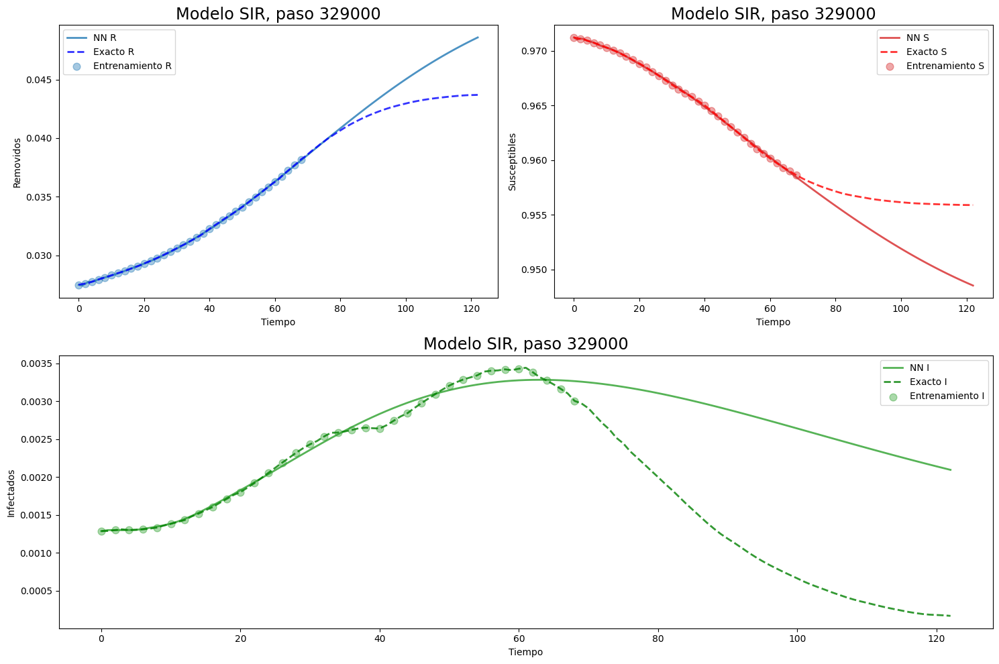

Paso = 329000 , pérdida de datos = 5.1462967e-09 , pérdida física = 1.3293822e-09 , pérdida total = 6.4756787e-09 , mse = 3.911832e-06 , beta = 0.07428841 , gamma = 0.068812184
Paso = 330000 , pérdida de datos = 2.2564755e-08 , pérdida física = 1.3379119e-09 , pérdida total = 2.3902667e-08 , mse = 4.0203563e-06 , beta = 0.074116215 , gamma = 0.06867405
Paso = 331000 , pérdida de datos = 5.0464283e-08 , pérdida física = 1.3788243e-09 , pérdida total = 5.184311e-08 , mse = 4.06368e-06 , beta = 0.074244924 , gamma = 0.06875733
Paso = 332000 , pérdida de datos = 2.9643095e-08 , pérdida física = 1.3297621e-09 , pérdida total = 3.0972856e-08 , mse = 4.1695143e-06 , beta = 0.07438066 , gamma = 0.068875335
Paso = 333000 , pérdida de datos = 2.492322e-08 , pérdida física = 1.3352246e-09 , pérdida total = 2.6258446e-08 , mse = 4.0179666e-06 , beta = 0.0739781 , gamma = 0.06850506
Paso = 334000 , pérdida de datos = 8.7261895e-09 , pérdida física = 1.3401054e-09 , pérdida total = 1.00662945e-08 , 

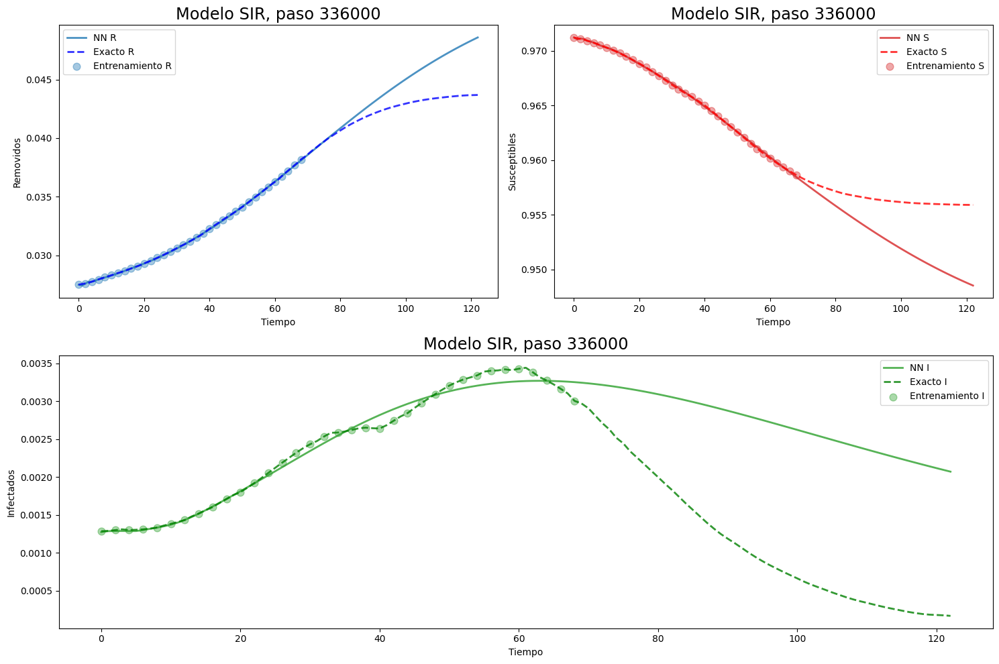

Paso = 336000 , pérdida de datos = 1.0470833e-08 , pérdida física = 1.3297381e-09 , pérdida total = 1.1800571e-08 , mse = 3.9344727e-06 , beta = 0.07436026 , gamma = 0.0689061
Paso = 337000 , pérdida de datos = 7.794517e-09 , pérdida física = 1.3748944e-09 , pérdida total = 9.169412e-09 , mse = 3.835513e-06 , beta = 0.07385909 , gamma = 0.06844325
Paso = 338000 , pérdida de datos = 5.316197e-09 , pérdida física = 1.3387309e-09 , pérdida total = 6.6549277e-09 , mse = 3.8922367e-06 , beta = 0.074153125 , gamma = 0.06876018
Paso = 339000 , pérdida de datos = 5.8423693e-09 , pérdida física = 1.3356902e-09 , pérdida total = 7.1780595e-09 , mse = 3.856658e-06 , beta = 0.07423673 , gamma = 0.06880544
Paso = 340000 , pérdida de datos = 5.1619535e-09 , pérdida física = 1.3375515e-09 , pérdida total = 6.499505e-09 , mse = 3.906508e-06 , beta = 0.07429119 , gamma = 0.068878785
Paso = 341000 , pérdida de datos = 5.002015e-09 , pérdida física = 1.3442716e-09 , pérdida total = 6.346286e-09 , mse = 3

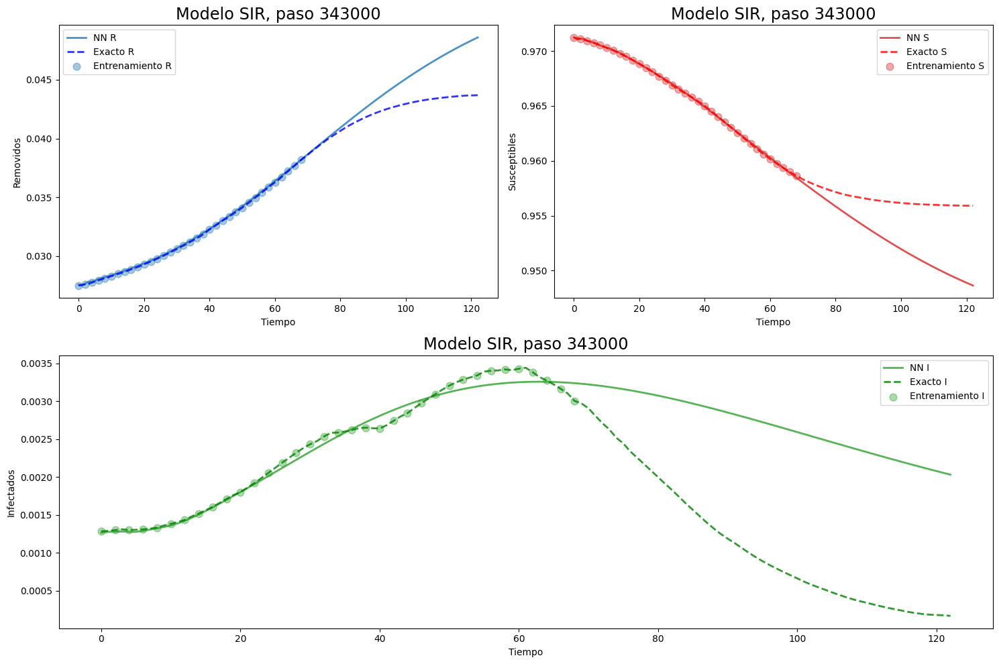

Paso = 343000 , pérdida de datos = 7.2188295e-09 , pérdida física = 1.3469235e-09 , pérdida total = 8.5657526e-09 , mse = 3.8576945e-06 , beta = 0.07430728 , gamma = 0.06885654
Paso = 344000 , pérdida de datos = 5.1220708e-09 , pérdida física = 1.3437672e-09 , pérdida total = 6.465838e-09 , mse = 3.8391763e-06 , beta = 0.07427601 , gamma = 0.068845704
Paso = 345000 , pérdida de datos = 5.041096e-09 , pérdida física = 1.3455502e-09 , pérdida total = 6.3866463e-09 , mse = 3.8517496e-06 , beta = 0.07432344 , gamma = 0.06896861
Paso = 346000 , pérdida de datos = 8.11253e-08 , pérdida física = 1.8543808e-09 , pérdida total = 8.297968e-08 , mse = 4.4248545e-06 , beta = 0.074223064 , gamma = 0.068836994
Paso = 347000 , pérdida de datos = 5.29012e-09 , pérdida física = 1.3394512e-09 , pérdida total = 6.629571e-09 , mse = 3.8972044e-06 , beta = 0.074266106 , gamma = 0.06889836
Paso = 348000 , pérdida de datos = 1.0042595e-08 , pérdida física = 1.396254e-09 , pérdida total = 1.1438849e-08 , mse 

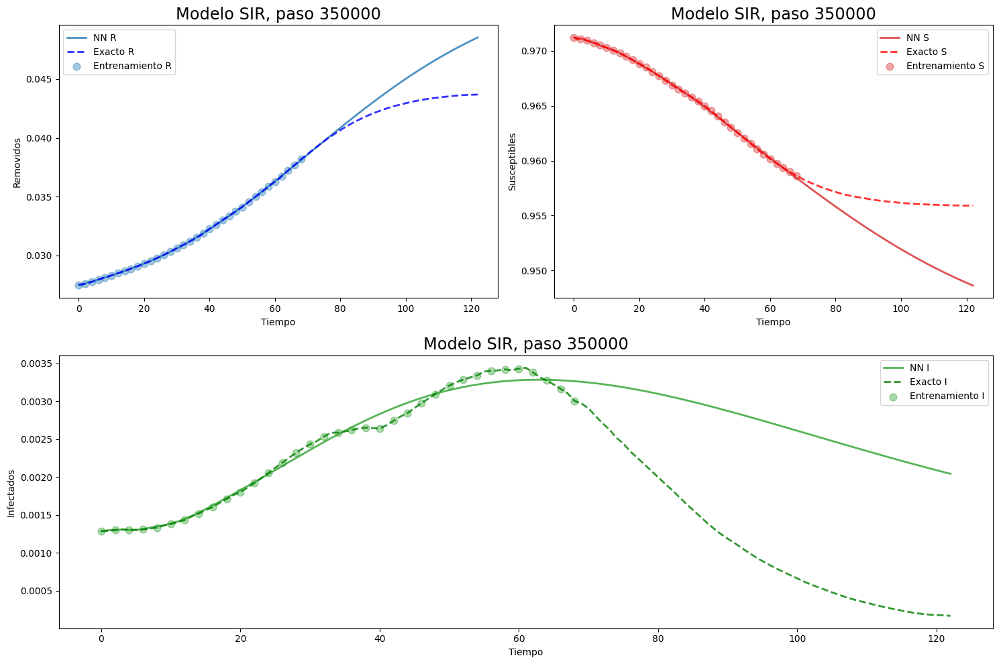

Paso = 350000 , pérdida de datos = 4.9847326e-09 , pérdida física = 1.3496656e-09 , pérdida total = 6.3343983e-09 , mse = 3.8498724e-06 , beta = 0.07434553 , gamma = 0.06900231
Paso = 351000 , pérdida de datos = 1.3142271e-07 , pérdida física = 1.436942e-09 , pérdida total = 1.3285965e-07 , mse = 3.4055722e-06 , beta = 0.07400061 , gamma = 0.0686873
Paso = 352000 , pérdida de datos = 1.9942005e-08 , pérdida física = 1.6222856e-09 , pérdida total = 2.1564292e-08 , mse = 3.910523e-06 , beta = 0.073891126 , gamma = 0.06858738
Paso = 353000 , pérdida de datos = 1.0837353e-07 , pérdida física = 1.447408e-09 , pérdida total = 1.0982094e-07 , mse = 4.264954e-06 , beta = 0.07418071 , gamma = 0.06882974
Paso = 354000 , pérdida de datos = 4.9851114e-09 , pérdida física = 1.3530472e-09 , pérdida total = 6.3381584e-09 , mse = 3.8032445e-06 , beta = 0.0742753 , gamma = 0.06893885
Paso = 355000 , pérdida de datos = 2.0816755e-07 , pérdida física = 1.5439771e-09 , pérdida total = 2.0971153e-07 , mse 

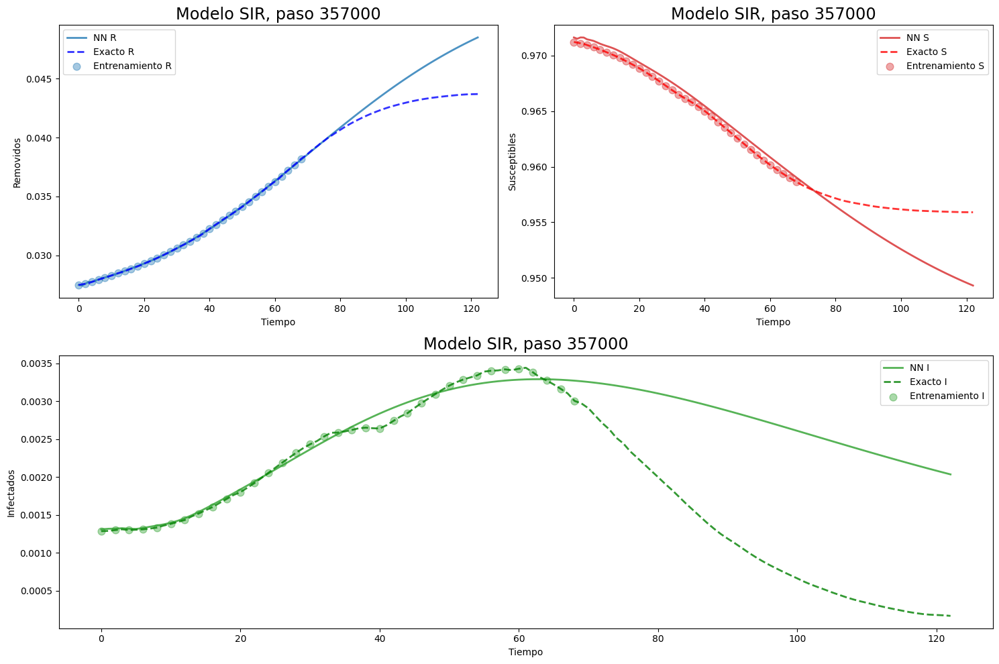

Paso = 357000 , pérdida de datos = 1.2111028e-07 , pérdida física = 1.4658625e-09 , pérdida total = 1.2257614e-07 , mse = 3.2646292e-06 , beta = 0.073980816 , gamma = 0.06868883
Paso = 358000 , pérdida de datos = 5.5297504e-09 , pérdida física = 1.3648473e-09 , pérdida total = 6.894598e-09 , mse = 3.7292818e-06 , beta = 0.074067496 , gamma = 0.06877822
Paso = 359000 , pérdida de datos = 6.559948e-09 , pérdida física = 1.3498083e-09 , pérdida total = 7.909756e-09 , mse = 3.8164167e-06 , beta = 0.07431653 , gamma = 0.06893251
Paso = 360000 , pérdida de datos = 5.0607976e-09 , pérdida física = 1.3681408e-09 , pérdida total = 6.4289383e-09 , mse = 3.7172551e-06 , beta = 0.07385467 , gamma = 0.06851901
Paso = 361000 , pérdida de datos = 5.622153e-09 , pérdida física = 1.3568295e-09 , pérdida total = 6.9789827e-09 , mse = 3.8292415e-06 , beta = 0.07432714 , gamma = 0.06897153
Paso = 362000 , pérdida de datos = 4.9528555e-09 , pérdida física = 1.3624611e-09 , pérdida total = 6.3153167e-09 , m

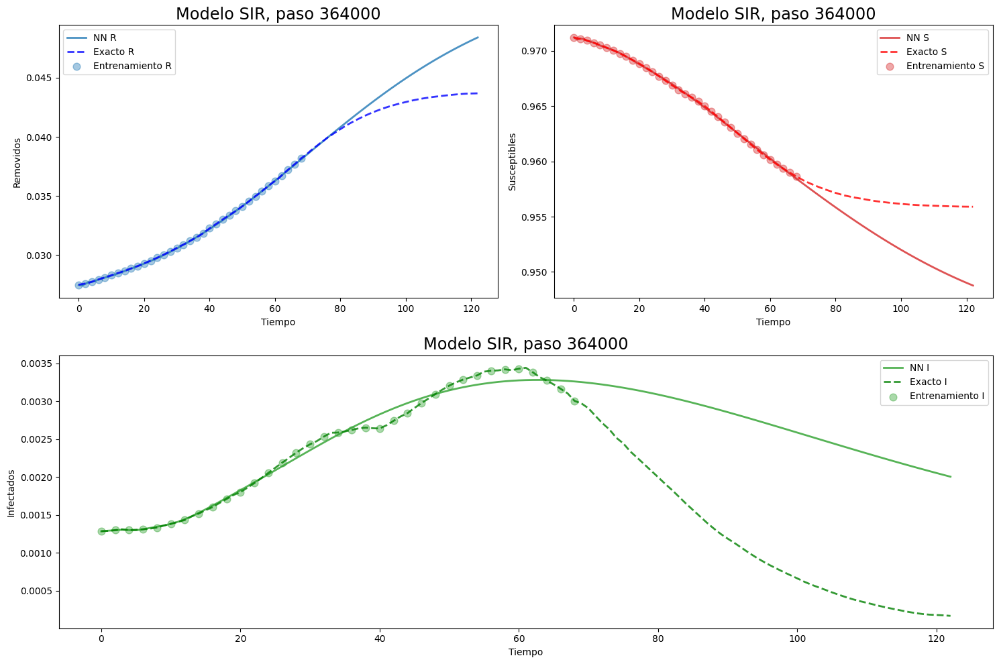

Paso = 364000 , pérdida de datos = 5.1103664e-09 , pérdida física = 1.3700405e-09 , pérdida total = 6.480407e-09 , mse = 3.7011605e-06 , beta = 0.073889524 , gamma = 0.06863313
Paso = 365000 , pérdida de datos = 9.943668e-09 , pérdida física = 1.370443e-09 , pérdida total = 1.1314111e-08 , mse = 3.843889e-06 , beta = 0.07415646 , gamma = 0.06883426
Paso = 366000 , pérdida de datos = 5.1628475e-09 , pérdida física = 1.3757474e-09 , pérdida total = 6.538595e-09 , mse = 3.7430123e-06 , beta = 0.07405661 , gamma = 0.068707675
Paso = 367000 , pérdida de datos = 5.5584217e-09 , pérdida física = 1.3595186e-09 , pérdida total = 6.9179404e-09 , mse = 3.6874903e-06 , beta = 0.074070424 , gamma = 0.06868004
Paso = 368000 , pérdida de datos = 8.750413e-09 , pérdida física = 1.4360785e-09 , pérdida total = 1.0186492e-08 , mse = 3.6588906e-06 , beta = 0.07392189 , gamma = 0.068671726
Paso = 369000 , pérdida de datos = 7.54234e-09 , pérdida física = 1.3784149e-09 , pérdida total = 8.920755e-09 , mse 

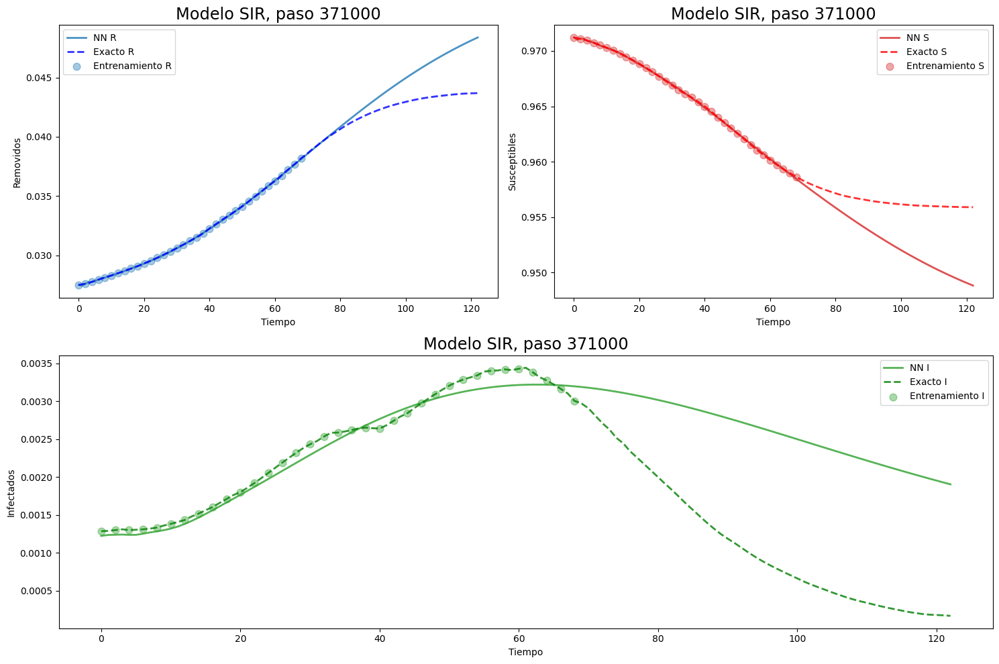

Paso = 371000 , pérdida de datos = 5.745051e-09 , pérdida física = 1.3953771e-09 , pérdida total = 7.1404282e-09 , mse = 3.6260326e-06 , beta = 0.0742004 , gamma = 0.06899842
Paso = 372000 , pérdida de datos = 5.191e-09 , pérdida física = 1.3641089e-09 , pérdida total = 6.555109e-09 , mse = 3.7050486e-06 , beta = 0.07431704 , gamma = 0.06894927
Paso = 373000 , pérdida de datos = 6.1920296e-09 , pérdida física = 1.3865382e-09 , pérdida total = 7.578568e-09 , mse = 3.661142e-06 , beta = 0.07380162 , gamma = 0.068598084
Paso = 374000 , pérdida de datos = 1.3182791e-08 , pérdida física = 1.3685069e-09 , pérdida total = 1.4551298e-08 , mse = 3.4715674e-06 , beta = 0.074282564 , gamma = 0.068991974
Paso = 375000 , pérdida de datos = 4.9323448e-09 , pérdida física = 1.3787258e-09 , pérdida total = 6.3110708e-09 , mse = 3.6622607e-06 , beta = 0.07420843 , gamma = 0.068989545
Paso = 376000 , pérdida de datos = 2.6782867e-08 , pérdida física = 1.517051e-09 , pérdida total = 2.8299919e-08 , mse =

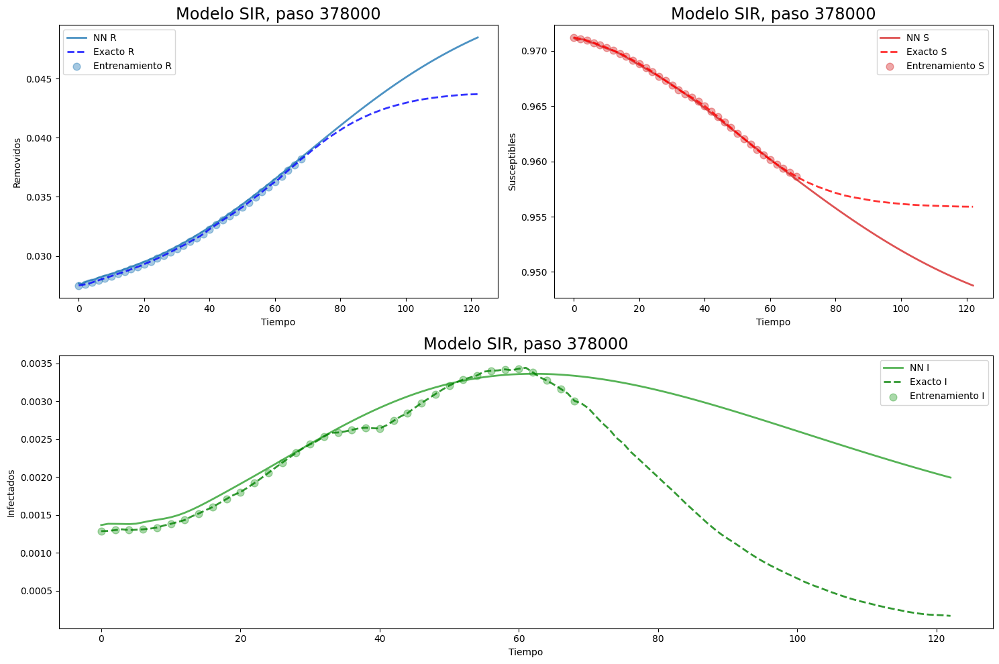

Paso = 378000 , pérdida de datos = 2.6113568e-08 , pérdida física = 1.4276216e-09 , pérdida total = 2.754119e-08 , mse = 3.830874e-06 , beta = 0.07404727 , gamma = 0.068868704
Paso = 379000 , pérdida de datos = 6.1065974e-09 , pérdida física = 1.3887781e-09 , pérdida total = 7.495376e-09 , mse = 3.6801925e-06 , beta = 0.07422238 , gamma = 0.06889521
Paso = 380000 , pérdida de datos = 7.992446e-09 , pérdida física = 1.3965764e-09 , pérdida total = 9.389022e-09 , mse = 3.6377712e-06 , beta = 0.07390807 , gamma = 0.06867724
Paso = 381000 , pérdida de datos = 5.1208646e-09 , pérdida física = 1.3857459e-09 , pérdida total = 6.5066104e-09 , mse = 3.5803712e-06 , beta = 0.07423552 , gamma = 0.068983905
Paso = 382000 , pérdida de datos = 1.676778e-07 , pérdida física = 1.6010768e-09 , pérdida total = 1.6927888e-07 , mse = 4.3267914e-06 , beta = 0.07411991 , gamma = 0.06894522
Paso = 383000 , pérdida de datos = 7.1194473e-09 , pérdida física = 1.380933e-09 , pérdida total = 8.50038e-09 , mse = 

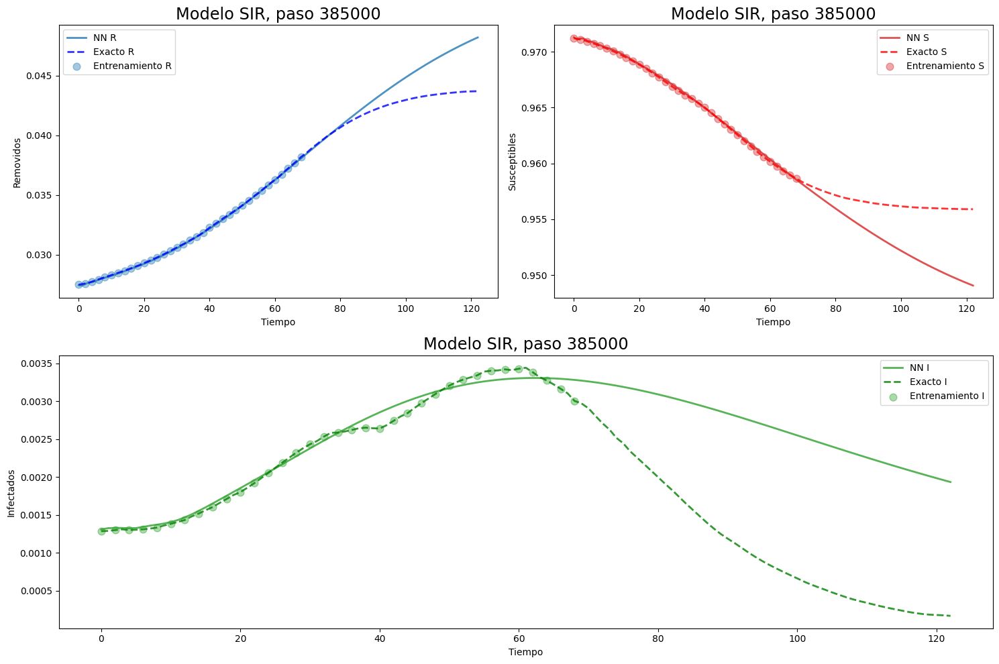

Paso = 385000 , pérdida de datos = 8.319745e-09 , pérdida física = 1.4168128e-09 , pérdida total = 9.736557e-09 , mse = 3.3958388e-06 , beta = 0.074086875 , gamma = 0.06887504
Paso = 386000 , pérdida de datos = 1.8625485e-08 , pérdida física = 1.6239717e-09 , pérdida total = 2.0249457e-08 , mse = 3.4340571e-06 , beta = 0.07389928 , gamma = 0.0687586
Paso = 387000 , pérdida de datos = 4.0977877e-08 , pérdida física = 1.4335678e-09 , pérdida total = 4.2411443e-08 , mse = 3.2960816e-06 , beta = 0.07389354 , gamma = 0.06878329
Paso = 388000 , pérdida de datos = 6.2950005e-09 , pérdida física = 1.4024103e-09 , pérdida total = 7.697411e-09 , mse = 3.4408122e-06 , beta = 0.07379107 , gamma = 0.0686775
Paso = 389000 , pérdida de datos = 8.0995e-08 , pérdida física = 2.9109342e-09 , pérdida total = 8.390594e-08 , mse = 3.4136206e-06 , beta = 0.0737481 , gamma = 0.06866033
Paso = 390000 , pérdida de datos = 4.892881e-09 , pérdida física = 1.408626e-09 , pérdida total = 6.3015073e-09 , mse = 3.48

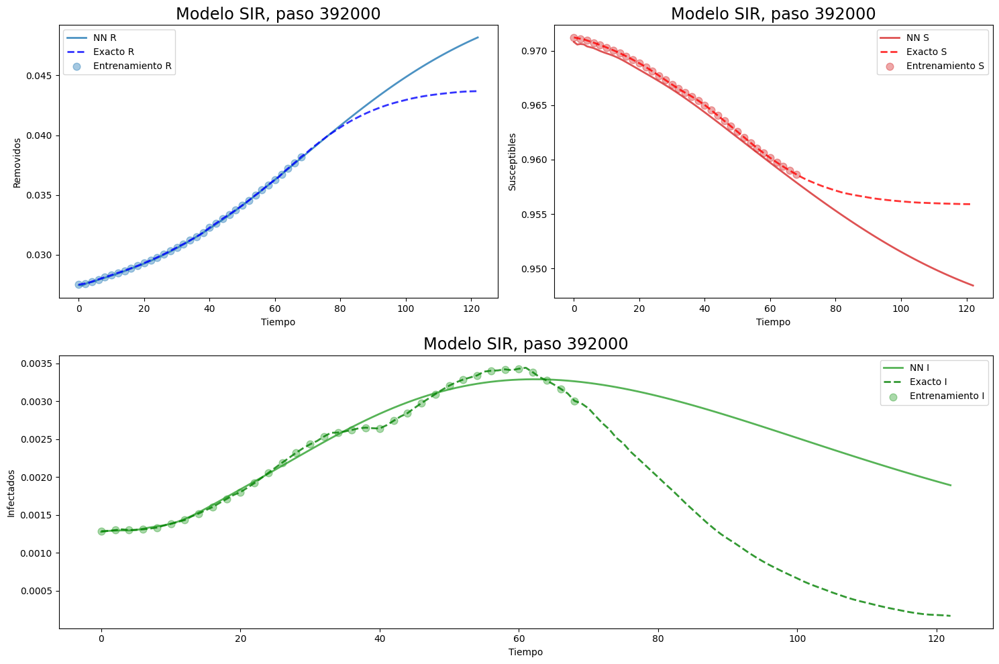

Paso = 392000 , pérdida de datos = 1.1792385e-07 , pérdida física = 1.4938669e-09 , pérdida total = 1.1941772e-07 , mse = 4.1448093e-06 , beta = 0.07408506 , gamma = 0.068998486
Paso = 393000 , pérdida de datos = 3.4044994e-08 , pérdida física = 1.4348359e-09 , pérdida total = 3.547983e-08 , mse = 3.3485035e-06 , beta = 0.07404641 , gamma = 0.068960786
Paso = 394000 , pérdida de datos = 5.0697144e-09 , pérdida física = 1.4157799e-09 , pérdida total = 6.4854944e-09 , mse = 3.4792906e-06 , beta = 0.074139565 , gamma = 0.06897479
Paso = 395000 , pérdida de datos = 1.5606329e-08 , pérdida física = 1.4446647e-09 , pérdida total = 1.7050994e-08 , mse = 3.1569928e-06 , beta = 0.07397524 , gamma = 0.06888953
Paso = 396000 , pérdida de datos = 5.1609526e-09 , pérdida física = 1.4197805e-09 , pérdida total = 6.5807333e-09 , mse = 3.4877357e-06 , beta = 0.07413504 , gamma = 0.06907472
Paso = 397000 , pérdida de datos = 6.026259e-09 , pérdida física = 1.4230666e-09 , pérdida total = 7.4493256e-09 

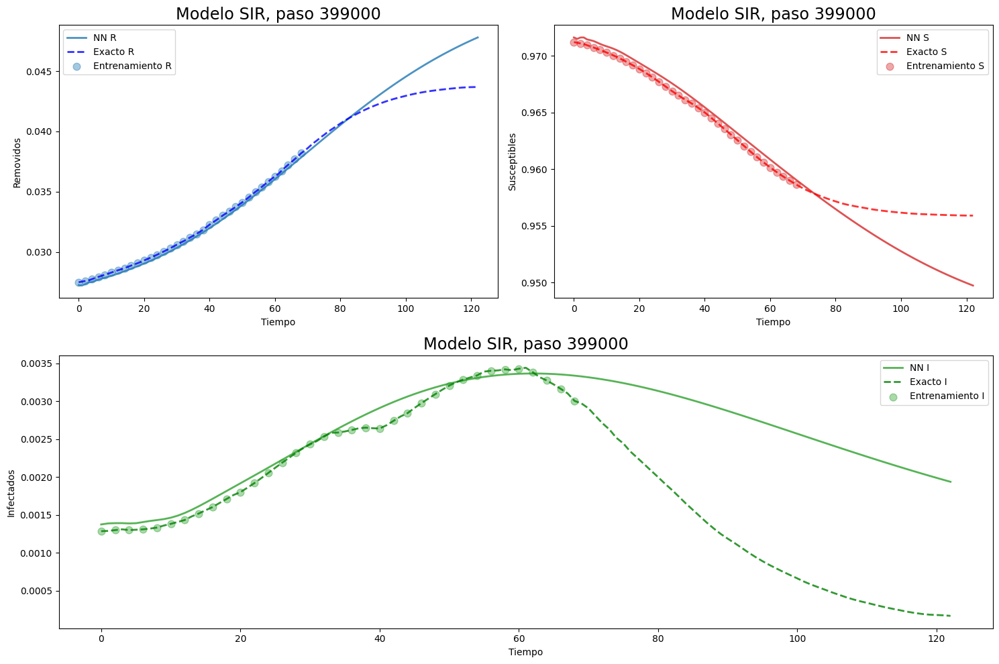

Paso = 399000 , pérdida de datos = 1.1260827e-07 , pérdida física = 1.5860142e-09 , pérdida total = 1.14194286e-07 , mse = 2.786452e-06 , beta = 0.07405837 , gamma = 0.06899726
Paso = 400000 , pérdida de datos = 4.2598856e-08 , pérdida física = 1.480634e-09 , pérdida total = 4.407949e-08 , mse = 3.8221356e-06 , beta = 0.0740318 , gamma = 0.068993926
Paso = 401000 , pérdida de datos = 3.1895178e-07 , pérdida física = 1.7709867e-09 , pérdida total = 3.2072276e-07 , mse = 4.583281e-06 , beta = 0.07406079 , gamma = 0.06904624
Paso = 402000 , pérdida de datos = 8.3447045e-09 , pérdida física = 1.4231056e-09 , pérdida total = 9.76781e-09 , mse = 3.29277e-06 , beta = 0.07408644 , gamma = 0.068982325
Paso = 403000 , pérdida de datos = 4.8105915e-09 , pérdida física = 1.4395439e-09 , pérdida total = 6.2501355e-09 , mse = 3.371023e-06 , beta = 0.07400054 , gamma = 0.068995394
Paso = 404000 , pérdida de datos = 2.6333709e-08 , pérdida física = 1.4510481e-09 , pérdida total = 2.7784756e-08 , mse =

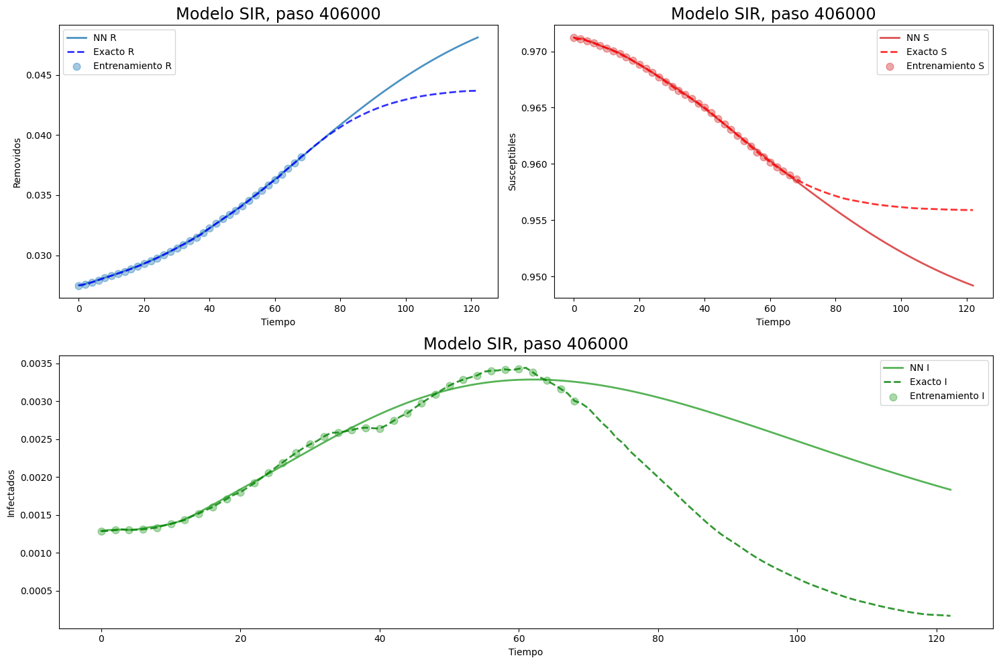

Paso = 406000 , pérdida de datos = 5.0177604e-09 , pérdida física = 1.4462225e-09 , pérdida total = 6.463983e-09 , mse = 3.319797e-06 , beta = 0.073872134 , gamma = 0.06889049
Paso = 407000 , pérdida de datos = 5.9044214e-09 , pérdida física = 1.4570632e-09 , pérdida total = 7.3614848e-09 , mse = 3.3338822e-06 , beta = 0.07404774 , gamma = 0.06905146
Paso = 408000 , pérdida de datos = 7.939923e-09 , pérdida física = 1.4495682e-09 , pérdida total = 9.389492e-09 , mse = 3.4170973e-06 , beta = 0.07399979 , gamma = 0.06899202
Paso = 409000 , pérdida de datos = 2.0413696e-08 , pérdida física = 1.4939678e-09 , pérdida total = 2.1907663e-08 , mse = 3.190122e-06 , beta = 0.0740585 , gamma = 0.06903252
Paso = 410000 , pérdida de datos = 4.915236e-09 , pérdida física = 1.4519305e-09 , pérdida total = 6.367167e-09 , mse = 3.2803734e-06 , beta = 0.073800884 , gamma = 0.06883545
Paso = 411000 , pérdida de datos = 1.672378e-07 , pérdida física = 1.5736075e-09 , pérdida total = 1.6881141e-07 , mse = 

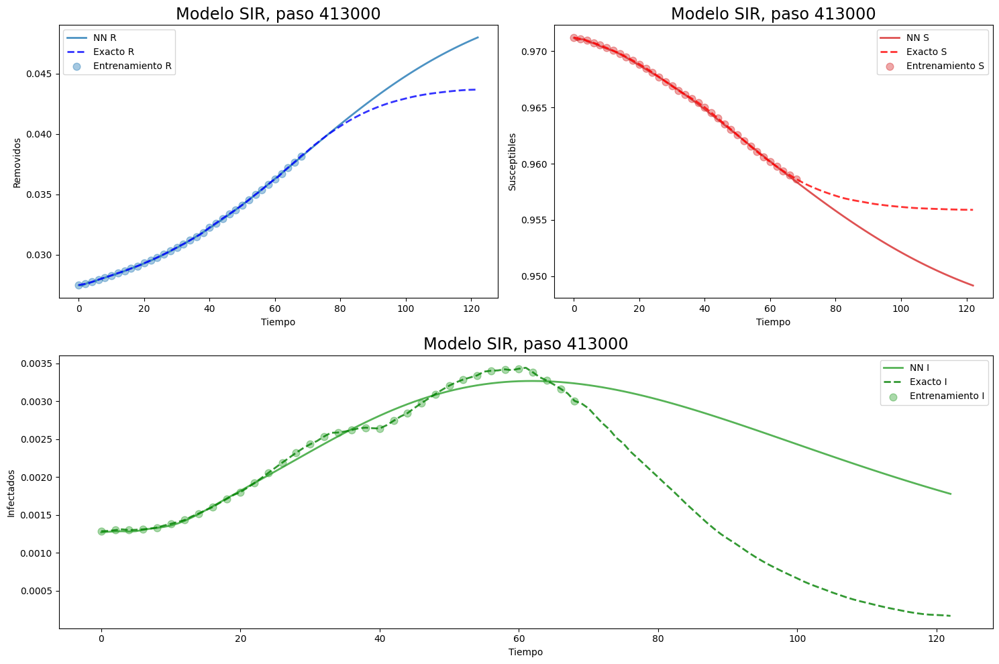

Paso = 413000 , pérdida de datos = 7.2407773e-09 , pérdida física = 1.4542881e-09 , pérdida total = 8.695065e-09 , mse = 3.3133606e-06 , beta = 0.073923975 , gamma = 0.06894513
Paso = 414000 , pérdida de datos = 4.888453e-09 , pérdida física = 1.4587345e-09 , pérdida total = 6.3471877e-09 , mse = 3.2848466e-06 , beta = 0.074061 , gamma = 0.06910776
Paso = 415000 , pérdida de datos = 1.0244408e-08 , pérdida física = 1.4647276e-09 , pérdida total = 1.1709136e-08 , mse = 3.2865264e-06 , beta = 0.07393525 , gamma = 0.069002114
Paso = 416000 , pérdida de datos = 4.7037663e-09 , pérdida física = 1.4692251e-09 , pérdida total = 6.1729915e-09 , mse = 3.2217079e-06 , beta = 0.074003 , gamma = 0.06909287
Paso = 417000 , pérdida de datos = 1.5365055e-08 , pérdida física = 1.733109e-09 , pérdida total = 1.7098165e-08 , mse = 3.3537901e-06 , beta = 0.07372121 , gamma = 0.06880913
Paso = 418000 , pérdida de datos = 5.4203637e-09 , pérdida física = 1.4641663e-09 , pérdida total = 6.8845303e-09 , mse 

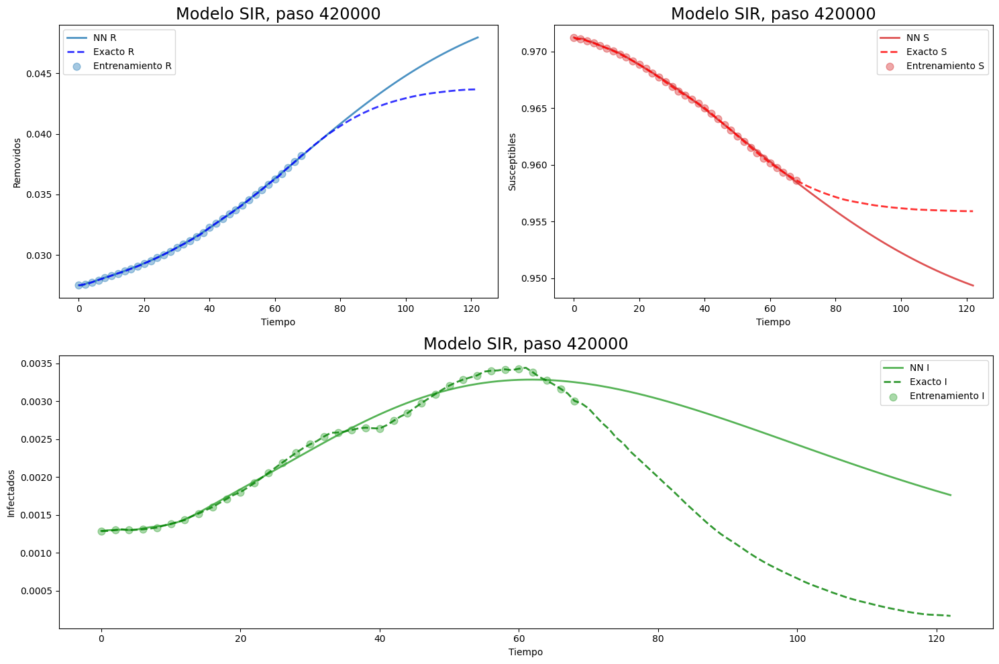

Paso = 420000 , pérdida de datos = 4.75689e-09 , pérdida física = 1.4715316e-09 , pérdida total = 6.2284213e-09 , mse = 3.1776447e-06 , beta = 0.07398711 , gamma = 0.06903989
Paso = 421000 , pérdida de datos = 1.7370803e-08 , pérdida física = 1.655177e-09 , pérdida total = 1.902598e-08 , mse = 3.2675648e-06 , beta = 0.07379068 , gamma = 0.068895414
Paso = 422000 , pérdida de datos = 4.9803073e-09 , pérdida física = 1.4788317e-09 , pérdida total = 6.459139e-09 , mse = 3.2101477e-06 , beta = 0.07397175 , gamma = 0.06905465
Paso = 423000 , pérdida de datos = 5.892599e-09 , pérdida física = 1.4973552e-09 , pérdida total = 7.389954e-09 , mse = 3.0921196e-06 , beta = 0.07395009 , gamma = 0.06905272
Paso = 424000 , pérdida de datos = 1.9693298e-08 , pérdida física = 1.5546139e-09 , pérdida total = 2.1247912e-08 , mse = 2.8463871e-06 , beta = 0.073711574 , gamma = 0.06885557
Paso = 425000 , pérdida de datos = 9.592185e-09 , pérdida física = 1.4962482e-09 , pérdida total = 1.1088433e-08 , mse =

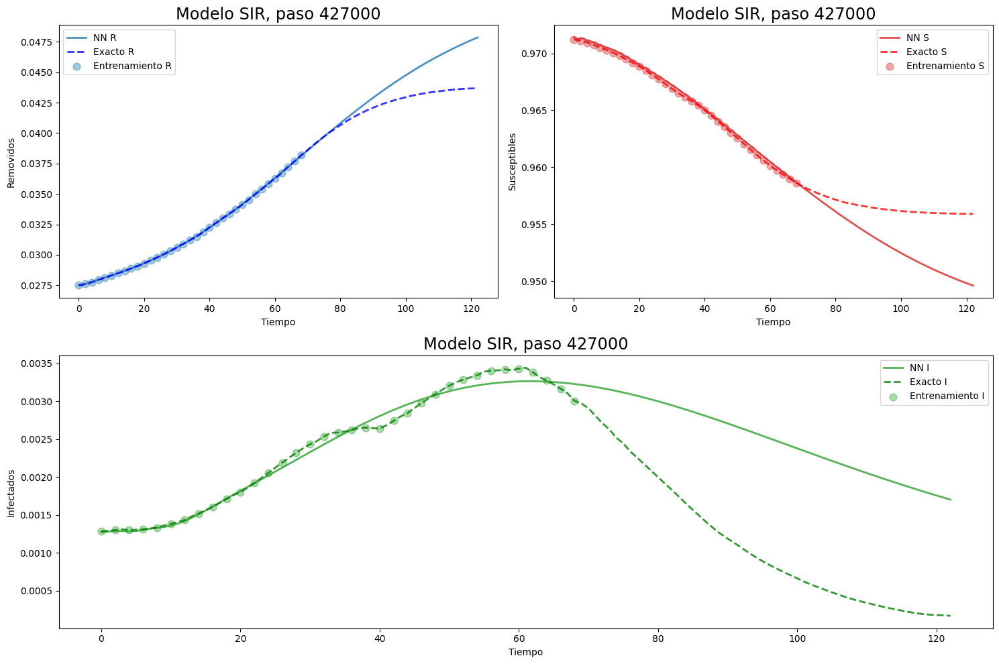

Paso = 427000 , pérdida de datos = 1.3597021e-08 , pérdida física = 1.5045183e-09 , pérdida total = 1.510154e-08 , mse = 2.904847e-06 , beta = 0.07389239 , gamma = 0.06901411
Paso = 428000 , pérdida de datos = 3.2032037e-08 , pérdida física = 1.5366681e-09 , pérdida total = 3.3568707e-08 , mse = 3.216812e-06 , beta = 0.07390243 , gamma = 0.06901885
Paso = 429000 , pérdida de datos = 6.890953e-09 , pérdida física = 1.5059487e-09 , pérdida total = 8.396902e-09 , mse = 2.9610057e-06 , beta = 0.07385426 , gamma = 0.06899442
Paso = 430000 , pérdida de datos = 9.7603765e-09 , pérdida física = 1.5126012e-09 , pérdida total = 1.1272977e-08 , mse = 2.9720725e-06 , beta = 0.073907636 , gamma = 0.06901693
Paso = 431000 , pérdida de datos = 2.122963e-08 , pérdida física = 1.5102546e-09 , pérdida total = 2.2739885e-08 , mse = 2.977808e-06 , beta = 0.073883 , gamma = 0.06907267
Paso = 432000 , pérdida de datos = 1.9243323e-08 , pérdida física = 1.544808e-09 , pérdida total = 2.0788132e-08 , mse = 2.

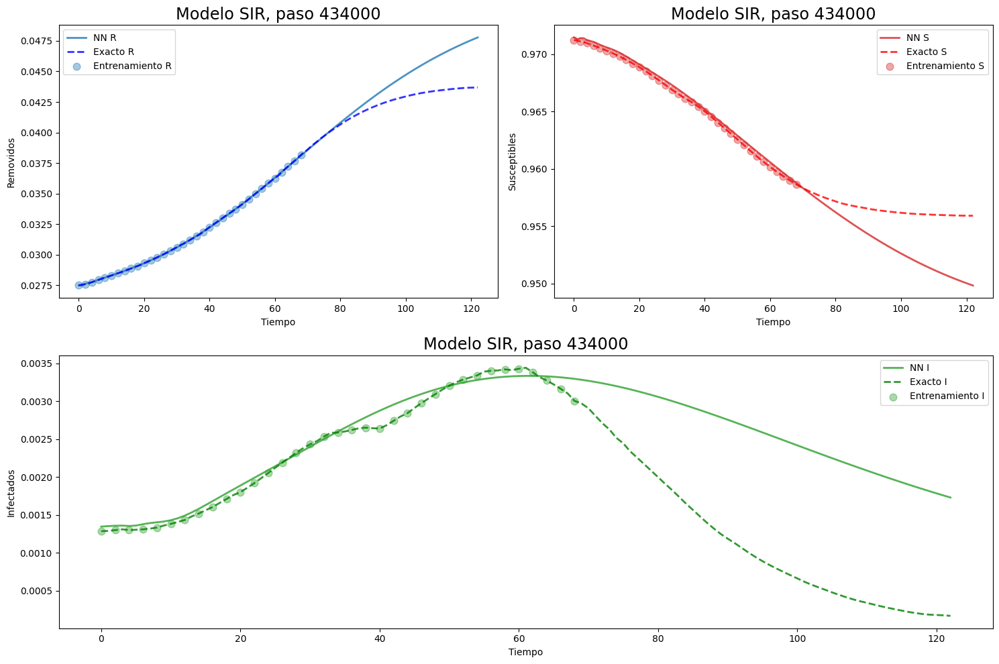

Paso = 434000 , pérdida de datos = 8.033884e-08 , pérdida física = 1.7019964e-09 , pérdida total = 8.204084e-08 , mse = 2.7681551e-06 , beta = 0.073762596 , gamma = 0.06899969
Paso = 435000 , pérdida de datos = 5.339236e-09 , pérdida física = 1.5162445e-09 , pérdida total = 6.8554806e-09 , mse = 2.9738997e-06 , beta = 0.073851824 , gamma = 0.069052875
Paso = 436000 , pérdida de datos = 4.6594844e-09 , pérdida física = 1.5254545e-09 , pérdida total = 6.184939e-09 , mse = 2.98918e-06 , beta = 0.07380202 , gamma = 0.06904878
Paso = 437000 , pérdida de datos = 7.725422e-09 , pérdida física = 1.5248849e-09 , pérdida total = 9.250307e-09 , mse = 3.002607e-06 , beta = 0.07385503 , gamma = 0.06906793
Paso = 438000 , pérdida de datos = 2.5371929e-08 , pérdida física = 1.5715472e-09 , pérdida total = 2.6943475e-08 , mse = 2.8600036e-06 , beta = 0.07382299 , gamma = 0.068952166
Paso = 439000 , pérdida de datos = 7.553177e-09 , pérdida física = 1.5528288e-09 , pérdida total = 9.106006e-09 , mse = 

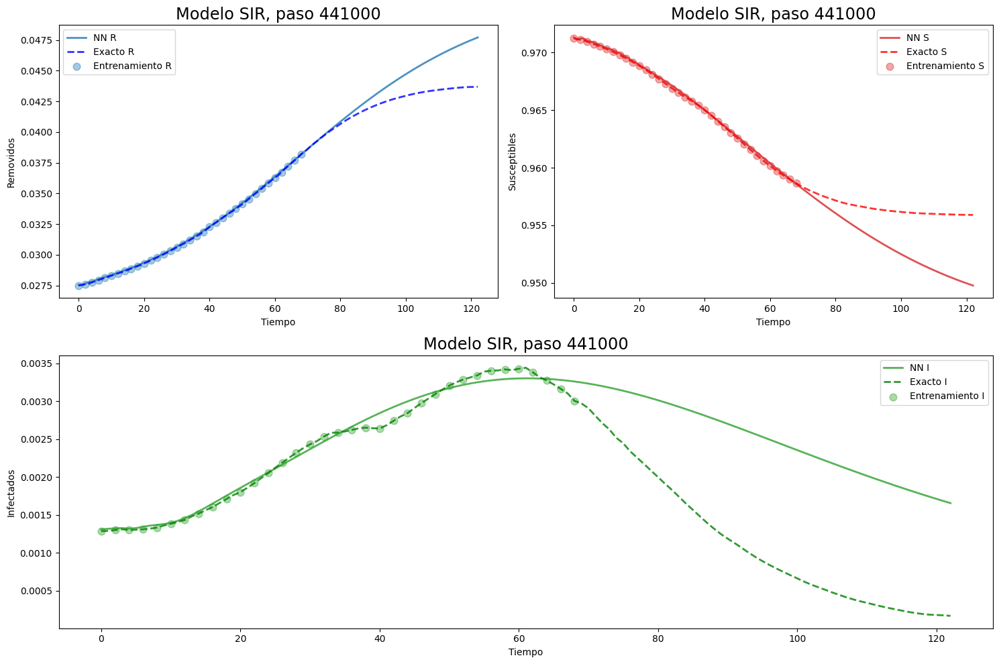

Paso = 441000 , pérdida de datos = 1.5627347e-08 , pérdida física = 1.5470547e-09 , pérdida total = 1.71744e-08 , mse = 2.8008133e-06 , beta = 0.07375002 , gamma = 0.068999186
Paso = 442000 , pérdida de datos = 9.315488e-09 , pérdida física = 1.5754945e-09 , pérdida total = 1.0890982e-08 , mse = 2.771059e-06 , beta = 0.07348617 , gamma = 0.06879095
Paso = 443000 , pérdida de datos = 1.6408202e-07 , pérdida física = 1.756127e-09 , pérdida total = 1.6583814e-07 , mse = 3.8353105e-06 , beta = 0.07366143 , gamma = 0.06897647
Paso = 444000 , pérdida de datos = 1.7352786e-08 , pérdida física = 1.7518497e-09 , pérdida total = 1.9104636e-08 , mse = 2.7988287e-06 , beta = 0.07340777 , gamma = 0.06871397
Paso = 445000 , pérdida de datos = 4.5888386e-09 , pérdida física = 1.5585395e-09 , pérdida total = 6.147378e-09 , mse = 2.8526142e-06 , beta = 0.07348873 , gamma = 0.06883132
Paso = 446000 , pérdida de datos = 6.1881567e-09 , pérdida física = 1.5596201e-09 , pérdida total = 7.747777e-09 , mse =

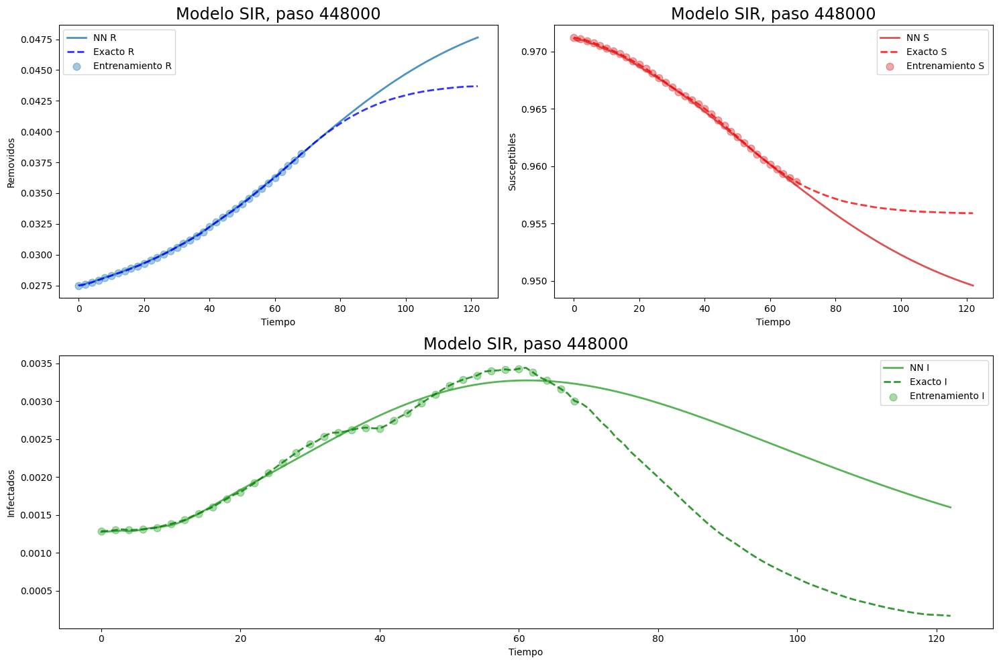

Paso = 448000 , pérdida de datos = 1.0637684e-08 , pérdida física = 1.5626088e-09 , pérdida total = 1.2200292e-08 , mse = 2.9658408e-06 , beta = 0.073661715 , gamma = 0.06899938
Paso = 449000 , pérdida de datos = 4.8530313e-09 , pérdida física = 1.5646286e-09 , pérdida total = 6.41766e-09 , mse = 2.8512882e-06 , beta = 0.07375765 , gamma = 0.06907078
Paso = 450000 , pérdida de datos = 1.07829024e-07 , pérdida física = 1.9336488e-09 , pérdida total = 1.09762674e-07 , mse = 3.4149537e-06 , beta = 0.07337059 , gamma = 0.068746895
Paso = 451000 , pérdida de datos = 9.907931e-09 , pérdida física = 1.576902e-09 , pérdida total = 1.14848335e-08 , mse = 2.6733753e-06 , beta = 0.07366033 , gamma = 0.069002636
Paso = 452000 , pérdida de datos = 4.5841246e-09 , pérdida física = 1.573889e-09 , pérdida total = 6.1580137e-09 , mse = 2.772247e-06 , beta = 0.0737173 , gamma = 0.06907941
Paso = 453000 , pérdida de datos = 1.13776215e-08 , pérdida física = 1.6059606e-09 , pérdida total = 1.2983582e-08 ,

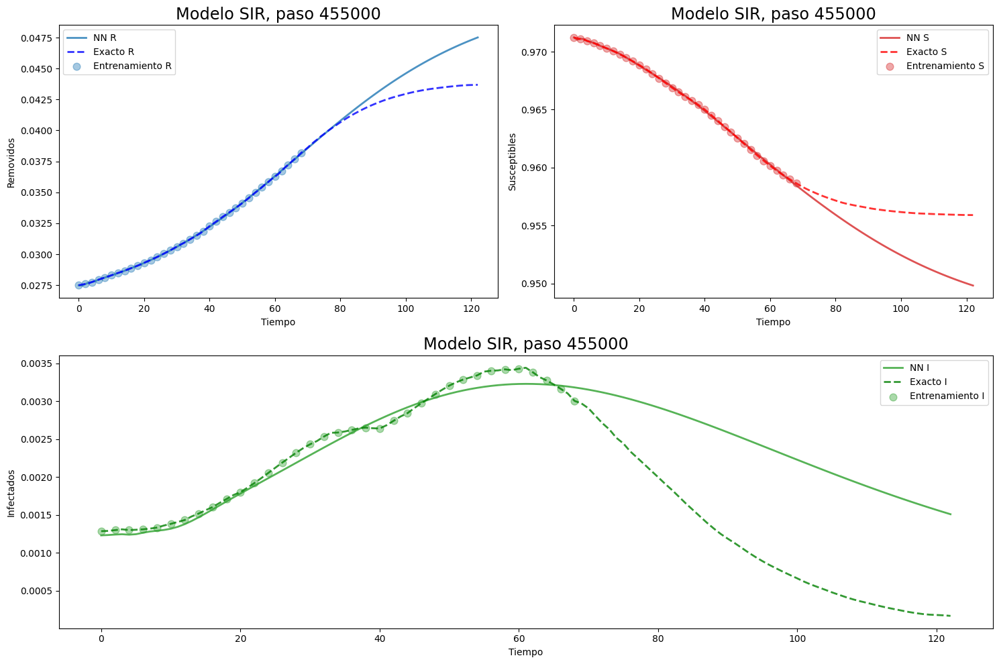

Paso = 455000 , pérdida de datos = 3.9030823e-08 , pérdida física = 1.6922004e-09 , pérdida total = 4.0723023e-08 , mse = 2.7155754e-06 , beta = 0.073559105 , gamma = 0.068979815
Paso = 456000 , pérdida de datos = 6.935633e-09 , pérdida física = 1.6147694e-09 , pérdida total = 8.550402e-09 , mse = 2.6502698e-06 , beta = 0.073570274 , gamma = 0.06893471
Paso = 457000 , pérdida de datos = 5.908443e-08 , pérdida física = 1.6836836e-09 , pérdida total = 6.0768116e-08 , mse = 3.1882266e-06 , beta = 0.07352863 , gamma = 0.06893087
Paso = 458000 , pérdida de datos = 1.3109101e-07 , pérdida física = 3.9361465e-09 , pérdida total = 1.3502716e-07 , mse = 2.2718154e-06 , beta = 0.073481776 , gamma = 0.068905346
Paso = 459000 , pérdida de datos = 5.3740608e-09 , pérdida física = 1.6192953e-09 , pérdida total = 6.993356e-09 , mse = 2.7010938e-06 , beta = 0.07351066 , gamma = 0.068882234
Paso = 460000 , pérdida de datos = 1.924241e-08 , pérdida física = 1.6195122e-09 , pérdida total = 2.0861922e-08 

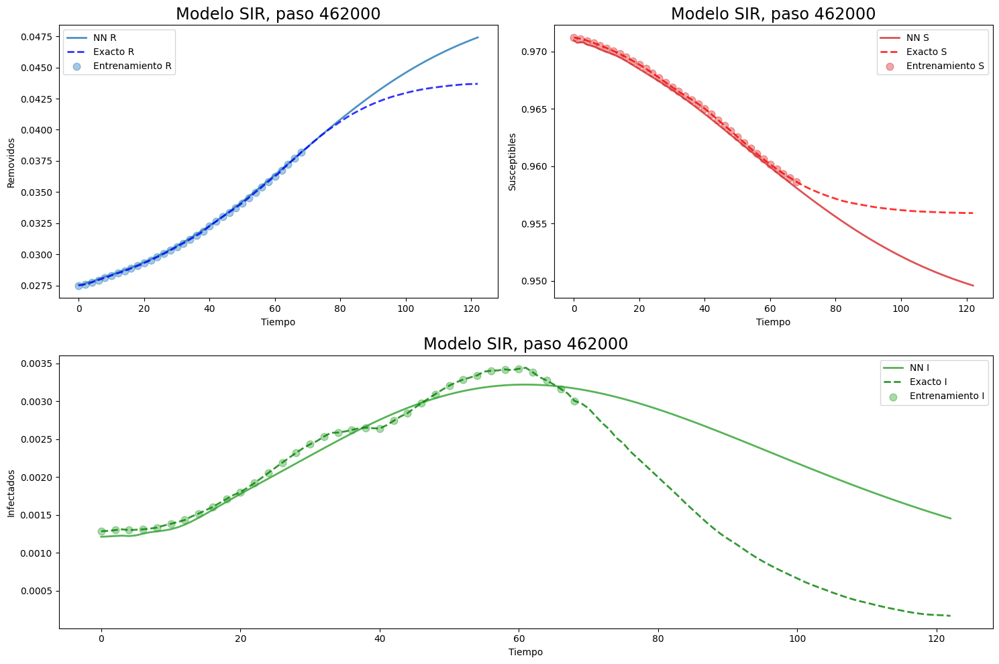

Paso = 462000 , pérdida de datos = 7.630403e-08 , pérdida física = 1.6403916e-09 , pérdida total = 7.794443e-08 , mse = 2.980585e-06 , beta = 0.07347847 , gamma = 0.06883413
Paso = 463000 , pérdida de datos = 6.6288153e-09 , pérdida física = 1.6525037e-09 , pérdida total = 8.281319e-09 , mse = 2.661101e-06 , beta = 0.0736159 , gamma = 0.06906935
Paso = 464000 , pérdida de datos = 1.5241048e-08 , pérdida física = 1.6286945e-09 , pérdida total = 1.6869741e-08 , mse = 2.7723024e-06 , beta = 0.07355946 , gamma = 0.069030665
Paso = 465000 , pérdida de datos = 2.372494e-08 , pérdida física = 1.6509856e-09 , pérdida total = 2.5375925e-08 , mse = 2.637754e-06 , beta = 0.073557526 , gamma = 0.06903834
Paso = 466000 , pérdida de datos = 3.5775145e-07 , pérdida física = 2.6746632e-09 , pérdida total = 3.604261e-07 , mse = 3.4772513e-06 , beta = 0.07346745 , gamma = 0.06897592
Paso = 467000 , pérdida de datos = 1.7910049e-08 , pérdida física = 1.6459363e-09 , pérdida total = 1.9555985e-08 , mse = 

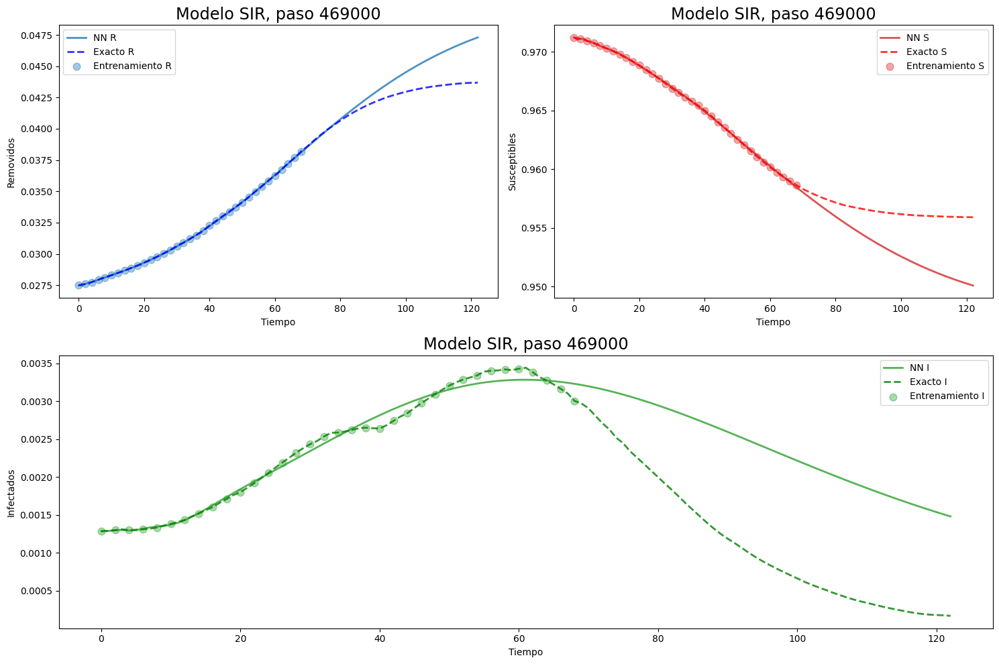

Paso = 469000 , pérdida de datos = 4.5522657e-09 , pérdida física = 1.6354399e-09 , pérdida total = 6.1877055e-09 , mse = 2.5179097e-06 , beta = 0.07356702 , gamma = 0.069038905
Paso = 470000 , pérdida de datos = 4.362653e-09 , pérdida física = 1.6443344e-09 , pérdida total = 6.0069874e-09 , mse = 2.5017755e-06 , beta = 0.0734697 , gamma = 0.06899152
Paso = 471000 , pérdida de datos = 4.404104e-09 , pérdida física = 1.6469406e-09 , pérdida total = 6.051045e-09 , mse = 2.4778483e-06 , beta = 0.07353233 , gamma = 0.06904634
Paso = 472000 , pérdida de datos = 3.0923903e-08 , pérdida física = 1.710875e-09 , pérdida total = 3.263478e-08 , mse = 2.5383213e-06 , beta = 0.07331551 , gamma = 0.06885237
Paso = 473000 , pérdida de datos = 4.599581e-09 , pérdida física = 1.6502725e-09 , pérdida total = 6.2498535e-09 , mse = 2.4852293e-06 , beta = 0.073560886 , gamma = 0.06906703
Paso = 474000 , pérdida de datos = 5.5687073e-09 , pérdida física = 1.6567675e-09 , pérdida total = 7.225475e-09 , mse =

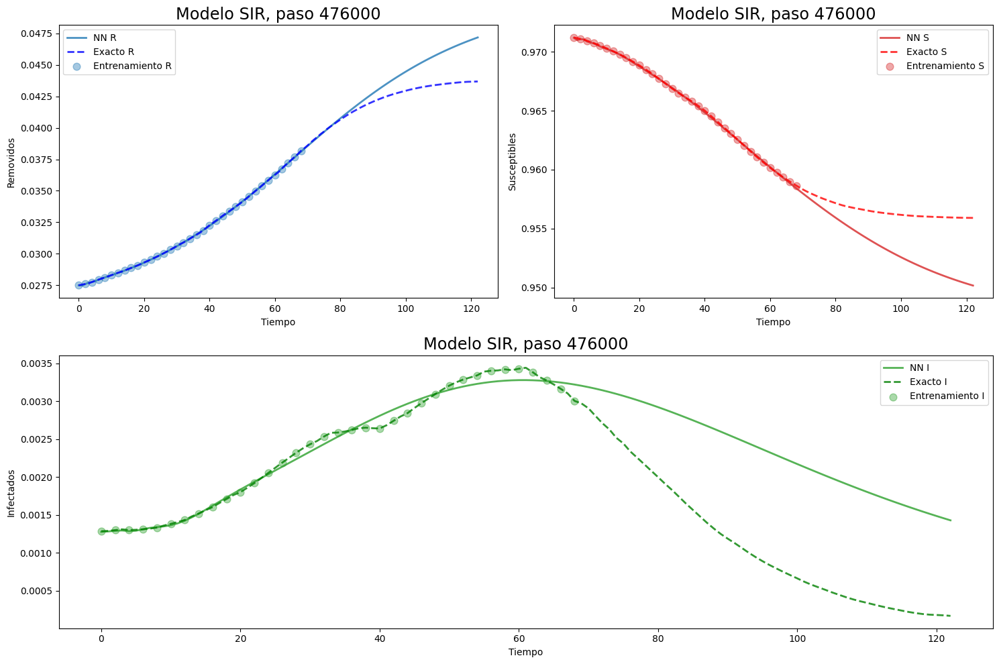

Paso = 476000 , pérdida de datos = 5.101897e-09 , pérdida física = 1.6636496e-09 , pérdida total = 6.765547e-09 , mse = 2.4513665e-06 , beta = 0.07349202 , gamma = 0.069026485
Paso = 477000 , pérdida de datos = 6.093594e-09 , pérdida física = 1.6880505e-09 , pérdida total = 7.781645e-09 , mse = 2.3240154e-06 , beta = 0.07340758 , gamma = 0.06896802
Paso = 478000 , pérdida de datos = 5.24347e-09 , pérdida física = 1.6768971e-09 , pérdida total = 6.9203674e-09 , mse = 2.405062e-06 , beta = 0.07326447 , gamma = 0.06886128
Paso = 479000 , pérdida de datos = 2.0985262e-08 , pérdida física = 1.6959615e-09 , pérdida total = 2.2681222e-08 , mse = 2.2984511e-06 , beta = 0.07340468 , gamma = 0.06894006
Paso = 480000 , pérdida de datos = 1.0072438e-08 , pérdida física = 1.7495415e-09 , pérdida total = 1.182198e-08 , mse = 2.3347936e-06 , beta = 0.07339303 , gamma = 0.0689499
Paso = 481000 , pérdida de datos = 3.884192e-08 , pérdida física = 2.670793e-09 , pérdida total = 4.1512713e-08 , mse = 2.5

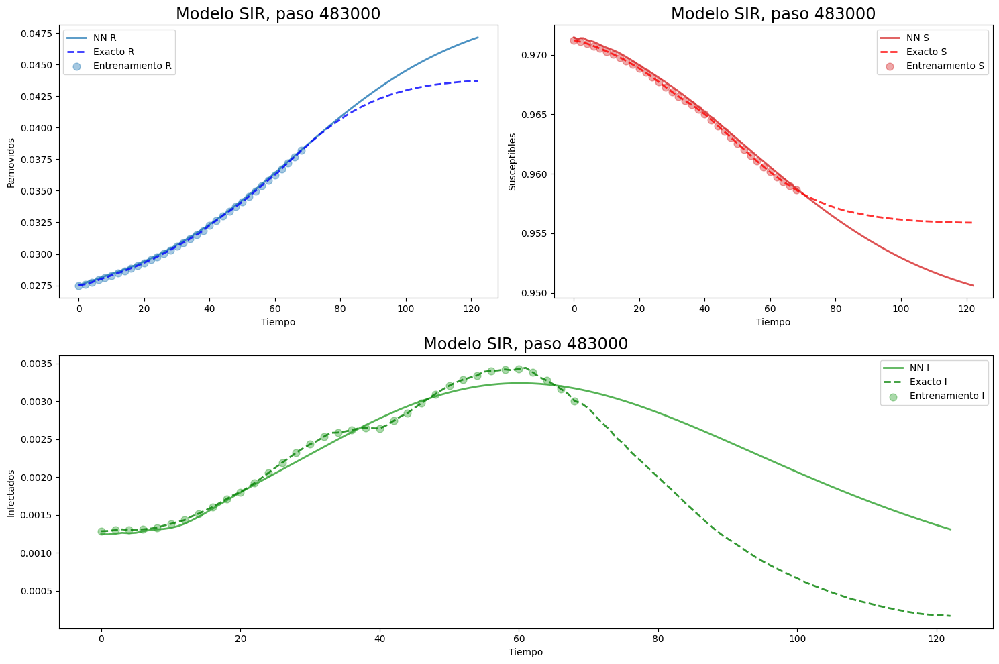

Paso = 483000 , pérdida de datos = 1.45742e-07 , pérdida física = 2.0136361e-09 , pérdida total = 1.4775564e-07 , mse = 2.1020926e-06 , beta = 0.07318135 , gamma = 0.068856336
Paso = 484000 , pérdida de datos = 9.496158e-09 , pérdida física = 1.7386885e-09 , pérdida total = 1.1234846e-08 , mse = 2.2085637e-06 , beta = 0.073185794 , gamma = 0.06880273
Paso = 485000 , pérdida de datos = 7.4159e-08 , pérdida física = 1.8053374e-09 , pérdida total = 7.596434e-08 , mse = 1.8427556e-06 , beta = 0.0730759 , gamma = 0.06876024
Paso = 486000 , pérdida de datos = 4.682648e-09 , pérdida física = 1.7099933e-09 , pérdida total = 6.392641e-09 , mse = 2.2755514e-06 , beta = 0.073391825 , gamma = 0.06903833
Paso = 487000 , pérdida de datos = 4.2251918e-09 , pérdida física = 1.7183507e-09 , pérdida total = 5.9435425e-09 , mse = 2.2301533e-06 , beta = 0.0733762 , gamma = 0.069062114
Paso = 488000 , pérdida de datos = 1.4660272e-08 , pérdida física = 1.7662096e-09 , pérdida total = 1.6426482e-08 , mse = 

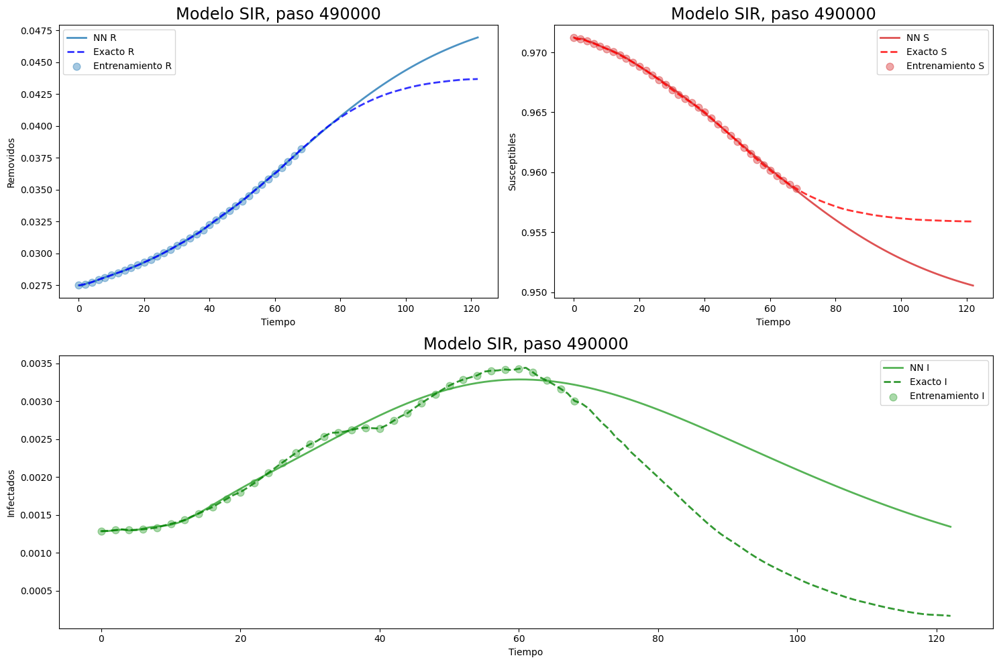

Paso = 490000 , pérdida de datos = 4.4088035e-09 , pérdida física = 1.7359517e-09 , pérdida total = 6.1447554e-09 , mse = 2.141918e-06 , beta = 0.0733198 , gamma = 0.069029875
Paso = 491000 , pérdida de datos = 5.940745e-09 , pérdida física = 1.7457217e-09 , pérdida total = 7.686467e-09 , mse = 2.1495846e-06 , beta = 0.07335957 , gamma = 0.06903588
Paso = 492000 , pérdida de datos = 9.398892e-09 , pérdida física = 1.7414253e-09 , pérdida total = 1.1140318e-08 , mse = 2.0180944e-06 , beta = 0.073289074 , gamma = 0.06897601
Paso = 493000 , pérdida de datos = 1.2182402e-07 , pérdida física = 3.0575564e-09 , pérdida total = 1.2488157e-07 , mse = 2.8264947e-06 , beta = 0.073266685 , gamma = 0.06901507
Paso = 494000 , pérdida de datos = 4.3845305e-09 , pérdida física = 1.7539847e-09 , pérdida total = 6.1385155e-09 , mse = 2.0993177e-06 , beta = 0.07319272 , gamma = 0.068931185
Paso = 495000 , pérdida de datos = 5.320662e-09 , pérdida física = 1.754972e-09 , pérdida total = 7.0756343e-09 , ms

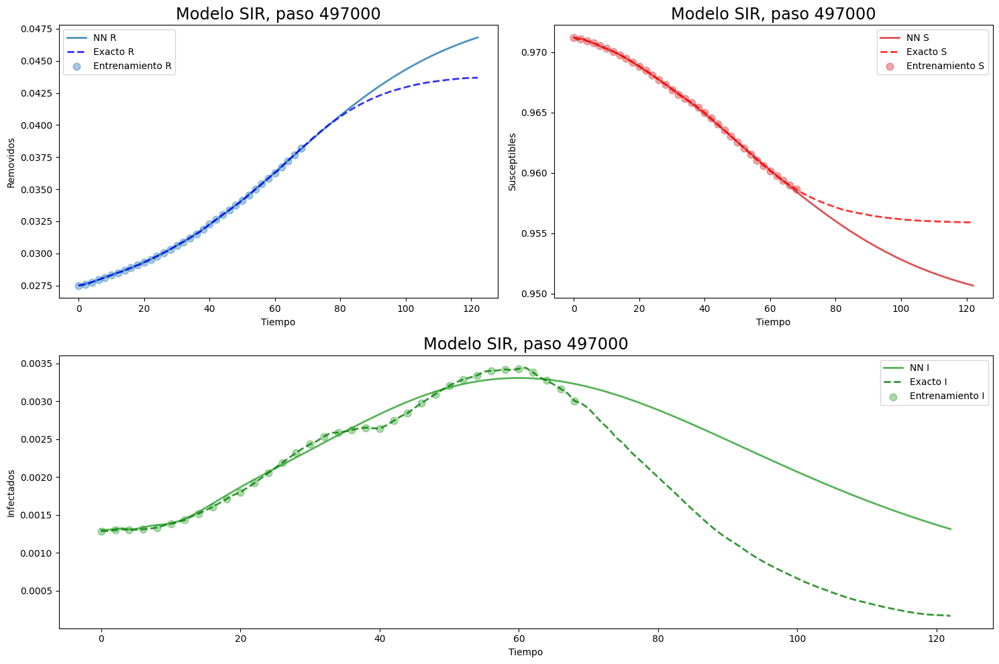

Paso = 497000 , pérdida de datos = 4.1790296e-09 , pérdida física = 1.7705253e-09 , pérdida total = 5.9495546e-09 , mse = 2.0649643e-06 , beta = 0.073182255 , gamma = 0.06896215
Paso = 498000 , pérdida de datos = 2.2006933e-08 , pérdida física = 1.8678687e-09 , pérdida total = 2.3874803e-08 , mse = 2.2988183e-06 , beta = 0.07309556 , gamma = 0.06890587
Paso = 499000 , pérdida de datos = 9.263168e-08 , pérdida física = 1.8420294e-09 , pérdida total = 9.447371e-08 , mse = 1.6449897e-06 , beta = 0.07297781 , gamma = 0.06881486
Paso = 500000 , pérdida de datos = 3.0722514e-08 , pérdida física = 2.2511473e-09 , pérdida total = 3.2973663e-08 , mse = 2.1763012e-06 , beta = 0.073059574 , gamma = 0.068895124


In [40]:
# Cargar los datos
Alem = pd.read_csv('Serie_Covid_Alemania_Parcial.csv')
N_old = Alem['S'][0] + Alem['I'][0] + Alem['R'][0]
Alem['S'] = Alem['S'] / N_old
Alem['I'] = Alem['I'] / N_old
Alem['R'] = Alem['R'] / N_old

Alem_t = torch.tensor(Alem[['t']].values, dtype=torch.float32)
Alem_data = torch.tensor(Alem[['S', 'I', 'R']].values, dtype=torch.float32)

x_data = Alem_t[:70:2]
y_data = Alem_data[:70:2]
x = Alem_t
y = Alem_data

# Definir el modelo y el optimizador
N = 1.0
torch.manual_seed(123)
modelD = FCND(1, 3, 42, 4)

optimizer = torch.optim.Adam(modelD.parameters(), lr=1e-4)

steps = 500000
print_steps = 500
n_prints = steps // print_steps

Alem_loss1_history = np.zeros(n_prints)
Alem_loss2_history = np.zeros(n_prints)
Alem_loss_history = np.zeros(n_prints)
Alem_mse_history = np.zeros(n_prints)
Alem_beta_history = np.zeros(n_prints)
Alem_gamma_history = np.zeros(n_prints)

x_physics = torch.linspace(0., Alem['t'].max(), 90).view(-1, 1).requires_grad_(True)

for i in range(steps):
    optimizer.zero_grad()
    
    # Calcular la pérdida de datos ..................................................
    yh = modelD(x_data)
    loss1 = torch.mean((yh - y_data) ** 2)
    
    # Calcular la pérdida física con la imposición de los datos iniciales ..............
    yhp = modelD(x_physics)
    yhp1 = yhp[:, 0].view(-1, 1)
    yhp2 = yhp[:, 1].view(-1, 1) 
    yhp3 = yhp[:, 2].view(-1, 1)
    
    # Calcular las primeras y segundas derivadas mediante diferenciación automática ....................
    dx1 = torch.autograd.grad(yhp1, x_physics, torch.ones_like(yhp1), create_graph=True)[0]
    dx2 = torch.autograd.grad(yhp2, x_physics, torch.ones_like(yhp2), create_graph=True)[0]
    dx3 = torch.autograd.grad(yhp3, x_physics, torch.ones_like(yhp3), create_graph=True)[0]
    
    # Calcular el residuo .............................................
    physics2 = (dx1 + (modelD.beta / N) * yhp1 * yhp2)                
    physics1 = (dx2 - (modelD.beta / N) * yhp1 * yhp2 + modelD.gamma * yhp2)
    physics3 = (dx3 - modelD.gamma * yhp2)
    loss2 = torch.mean(physics1 ** 2) + torch.mean(physics2 ** 2) + torch.mean(physics3 ** 2)
    
    # Retropropagación de la pérdida total ...............................................
    loss = loss1 + loss2
    loss.backward()
    optimizer.step()    
        
    # Graficar el resultado a medida que avanza el entrenamiento ...............................
    if (i + 1) % print_steps == 0: 
        i_print = i // print_steps
        Alem_loss1_history[i_print] = loss1.detach().numpy()
        Alem_loss2_history[i_print] = loss2.detach().numpy()
        Alem_loss_history[i_print] = loss.detach().numpy()
        
        yh = modelD(x).detach()
        xp = x_physics.detach()
        
        yhpp = modelD(x)
        mse = torch.mean((yhpp - y) ** 2)   # Calcular el error cuadrático medio usando la solución exacta
        Alem_mse_history[i_print] = mse.detach().numpy()

        Alem_beta_history[i_print] = modelD.beta.detach().numpy()[0]
        Alem_gamma_history[i_print] = modelD.gamma.detach().numpy()[0]

        if (i + 1) == 500: plot_result_al(i, x, y, x_data, y_data, yh, xp)
        if (i + 1) % 1000 == 0 and (i + 1) < 5000: plot_result_al(i, x, y, x_data, y_data, yh, xp)
        if (i + 1) % 7000 == 0: plot_result_al(i, x, y, x_data, y_data, yh, xp)
        else: plt.close("all")
    
    if (i + 1) % 1000 == 0:
        print('Paso =', i + 1, ', pérdida de datos =', loss1.detach().numpy(), ', pérdida física =', loss2.detach().numpy(), ', pérdida total =', loss.detach().numpy(),
              ', mse =', mse.detach().numpy(), ', beta =', modelD.beta.detach().numpy()[0], ', gamma =', modelD.gamma.detach().numpy()[0])


Los mejores valores de beta y gamma son, beta = 0.07337620109319687 , gamma = 0.06906211376190186


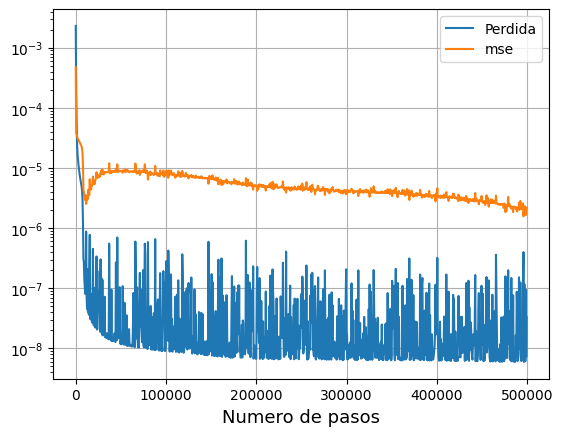

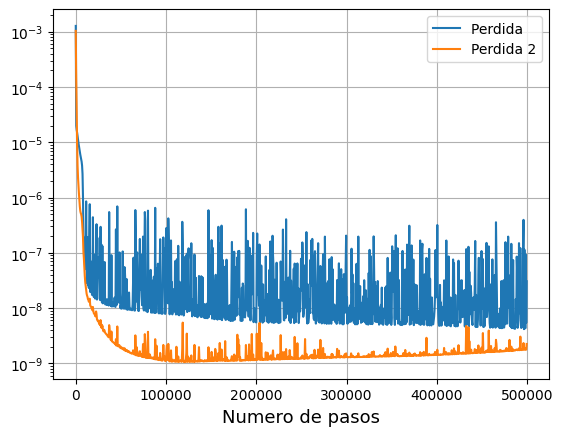

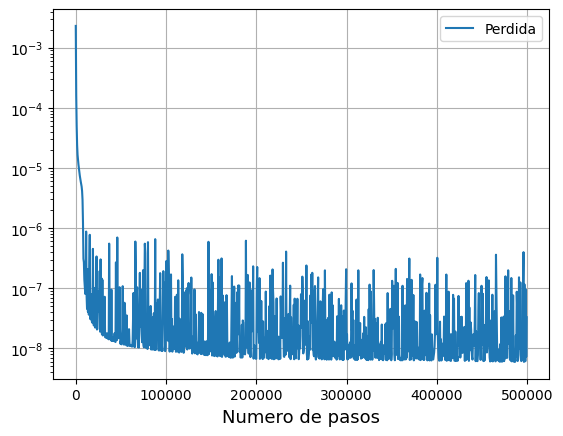

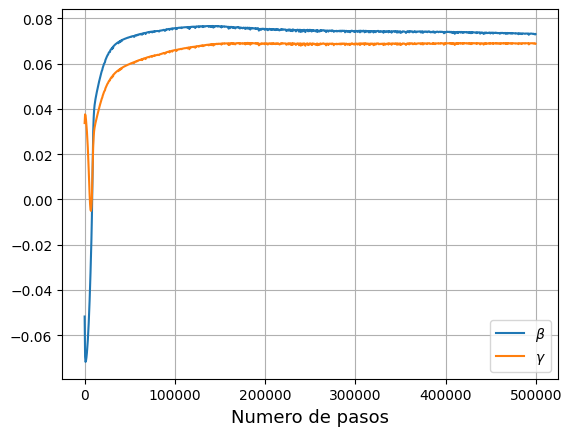

In [44]:
all_steps = np.arange(0, steps, print_steps)

fig33 = plt.figure(33)
plt.plot(all_steps,Alem_loss_history, label="Perdida")
plt.plot(all_steps,Alem_mse_history, label="mse")
plt.xlabel('Numero de pasos',fontsize=13)

plt.yscale('log')
plt.legend()
plt.grid(True) 

fig50 = plt.figure(50)
plt.plot(all_steps,Alem_loss1_history, label="Perdida ")
plt.plot(all_steps,Alem_loss2_history, label="Perdida 2")
plt.xlabel('Numero de pasos',fontsize=13)

plt.yscale('log')
plt.legend()
plt.grid(True) 

fig51 = plt.figure(51)
plt.plot(all_steps,Alem_loss_history, label="Perdida")
plt.yscale('log')

plt.xlabel('Numero de pasos',fontsize=13)

plt.legend()
plt.grid(True) 

fig60 = plt.figure(60)
plt.plot(all_steps,Alem_beta_history, label=r"$\beta$")
plt.plot(all_steps,Alem_gamma_history, label=r"$\gamma$")
plt.xlabel('Numero de pasos',fontsize=13)

plt.legend()
plt.grid(True) 

#find the index of min loss
min_loss_index = np.argmin(Alem_loss_history)
print('Los mejores valores de beta y gamma son, beta =', Alem_beta_history[min_loss_index], ', gamma =', Alem_gamma_history[min_loss_index])

### PINN sin busqueda de parametros

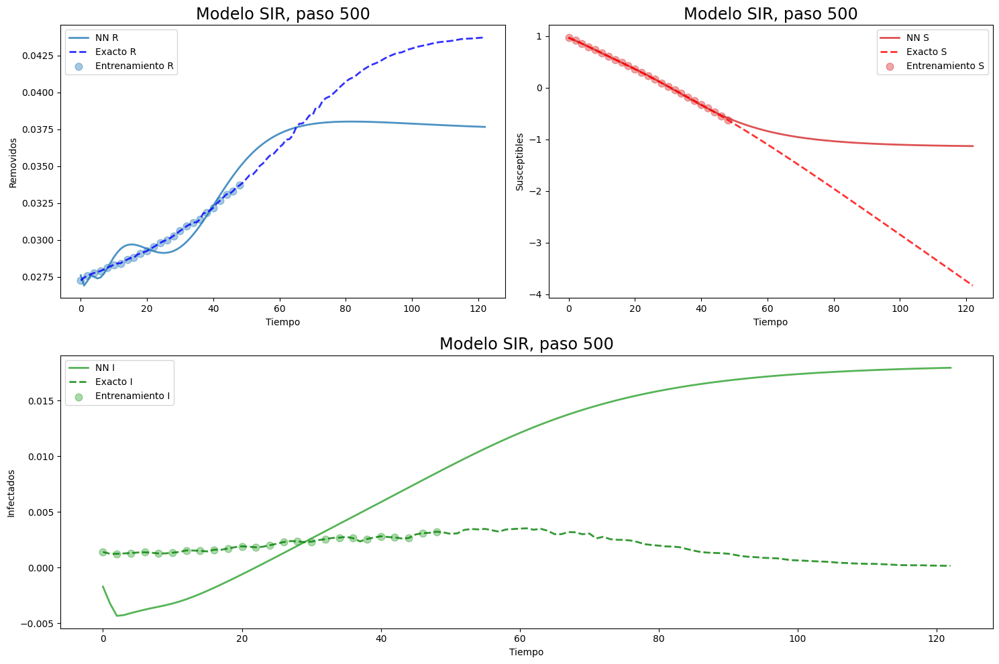

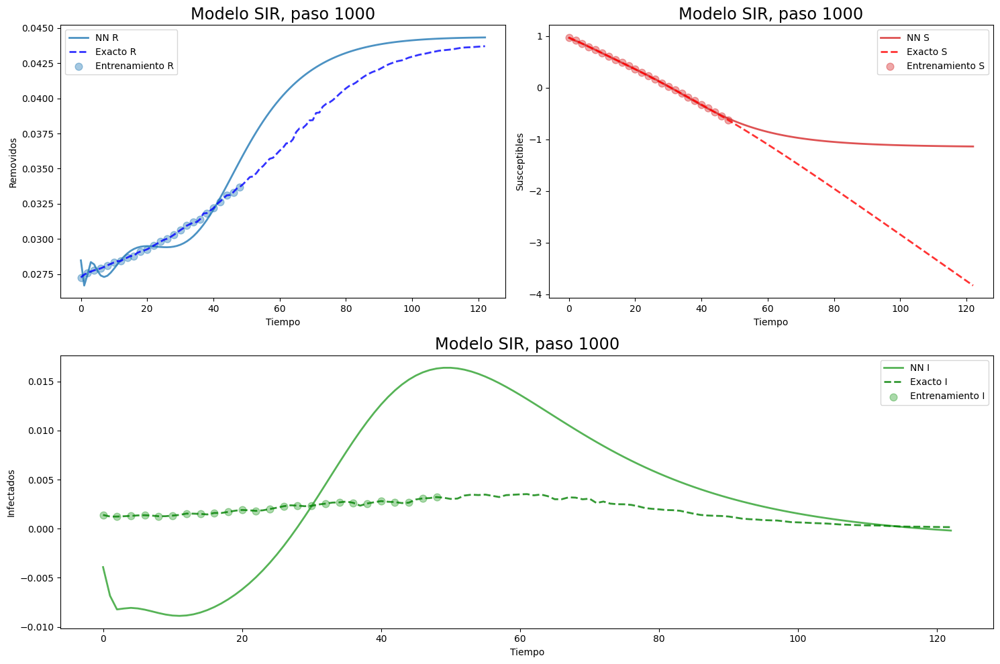

step = 1000 , loss1 = 4.955068e-05 , loss2 = 0.00037956893 , loss = 0.0004291196 , mse = 0.42006803 , beta = -0.7503388 , gamma = 0.21706429


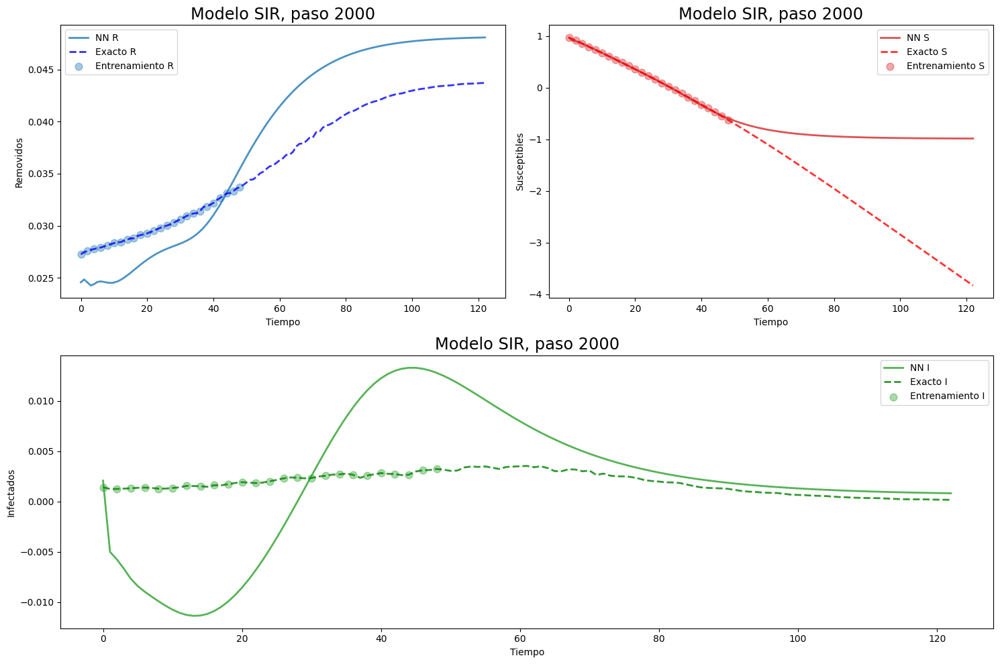

step = 2000 , loss1 = 4.224749e-05 , loss2 = 0.00045464328 , loss = 0.00049689075 , mse = 0.48613715 , beta = -1.270909 , gamma = 0.23221904


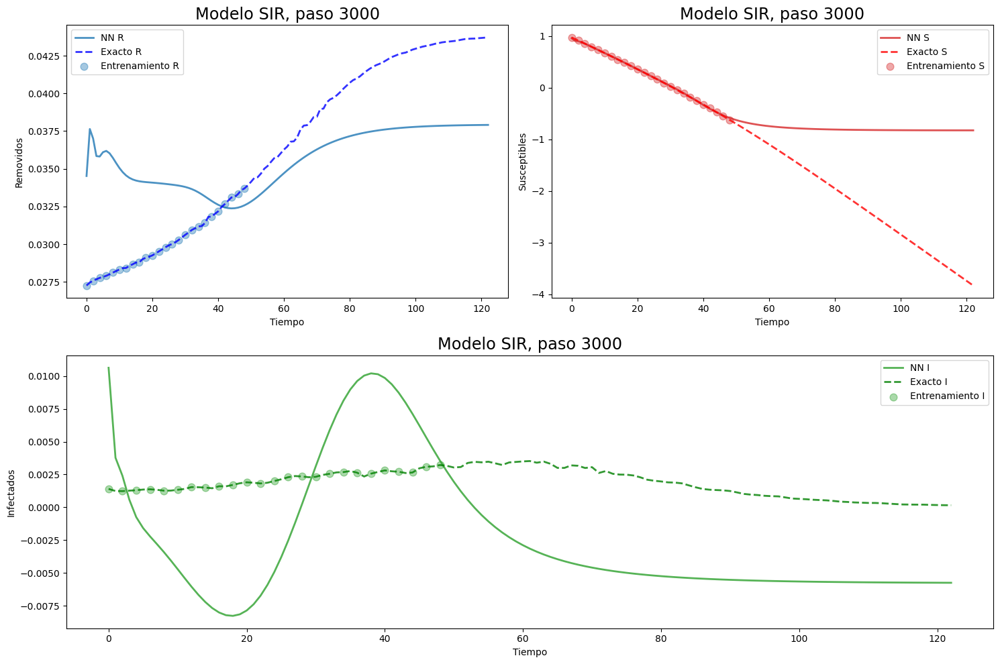

step = 3000 , loss1 = 0.00011662441 , loss2 = 0.00081790047 , loss = 0.00093452487 , mse = 0.56499887 , beta = -1.812112 , gamma = 0.1292378


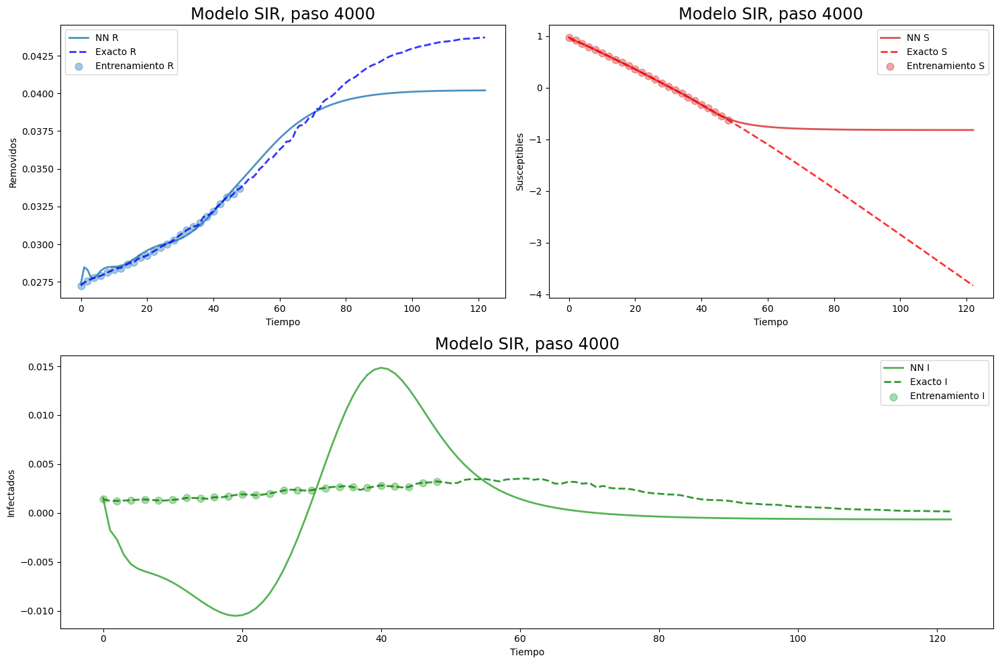

step = 4000 , loss1 = 3.8789873e-05 , loss2 = 0.00028215427 , loss = 0.00032094415 , mse = 0.56708723 , beta = -2.3130004 , gamma = 0.08731894
step = 5000 , loss1 = 3.608775e-05 , loss2 = 0.0002695776 , loss = 0.00030566537 , mse = 0.58447564 , beta = -2.861855 , gamma = 0.11285677
step = 6000 , loss1 = 0.00016245202 , loss2 = 0.00028107117 , loss = 0.0004435232 , mse = 0.62437916 , beta = -3.4492009 , gamma = 0.12063897


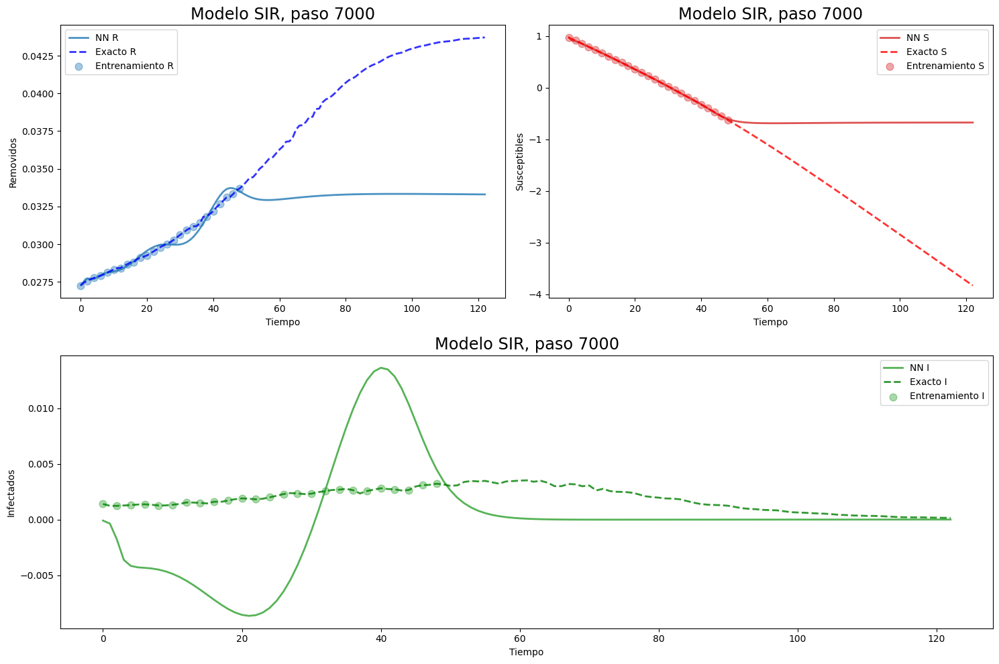

step = 7000 , loss1 = 2.4676357e-05 , loss2 = 0.00025751753 , loss = 0.00028219388 , mse = 0.6471106 , beta = -4.04985 , gamma = 0.11152951
step = 8000 , loss1 = 2.6094143e-05 , loss2 = 0.00028481812 , loss = 0.00031091226 , mse = 0.5325258 , beta = -3.694303 , gamma = 0.17015666
step = 9000 , loss1 = 2.713475e-05 , loss2 = 0.0002719756 , loss = 0.00029911034 , mse = 0.5604338 , beta = -3.6767702 , gamma = 0.1764798
step = 10000 , loss1 = 2.7212924e-05 , loss2 = 0.00026306004 , loss = 0.00029027296 , mse = 0.5996002 , beta = -3.6796927 , gamma = 0.1761193
step = 11000 , loss1 = 7.5301745e-05 , loss2 = 0.00025911132 , loss = 0.00033441305 , mse = 0.6608109 , beta = -3.6986365 , gamma = 0.16949967
step = 12000 , loss1 = 4.2286403e-05 , loss2 = 0.0002928514 , loss = 0.0003351378 , mse = 0.6693255 , beta = -3.7413335 , gamma = 0.15346125
step = 13000 , loss1 = 2.5396967e-05 , loss2 = 0.00025607954 , loss = 0.0002814765 , mse = 0.69676644 , beta = -3.7971625 , gamma = 0.13545655


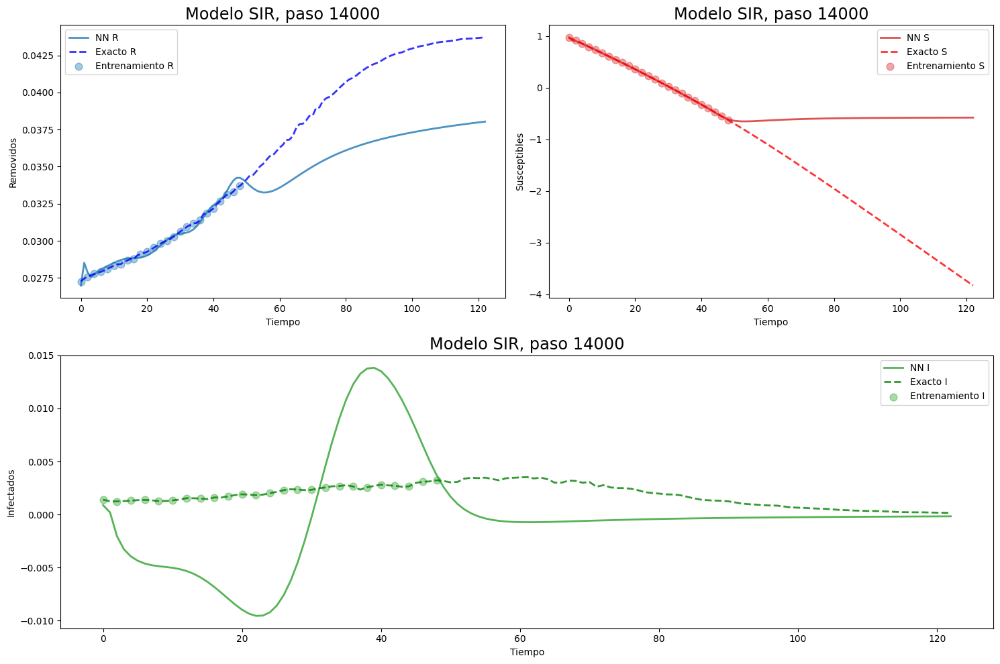

step = 14000 , loss1 = 2.4921143e-05 , loss2 = 0.00025520378 , loss = 0.00028012492 , mse = 0.70372945 , beta = -3.9299247 , gamma = 0.11043292
step = 15000 , loss1 = 0.0001397795 , loss2 = 0.00025696662 , loss = 0.00039674612 , mse = 0.7264622 , beta = -4.154613 , gamma = 0.08269283
step = 16000 , loss1 = 7.7379176e-05 , loss2 = 0.0003244208 , loss = 0.00040179997 , mse = 0.60576224 , beta = -3.956436 , gamma = 0.05058615
step = 17000 , loss1 = 2.7033071e-05 , loss2 = 0.00026347346 , loss = 0.00029050652 , mse = 0.59928226 , beta = -3.9475613 , gamma = 0.06154914
step = 18000 , loss1 = 2.7959322e-05 , loss2 = 0.0002570806 , loss = 0.00028503992 , mse = 0.6467004 , beta = -3.9287148 , gamma = 0.08510152
step = 19000 , loss1 = 3.6363355e-05 , loss2 = 0.00026114186 , loss = 0.0002975052 , mse = 0.6988952 , beta = -3.911567 , gamma = 0.11047286
step = 20000 , loss1 = 3.9701707e-05 , loss2 = 0.00025996397 , loss = 0.00029966567 , mse = 0.77984554 , beta = -3.89493 , gamma = 0.13268174


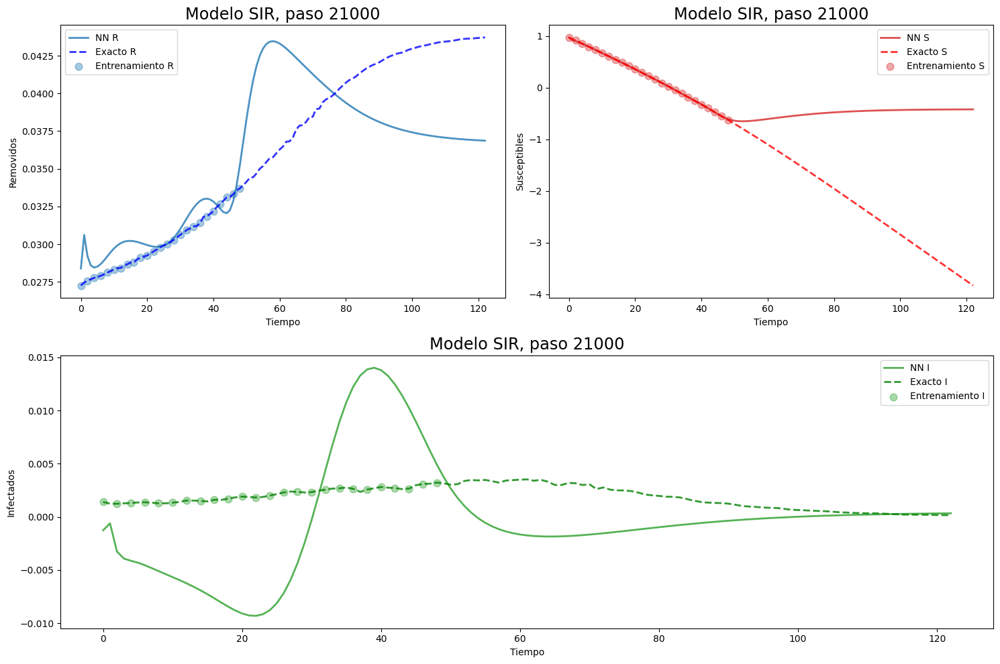

step = 21000 , loss1 = 2.6128377e-05 , loss2 = 0.00026124646 , loss = 0.00028737483 , mse = 0.7950935 , beta = -3.7856476 , gamma = 0.13993764
step = 22000 , loss1 = 2.478412e-05 , loss2 = 0.00026034695 , loss = 0.00028513107 , mse = 0.78015816 , beta = -3.7796967 , gamma = 0.1968496
step = 23000 , loss1 = 2.8240407e-05 , loss2 = 0.00025746934 , loss = 0.00028570974 , mse = 0.79585165 , beta = -3.7575936 , gamma = 0.24408112
step = 24000 , loss1 = 3.0814153e-05 , loss2 = 0.00025704445 , loss = 0.0002878586 , mse = 0.78471345 , beta = -3.7406495 , gamma = 0.2521795
step = 25000 , loss1 = 4.2843945e-05 , loss2 = 0.0002653456 , loss = 0.00030818954 , mse = 0.8498157 , beta = -3.622151 , gamma = 0.26862317
step = 26000 , loss1 = 2.6708012e-05 , loss2 = 0.00025217136 , loss = 0.00027887936 , mse = 0.7741902 , beta = -3.7556705 , gamma = 0.19427444
step = 27000 , loss1 = 2.5535679e-05 , loss2 = 0.0002486943 , loss = 0.00027422997 , mse = 0.76728594 , beta = -3.8433654 , gamma = 0.18549068


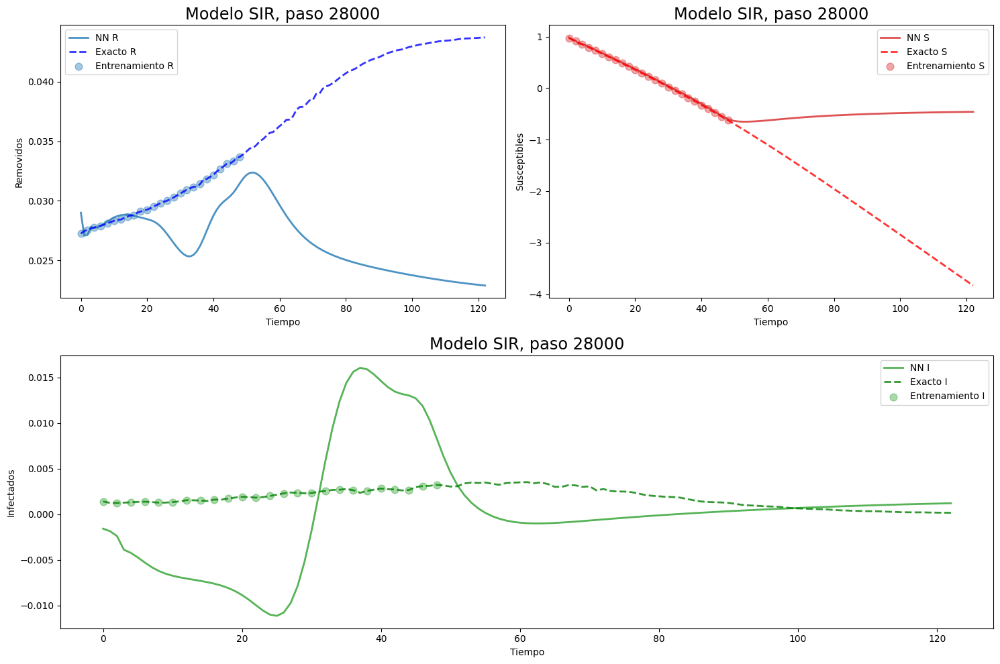

step = 28000 , loss1 = 5.5862187e-05 , loss2 = 0.00025782373 , loss = 0.00031368592 , mse = 0.7636106 , beta = -3.881341 , gamma = 0.24452959
step = 29000 , loss1 = 2.0338706e-05 , loss2 = 0.00026077052 , loss = 0.00028110924 , mse = 0.78068215 , beta = -4.1979575 , gamma = 0.18851236
step = 30000 , loss1 = 2.3461302e-05 , loss2 = 0.00024212911 , loss = 0.0002655904 , mse = 0.7398458 , beta = -4.27145 , gamma = 0.20384035
step = 31000 , loss1 = 5.314187e-05 , loss2 = 0.00026137996 , loss = 0.00031452184 , mse = 0.8676713 , beta = -4.1676083 , gamma = 0.35776812
step = 32000 , loss1 = 2.2281523e-05 , loss2 = 0.00023950361 , loss = 0.00026178514 , mse = 0.7341636 , beta = -4.5155644 , gamma = 0.18160413
step = 33000 , loss1 = 2.1784399e-05 , loss2 = 0.00023829148 , loss = 0.00026007587 , mse = 0.74270546 , beta = -4.7343125 , gamma = 0.19069563
step = 34000 , loss1 = 1.9661027e-05 , loss2 = 0.00025078063 , loss = 0.00027044167 , mse = 0.8057902 , beta = -4.8402567 , gamma = 0.2508088


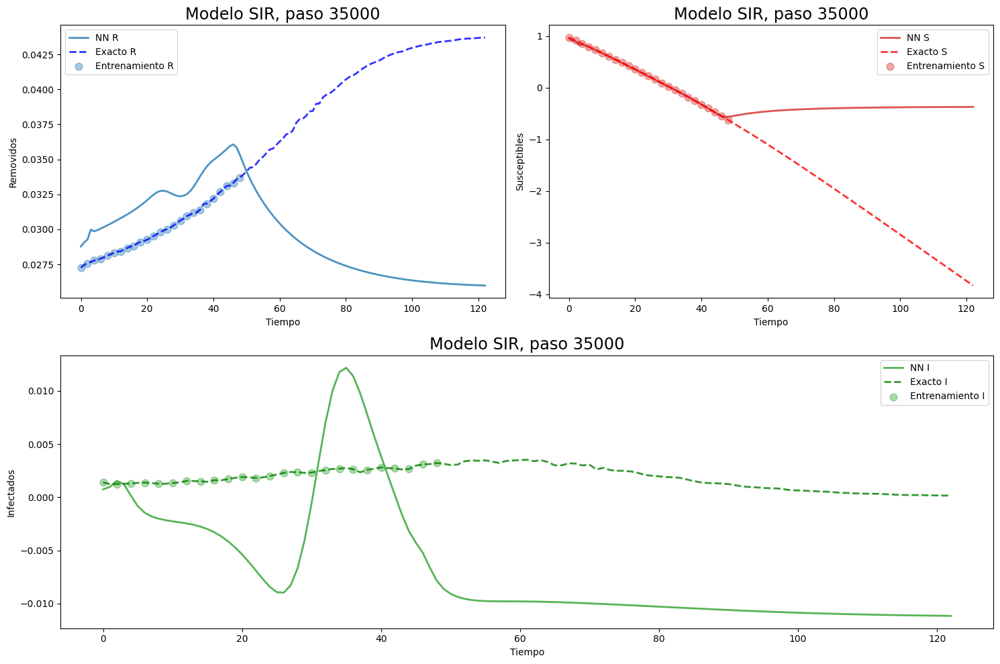

step = 35000 , loss1 = 5.8338344e-05 , loss2 = 0.0007371808 , loss = 0.00079551915 , mse = 0.8405787 , beta = -5.12213 , gamma = 0.23068573
step = 36000 , loss1 = 2.1864807e-05 , loss2 = 0.00024117799 , loss = 0.0002630428 , mse = 0.7017767 , beta = -4.5293736 , gamma = 0.13349648
step = 37000 , loss1 = 2.2668717e-05 , loss2 = 0.0002384387 , loss = 0.00026110743 , mse = 0.7197279 , beta = -4.5788794 , gamma = 0.1222666
step = 38000 , loss1 = 2.2476004e-05 , loss2 = 0.00023736739 , loss = 0.0002598434 , mse = 0.70802546 , beta = -4.6628685 , gamma = 0.11991041
step = 39000 , loss1 = 2.087097e-05 , loss2 = 0.00024169602 , loss = 0.000262567 , mse = 0.71502984 , beta = -4.776888 , gamma = 0.1273221
step = 40000 , loss1 = 2.18181e-05 , loss2 = 0.0002420062 , loss = 0.0002638243 , mse = 0.7810024 , beta = -4.892377 , gamma = 0.16889821
step = 41000 , loss1 = 1.979057e-05 , loss2 = 0.0002346079 , loss = 0.00025439847 , mse = 0.766045 , beta = -5.120193 , gamma = 0.2001328


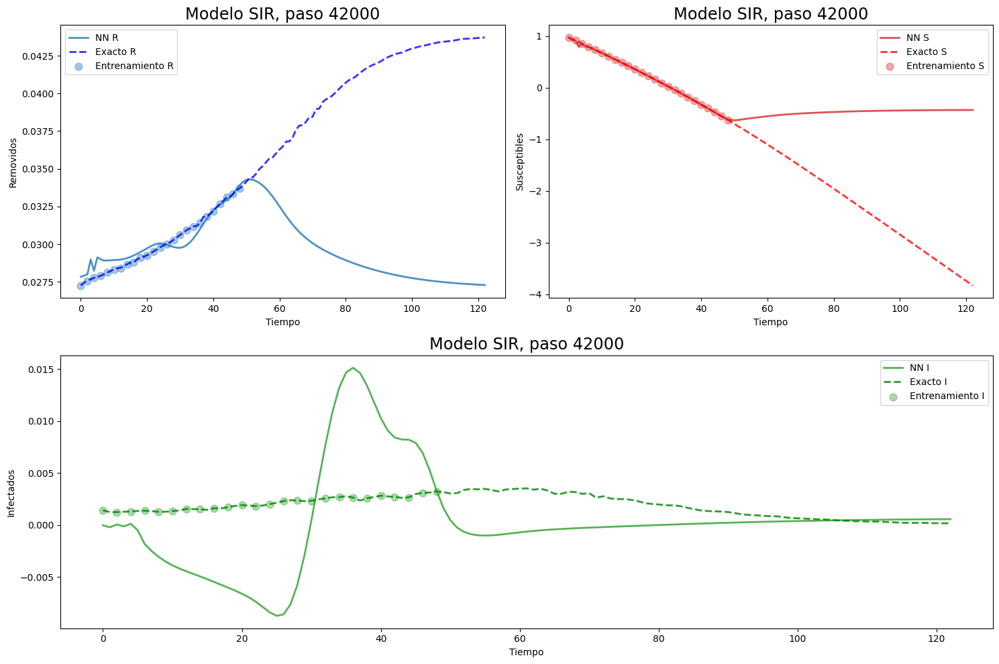

step = 42000 , loss1 = 1.8690063e-05 , loss2 = 0.0002413606 , loss = 0.00026005067 , mse = 0.7938497 , beta = -5.2851033 , gamma = 0.24904637
step = 43000 , loss1 = 1.814982e-05 , loss2 = 0.0002263748 , loss = 0.00024452462 , mse = 0.75587076 , beta = -5.6282268 , gamma = 0.2428348
step = 44000 , loss1 = 1.982638e-05 , loss2 = 0.00023315992 , loss = 0.0002529863 , mse = 0.80642426 , beta = -5.1558366 , gamma = 0.1291597
step = 45000 , loss1 = 1.982981e-05 , loss2 = 0.0002279374 , loss = 0.00024776722 , mse = 0.7409642 , beta = -5.1765866 , gamma = 0.16857198
step = 46000 , loss1 = 1.9503297e-05 , loss2 = 0.00022752007 , loss = 0.00024702336 , mse = 0.7555178 , beta = -5.2007766 , gamma = 0.21383026
step = 47000 , loss1 = 1.9364708e-05 , loss2 = 0.00022185613 , loss = 0.00024122084 , mse = 0.758094 , beta = -5.234488 , gamma = 0.24262865
step = 48000 , loss1 = 2.2703198e-05 , loss2 = 0.00022874268 , loss = 0.00025144586 , mse = 0.8320568 , beta = -5.260899 , gamma = 0.32236964


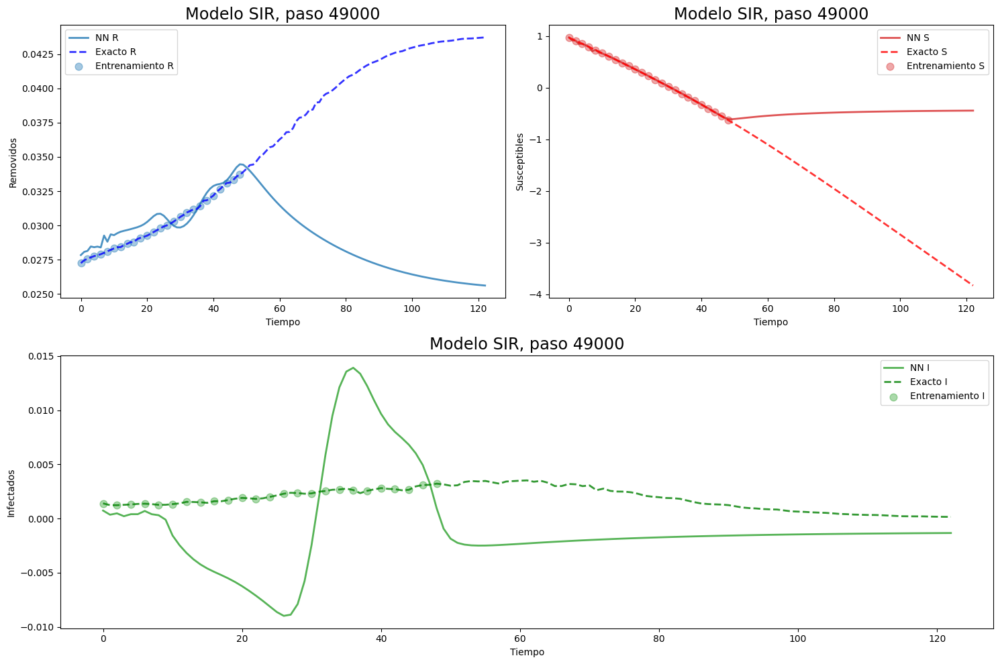

step = 49000 , loss1 = 2.627401e-05 , loss2 = 0.00021030544 , loss = 0.00023657945 , mse = 0.7869359 , beta = -5.3974233 , gamma = 0.33592984
step = 50000 , loss1 = 1.8637304e-05 , loss2 = 0.00022298693 , loss = 0.00024162424 , mse = 0.82842654 , beta = -5.563833 , gamma = 0.36741674
step = 51000 , loss1 = 3.0750976e-05 , loss2 = 0.00023203311 , loss = 0.00026278407 , mse = 0.8229278 , beta = -5.8303304 , gamma = 0.35725927
step = 52000 , loss1 = 2.7337106e-05 , loss2 = 0.00023933123 , loss = 0.00026666833 , mse = 0.6557156 , beta = -5.440058 , gamma = 0.10382256
step = 53000 , loss1 = 3.2315806e-05 , loss2 = 0.00026889634 , loss = 0.00030121216 , mse = 0.90452796 , beta = -5.4268594 , gamma = 0.11501444
step = 54000 , loss1 = 2.9448851e-05 , loss2 = 0.00027045124 , loss = 0.0002999001 , mse = 0.9245861 , beta = -5.4036303 , gamma = 0.14057334
step = 55000 , loss1 = 2.0451389e-05 , loss2 = 0.00021745621 , loss = 0.0002379076 , mse = 0.7621808 , beta = -5.4065948 , gamma = 0.16739427


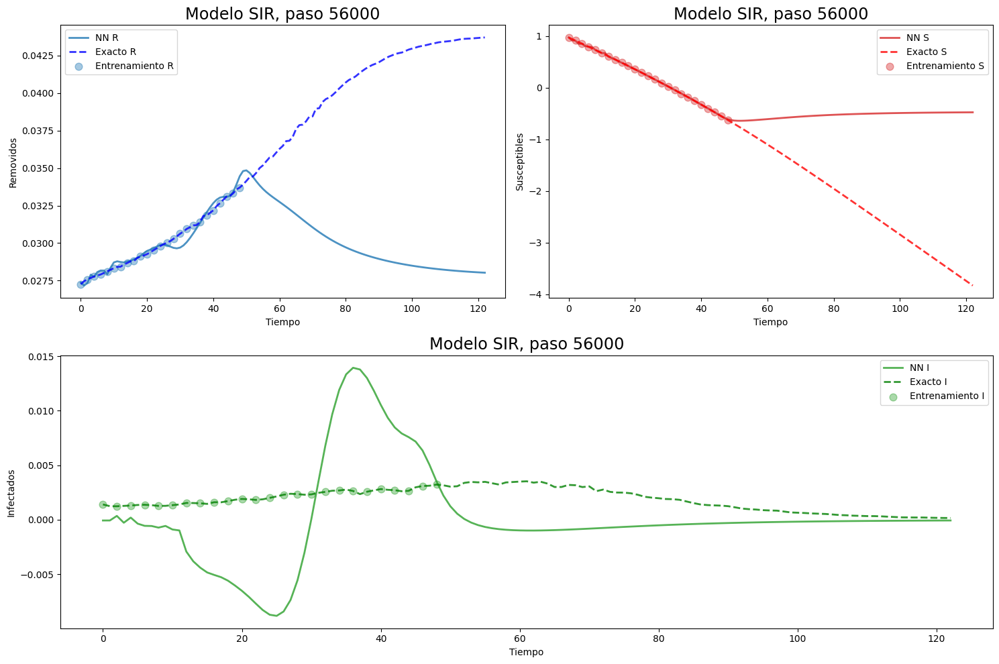

step = 56000 , loss1 = 1.8374918e-05 , loss2 = 0.00020735874 , loss = 0.00022573366 , mse = 0.76007855 , beta = -5.365245 , gamma = 0.23769753
step = 57000 , loss1 = 1.8493827e-05 , loss2 = 0.00020922927 , loss = 0.0002277231 , mse = 0.8147191 , beta = -5.3115745 , gamma = 0.32312572
step = 58000 , loss1 = 1.8546445e-05 , loss2 = 0.00019989323 , loss = 0.00021843967 , mse = 0.7629795 , beta = -5.3625236 , gamma = 0.36117643
step = 59000 , loss1 = 1.7168402e-05 , loss2 = 0.00017990403 , loss = 0.00019707244 , mse = 0.75114244 , beta = -5.425831 , gamma = 0.43500316
step = 60000 , loss1 = 1.6050342e-05 , loss2 = 0.00017445313 , loss = 0.00019050347 , mse = 0.7436108 , beta = -5.480806 , gamma = 0.52536464
step = 61000 , loss1 = 1.4322065e-05 , loss2 = 0.00017060776 , loss = 0.00018492983 , mse = 0.7559019 , beta = -5.6642566 , gamma = 0.5645695
step = 62000 , loss1 = 2.2721972e-05 , loss2 = 0.00014310329 , loss = 0.00016582526 , mse = 0.7197746 , beta = -5.198147 , gamma = 0.30497664


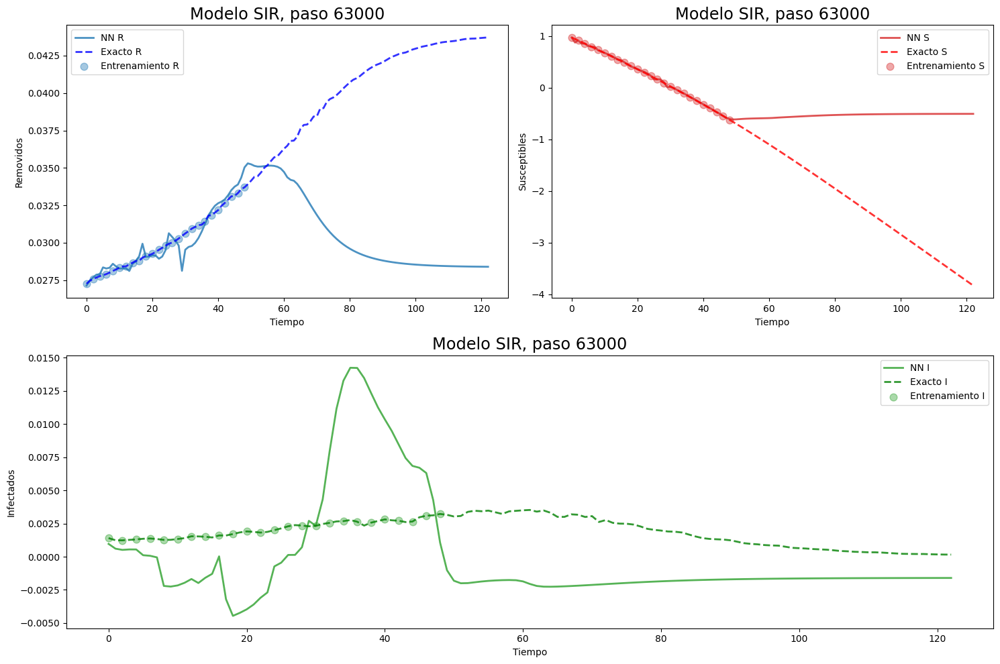

step = 63000 , loss1 = 2.7174083e-05 , loss2 = 0.00018609442 , loss = 0.0002132685 , mse = 0.74922144 , beta = -5.2090387 , gamma = 0.42311805
step = 64000 , loss1 = 2.9363613e-05 , loss2 = 0.00012329835 , loss = 0.00015266196 , mse = 0.7645224 , beta = -5.222413 , gamma = 0.55395246
step = 65000 , loss1 = 3.0930925e-05 , loss2 = 0.000119526325 , loss = 0.00015045726 , mse = 0.770613 , beta = -5.2283473 , gamma = 0.6495959
step = 66000 , loss1 = 3.112619e-05 , loss2 = 0.0001823218 , loss = 0.00021344799 , mse = 0.62427586 , beta = -4.720709 , gamma = 0.38504916
step = 67000 , loss1 = 2.663966e-05 , loss2 = 0.00016464457 , loss = 0.00019128423 , mse = 0.64477545 , beta = -4.702612 , gamma = 0.4226928
step = 68000 , loss1 = 1.860926e-05 , loss2 = 0.00014107893 , loss = 0.00015968819 , mse = 0.6995329 , beta = -4.7034 , gamma = 0.48093438
step = 69000 , loss1 = 2.0890286e-05 , loss2 = 0.00013449795 , loss = 0.00015538823 , mse = 0.73453015 , beta = -4.706099 , gamma = 0.5639155


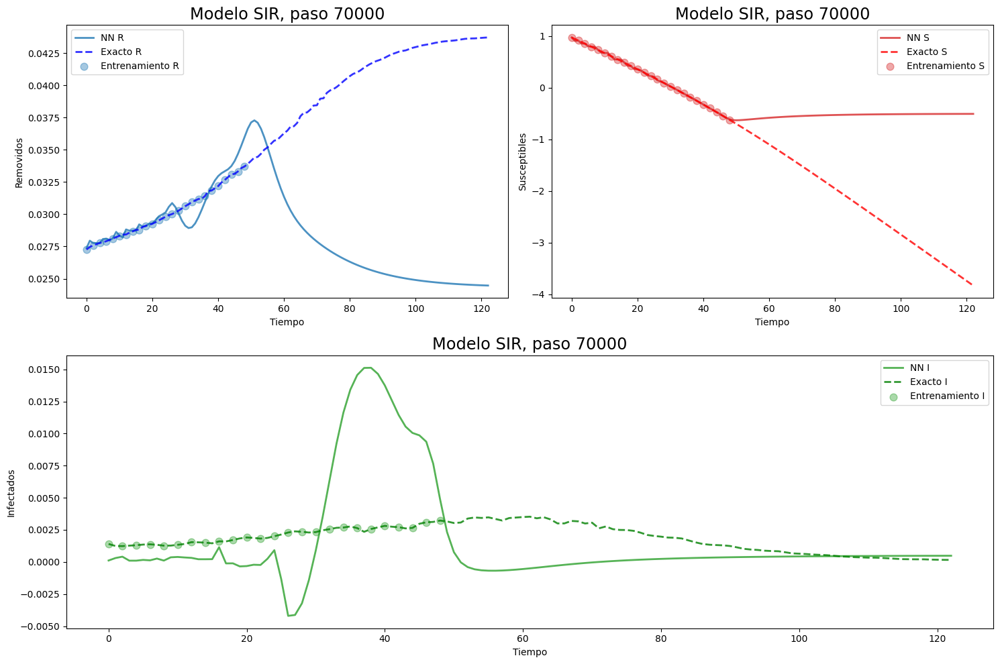

step = 70000 , loss1 = 1.4561894e-05 , loss2 = 0.00013259873 , loss = 0.00014716062 , mse = 0.7488077 , beta = -4.7034225 , gamma = 0.6432127
step = 71000 , loss1 = 3.7159745e-05 , loss2 = 0.00014675534 , loss = 0.00018391508 , mse = 0.6957387 , beta = -4.299865 , gamma = 0.4848905
step = 72000 , loss1 = 2.1173197e-05 , loss2 = 0.0002404738 , loss = 0.000261647 , mse = 0.7130236 , beta = -4.355386 , gamma = 0.5642699
step = 73000 , loss1 = 2.6310496e-05 , loss2 = 0.00013318335 , loss = 0.00015949385 , mse = 0.7961044 , beta = -4.3972454 , gamma = 0.6686131
step = 74000 , loss1 = 2.8634673e-05 , loss2 = 0.00023393956 , loss = 0.00026257423 , mse = 0.6827682 , beta = -4.0895085 , gamma = 0.42416367
step = 75000 , loss1 = 2.2554705e-05 , loss2 = 0.00021651515 , loss = 0.00023906986 , mse = 0.68539 , beta = -4.0564823 , gamma = 0.41845927
step = 76000 , loss1 = 5.7742025e-05 , loss2 = 0.00036154335 , loss = 0.00041928538 , mse = 0.7288785 , beta = -4.032437 , gamma = 0.41235456


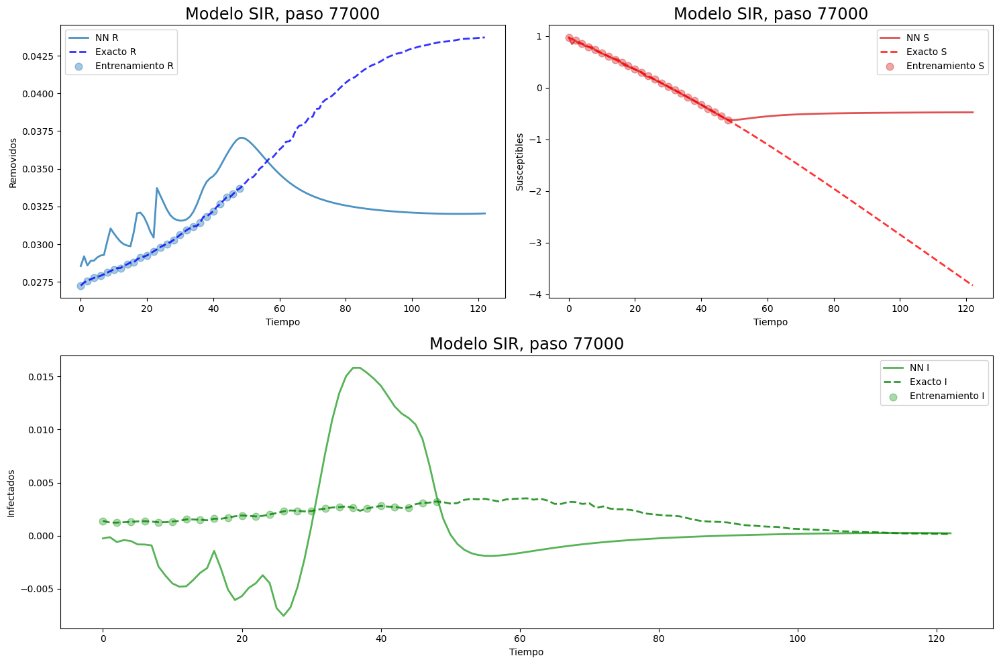

step = 77000 , loss1 = 3.683118e-05 , loss2 = 0.00018634522 , loss = 0.00022317641 , mse = 0.7690656 , beta = -4.0156927 , gamma = 0.4251134
step = 78000 , loss1 = 3.6198853e-05 , loss2 = 0.00019489675 , loss = 0.0002310956 , mse = 0.8192911 , beta = -3.97248 , gamma = 0.46110666
step = 79000 , loss1 = 2.659193e-05 , loss2 = 0.00019163563 , loss = 0.00021822756 , mse = 0.7834681 , beta = -3.840938 , gamma = 0.46133313
step = 80000 , loss1 = 5.5005185e-05 , loss2 = 0.0002278884 , loss = 0.0002828936 , mse = 0.8259226 , beta = -3.74307 , gamma = 0.45843953
step = 81000 , loss1 = 6.405926e-05 , loss2 = 0.00020457957 , loss = 0.00026863883 , mse = 0.79006225 , beta = -3.472955 , gamma = 0.41264653
step = 82000 , loss1 = 0.00023412012 , loss2 = 0.000296869 , loss = 0.00053098914 , mse = 0.8389221 , beta = -3.5463357 , gamma = 0.4212264
step = 83000 , loss1 = 2.635515e-05 , loss2 = 0.00020672484 , loss = 0.00023307999 , mse = 0.7564249 , beta = -3.2215989 , gamma = 0.3505937


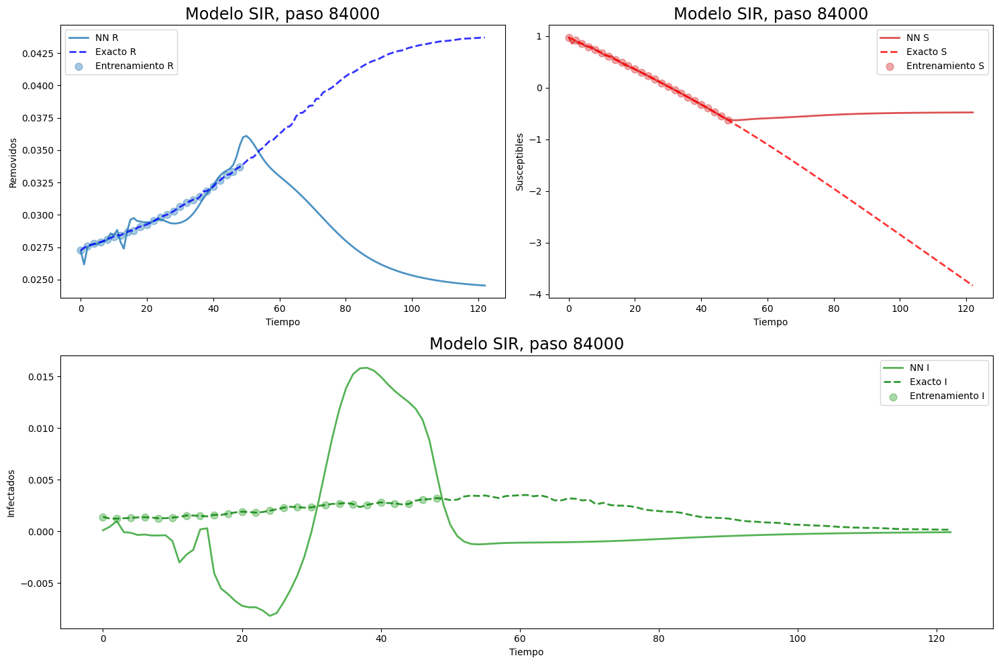

step = 84000 , loss1 = 2.1880742e-05 , loss2 = 0.00019888429 , loss = 0.00022076503 , mse = 0.76042634 , beta = -3.3817 , gamma = 0.37725094
step = 85000 , loss1 = 2.134876e-05 , loss2 = 0.00019012681 , loss = 0.00021147558 , mse = 0.76479524 , beta = -3.4279819 , gamma = 0.43266553
step = 86000 , loss1 = 2.4341123e-05 , loss2 = 0.0002206175 , loss = 0.00024495862 , mse = 0.77693975 , beta = -3.2292342 , gamma = 0.33577323
step = 87000 , loss1 = 2.3874856e-05 , loss2 = 0.00021890273 , loss = 0.00024277759 , mse = 0.7763729 , beta = -3.333334 , gamma = 0.32784995
step = 88000 , loss1 = 6.116823e-05 , loss2 = 0.0002461921 , loss = 0.00030736031 , mse = 0.84766984 , beta = -3.3922493 , gamma = 0.36389002
step = 89000 , loss1 = 2.3436904e-05 , loss2 = 0.00021910592 , loss = 0.00024254282 , mse = 0.8145285 , beta = -3.4279065 , gamma = 0.34882754
step = 90000 , loss1 = 2.3180983e-05 , loss2 = 0.00021615157 , loss = 0.00023933256 , mse = 0.8022032 , beta = -3.6317575 , gamma = 0.3407097


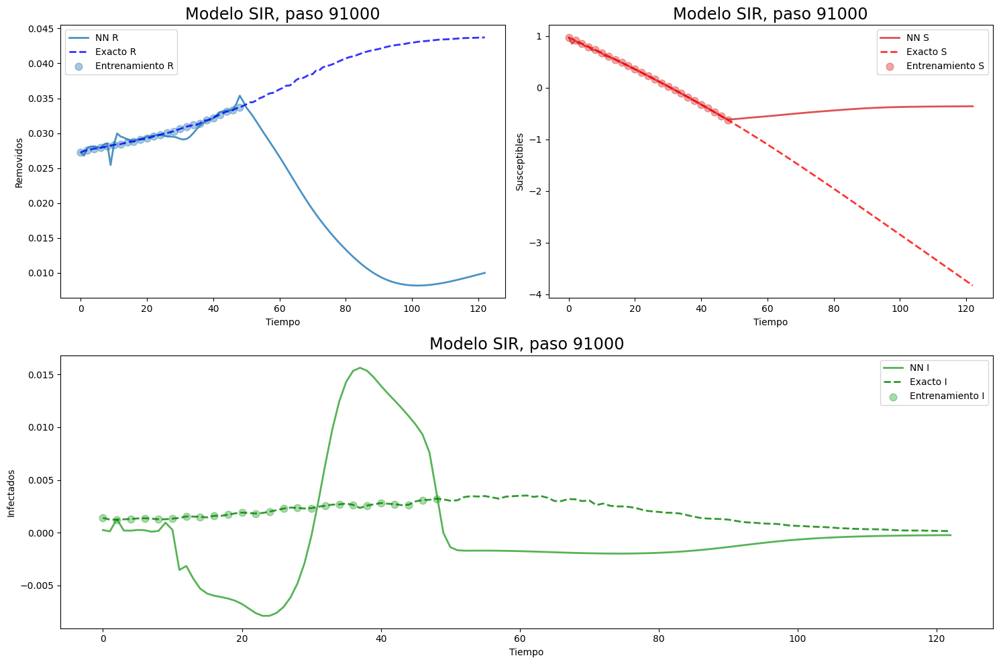

step = 91000 , loss1 = 2.2463473e-05 , loss2 = 0.00021561177 , loss = 0.00023807524 , mse = 0.83220863 , beta = -3.818599 , gamma = 0.38901073
step = 92000 , loss1 = 3.372191e-05 , loss2 = 0.00021581634 , loss = 0.00024953825 , mse = 0.80803466 , beta = -3.973865 , gamma = 0.34639317
step = 93000 , loss1 = 2.0290361e-05 , loss2 = 0.00021256901 , loss = 0.00023285937 , mse = 0.8320261 , beta = -3.9954326 , gamma = 0.36213946
step = 94000 , loss1 = 2.3571474e-05 , loss2 = 0.00021785409 , loss = 0.00024142556 , mse = 0.75179756 , beta = -3.5974133 , gamma = 0.28846395
step = 95000 , loss1 = 2.7198186e-05 , loss2 = 0.00025027015 , loss = 0.00027746835 , mse = 0.74493897 , beta = -3.8561454 , gamma = 0.30142686
step = 96000 , loss1 = 2.645272e-05 , loss2 = 0.00021245277 , loss = 0.00023890549 , mse = 0.67880267 , beta = -3.538223 , gamma = 0.24439374
step = 97000 , loss1 = 2.3010072e-05 , loss2 = 0.00020498432 , loss = 0.00022799439 , mse = 0.69083565 , beta = -3.6169324 , gamma = 0.3003605

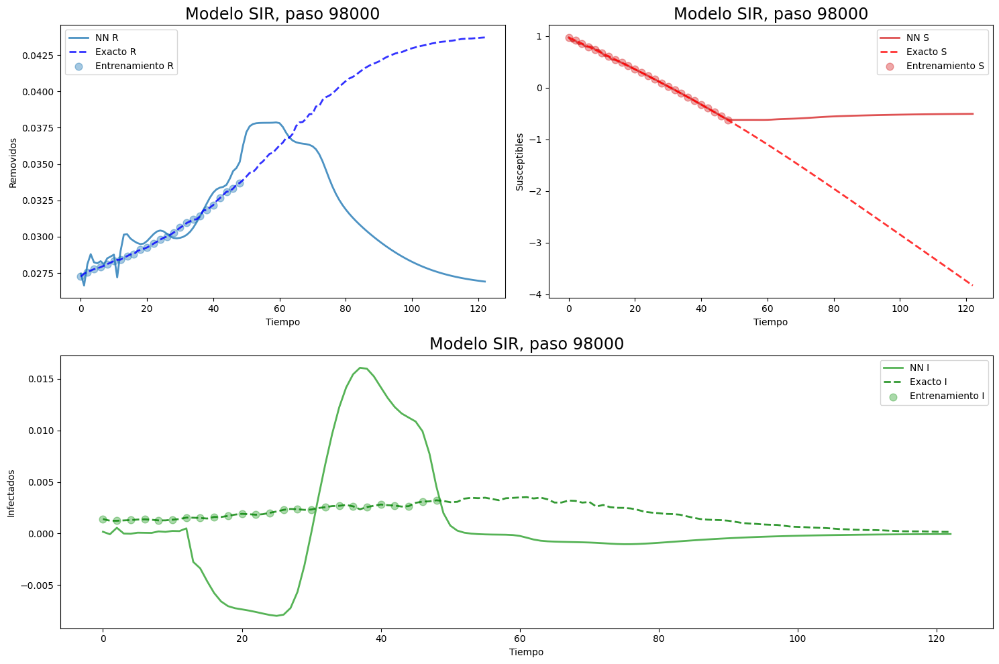

step = 98000 , loss1 = 2.2313852e-05 , loss2 = 0.00020446954 , loss = 0.00022678339 , mse = 0.7397821 , beta = -3.7057285 , gamma = 0.34969434
step = 99000 , loss1 = 2.0009482e-05 , loss2 = 0.00018114666 , loss = 0.00020115614 , mse = 0.7541363 , beta = -3.8359494 , gamma = 0.40934592
step = 100000 , loss1 = 2.106357e-05 , loss2 = 0.000186858 , loss = 0.00020792158 , mse = 0.7571247 , beta = -3.6501122 , gamma = 0.43519968
step = 101000 , loss1 = 2.2788216e-05 , loss2 = 0.00018727424 , loss = 0.00021006246 , mse = 0.7841008 , beta = -3.834555 , gamma = 0.44940758
step = 102000 , loss1 = 3.640902e-05 , loss2 = 0.00020787712 , loss = 0.00024428614 , mse = 0.7961893 , beta = -3.9181066 , gamma = 0.43031195
step = 103000 , loss1 = 1.98328e-05 , loss2 = 0.00019345208 , loss = 0.00021328489 , mse = 0.76086015 , beta = -3.9716687 , gamma = 0.40919587
step = 104000 , loss1 = 0.0002032838 , loss2 = 0.00029180228 , loss = 0.0004950861 , mse = 0.82736427 , beta = -4.082441 , gamma = 0.40349382


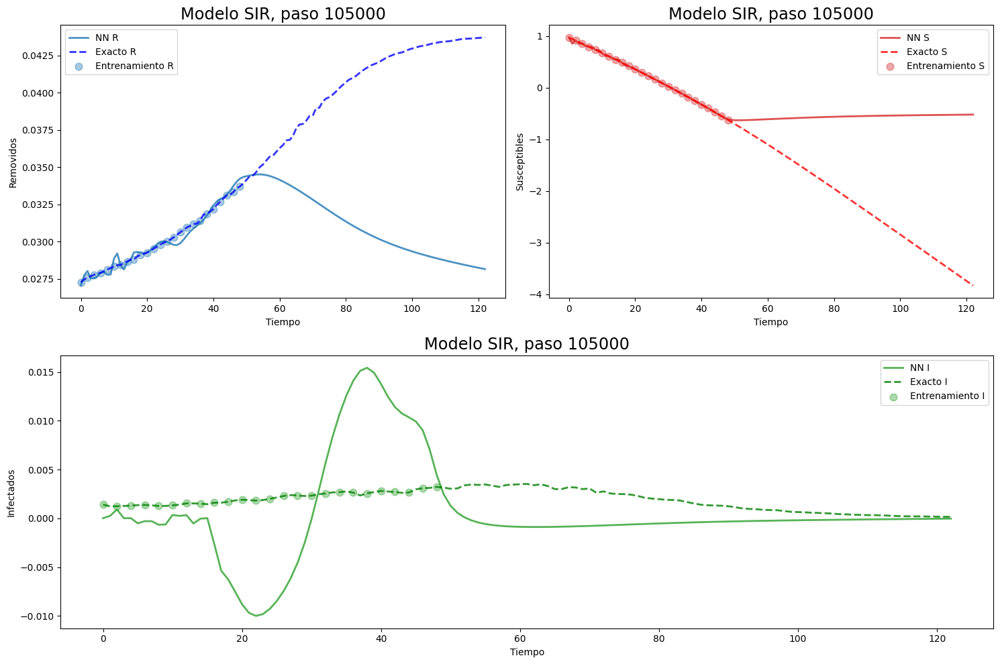

step = 105000 , loss1 = 2.0337013e-05 , loss2 = 0.00019422996 , loss = 0.00021456697 , mse = 0.7323644 , beta = -3.6631997 , gamma = 0.16891558


In [21]:
x_data = Alem_t_train
y_data = Alem_data_train
x = Alem_t
y = Alem_data

# ......................
N = 1.0
torch.manual_seed(123)
modelD = FCND(1, 3, 42, 4)

optimizer = torch.optim.Adam(modelD.parameters(),lr=3e-3)

steps = 105000
print_steps = 500
n_prints = steps // print_steps

Alem_loss1_history = np.zeros(n_prints)
Alem_loss2_history = np.zeros(n_prints)
Alem_loss_history = np.zeros(n_prints)
Alem_mse_history = np.zeros(n_prints)
Alem_beta_history = np.zeros(n_prints)
Alem_gamma_history = np.zeros(n_prints)

x_physics = torch.linspace(0.,Alem['t'].max(),90).view(-1,1).requires_grad_(True)

for i in range(steps):
    #lim= np.minimum(200*i/74000.,200)
    #x_physics = torch.linspace(0.,lim,90).view(-1,1).requires_grad_(True)#
    optimizer.zero_grad()
    
    # compute the "data loss" ..................................................
    yh = modelD(x_data)
    loss1 = 1*torch.mean((yh-y_data)**2)
    
    # compute the "physics loss" with enforcing the initial data ..............
    yhp = modelD(x_physics)
    yhp1= yhp[:,0].view(-1,1)
    yhp2= yhp[:,1].view(-1,1) 
    yhp3= yhp[:,2].view(-1,1)
    
    # compute first and second derivatives by automatic differentiation ....................
    dx1 = torch.autograd.grad(yhp1, x_physics, torch.ones_like(yhp1), create_graph=True)[0]
    dx2 = torch.autograd.grad(yhp2, x_physics, torch.ones_like(yhp2), create_graph=True)[0]
    dx3 = torch.autograd.grad(yhp3, x_physics, torch.ones_like(yhp3), create_graph=True)[0]
    #! aqui quede
    # computes the residual .............................................
    physics2 = (dx1 + (modelD.beta/N)*yhp1*yhp2)                
    physics1 = (dx2 - (modelD.beta/N)*yhp1*yhp2 + modelD.gamma*yhp2)
    physics3 = (dx3 - modelD.gamma*yhp2)
    loss2 = 1*torch.mean((physics1)**2) + 1*torch.mean((physics2)**2) + 1*torch.mean((physics3)**2)
    
    # backpropagate the total loss ...............................................
    loss = loss1 + loss2  # add two loss terms together .....................
    loss.backward()
    optimizer.step()    
        
    # plot the result as training progresses ...............................
    
    if (i+1) % print_steps == 0: 
        i_print = i // print_steps
        Alem_loss1_history[i_print] = loss1.detach().numpy()
        Alem_loss2_history[i_print] = loss2.detach().numpy()
        Alem_loss_history[i_print] = loss.detach().numpy()
        
        yh = modelD(x).detach()
        xp = x_physics.detach()
        
        yhpp=modelD(x)

        mse=torch.mean((yhpp-y)**2)   # compute mean square error using exact solution .....
        Alem_mse_history[i_print] = mse.detach().numpy()

        Alem_beta_history[i_print] = modelD.beta.detach().numpy()[0]
        Alem_gamma_history[i_print] = modelD.gamma.detach().numpy()[0]

        if (i+1) == 500: plot_result_al(i,x,y,x_data,y_data,yh,xp)
        if (i+1) % 1000 == 0 and (i+1) < 5000: plot_result_al(i,x,y,x_data,y_data,yh,xp)
        if (i+1) % 7000 == 0: plot_result_al(i,x,y,x_data,y_data,yh,xp)
        else: plt.close("all")
    if (i+1) % 1000 == 0: print('step =', i+1, ', loss1 =', loss1.detach().numpy(), ', loss2 =', loss2.detach().numpy(), ', loss =', loss.detach().numpy(),
                                ', mse =', mse.detach().numpy(), ', beta =', modelD.beta.detach().numpy()[0], ', gamma =', modelD.gamma.detach().numpy()[0])
    

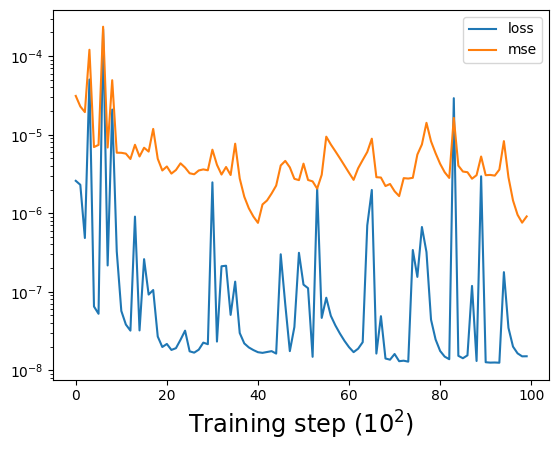

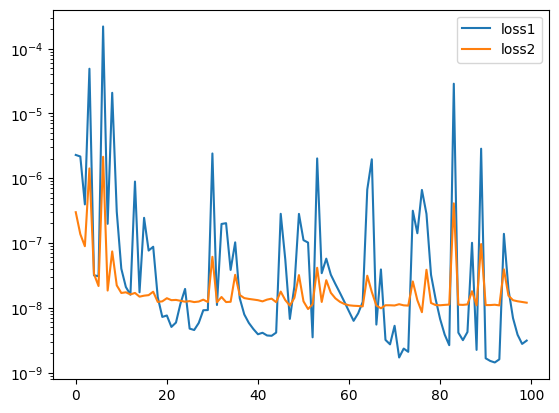

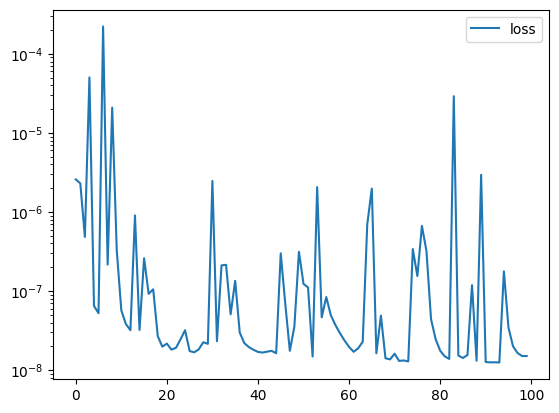

In [12]:
fig33 = plt.figure(33)
plt.plot(loss_history, label="loss")
plt.plot(mse_history, label="mse")
plt.xlabel('Training step ($10^2$)',fontsize="xx-large")
plt.yscale('log')
plt.legend()

fig50 = plt.figure(50)
plt.plot(loss1_history, label="loss1")
plt.plot(loss2_history, label="loss2")
plt.yscale('log')
plt.legend()

fig51 = plt.figure(51)
plt.plot(loss_history, label="loss")
plt.yscale('log')
plt.legend()

# NN clasica

1000 2.1914396711508743e-05
2000 0.0001016613605315797
3000 1.9002218323294073e-06
4000 1.5501011148444377e-05
5000 1.3226634109742008e-05


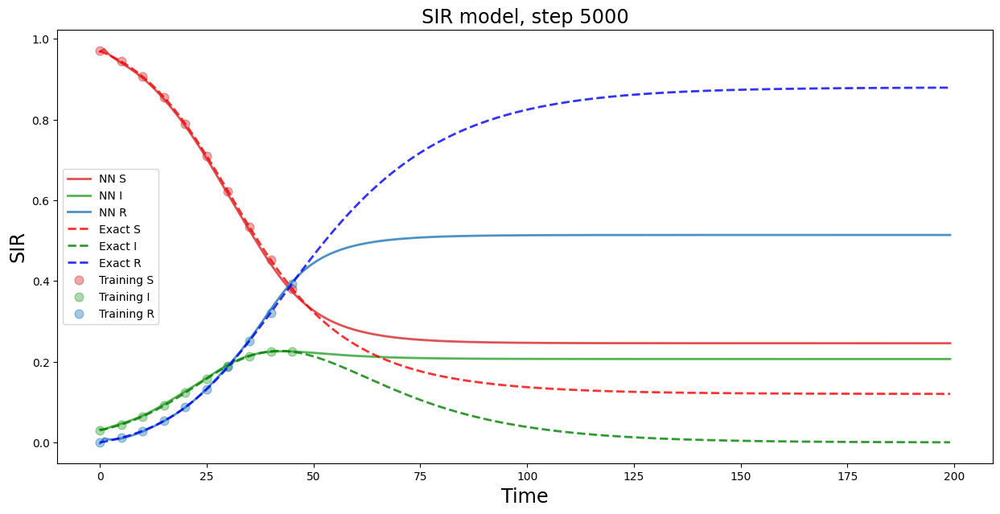

6000 1.565329876029864e-05
7000 3.360079745107214e-06
8000 0.003398131811991334
9000 0.00014920093235559762
10000 7.535233947919551e-08


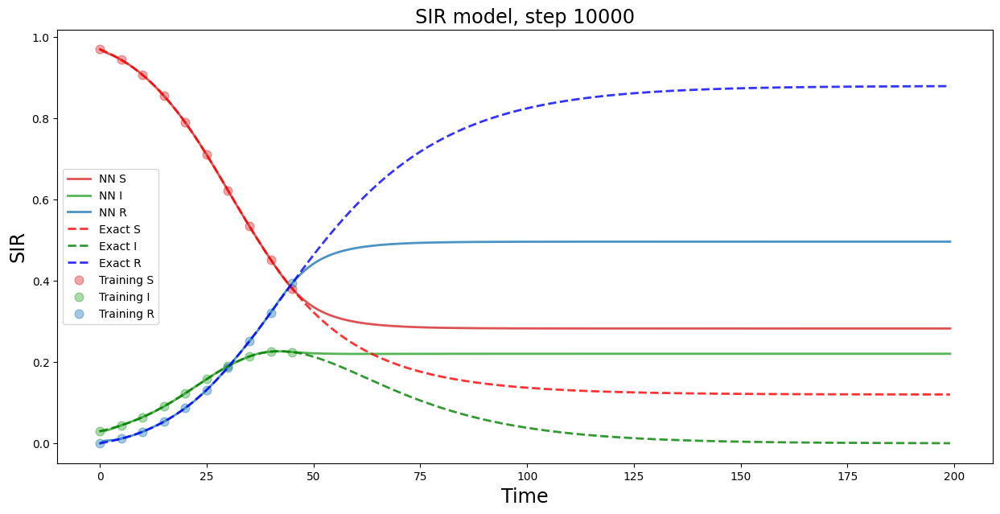

11000 2.8604436010937206e-06
12000 6.805449083913118e-05
13000 1.987437343586862e-07
14000 3.173069126205519e-05
15000 5.3189010941423476e-05


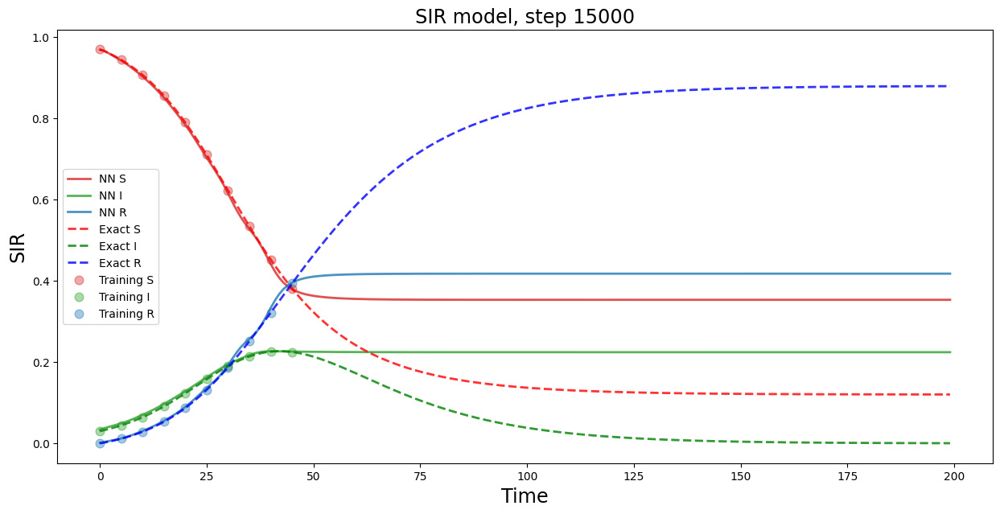

In [13]:
x_data = sim_t_train
y_data = sim_data_train
x = sim_t
y = sim_data

# We train a standard neural network to fit training data (one must choos lr and number of
# layers, number of neurons per layer) ....................................................
torch.manual_seed(127)
model = FCN(1,3,32,3)
optimizer = torch.optim.Adam(model.parameters(),lr=1e-2)
files = []
for i in range(15000):
    optimizer.zero_grad()
    yh = model(x_data)
    loss = torch.mean((yh-y_data)**2)# use mean squared error to define Loss on data ......
    loss.backward()
    optimizer.step()
        
    # plot the result as training progresses ..............................................
    if (i+1) % 1000 == 0: print(i+1,loss.item())
    if (i+1) % 100 == 0:         
        yh = model(x).detach()       
        #plot_result(i,x,y,x_data,y_data,yh)   
        if (i+1) % 5000 == 0: plot_result(i,x,y,x_data,y_data,yh) 
        else: plt.close("all")
            